# **Focal Mechanism Solution For Kahramanmaras Earthquake 7.8**

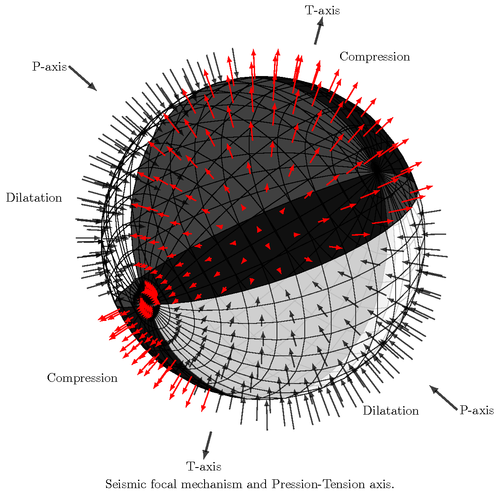

### Table of Contents
<ul>
<li><a href="#lib">Python Libraries<a/></li>
<li><a href="#aim">Aim<a/></li>
<li><a href="#data">Data<a/></li>
<li><a href="#waveform">Waveform<a/></li>
<li><a href="#map">Geographic Map and Polarity<a/></li>
<li><a href="#takeoff">Take-off Angle, Trend and Plunge<a/></li>
<li><a href="#stereonet">Stereographic Projection<a/></li>
<li><a href="#beachball">Beachball<a/></li>
<li><a href="#discussion">Discussion<a/></li>
<li><a href="#conclusion">Conclusion<a/></li>
<li><a href="#references">References<a/></li>
<ul>

<a id="lib"></a>
### Necessary Libraries


In [1]:
# Data Processing 
import pandas as pd
import numpy as np
import math

# Lambert-Schmidt projection 
import mplstereonet

# Seismic waveform
import obspy

# Visualisation
import matplotlib.pyplot as plt
import folium

<a id="aim"></a>
### Aim

> This research aims to analyze the Kahramanmaras earthquake source mechanism, accounting for its structural focal mechanism, fault orientation, and type of faulting responsible for the earthquake, highlighting the societal and economic implications for the region.

<a id="data"></a>
### Data

- A publicly available waveform dataset for the Kahramanmaras earthquake was obtained from the Incorporated Research Institutions for Seismology (IRIS) (IRIS, 2023). 
- The dataset contains the recordings of the Kahramanmaras earthquake event from 149 seismic earthquake stations. This number of utilized earthquake stations not only satisfy but significantly surpasses the minimum of 10 seismic stations recommended by Cronin (2010). 

In [2]:
# loading the downloaded miniseed dataset 
waveform_dt = obspy.read("2023-02-06-mww78-turkey.miniseed")

# loading the excel spreadsheet containing information about the respective stations
stations_df = pd.read_excel("stations.xlsx")

In [3]:
print(waveform_dt)

699 Trace(s) in Stream:

AU.MCQ.00.BHE | 2023-02-06T01:29:05.000000Z - 2023-02-06T01:53:05.000000Z | 40.0 Hz, 57601 samples
...
(697 other traces)
...
CI.PASC.10.BHZ | 2023-02-06T01:26:40.994500Z - 2023-02-06T01:48:33.994500Z | 40.0 Hz, 52521 samples

[Use "print(Stream.__str__(extended=True))" to print all Traces]


In [4]:
# Displays the first five rows of the metadata
stations_df.head()

,Station,Source,Net,Latitude,Longitude,Distance,Azimuth,Elevation,Station Name,Nature of First Arrival
0,AAK,IRISDMC,II,42.6375,74.4942,28.995337,67.415453,1633.1,"Ala Archa, Kyrgyzstan",C
1,ABPO,IRISDMC,II,-19.0180,47.2290,57.060447,168.483847,1528.0,"Ambohimpanompo, Madagascar",D
2,ADK,IRISDMC,IU,51.8823,-176.6842,86.155801,20.078784,130.0,"Adak, Aleutian Islands, Alaska",NIL
3,AFI,IRISDMC,IU,-13.9085,-171.7827,145.356338,55.356268,706.0,"Afiamalu, Samoa",NIL
4,ALE,IRISDMC,II,82.5033,-62.3500,54.347936,-9.115228,60.0,"Alert, NU, Canada",NIL


In [5]:
#summary statistics of the metadata
stations_df.describe()

,Latitude,Longitude,Distance,Azimuth,Elevation
count,149.000000,149.000000,149.000000,149.000000,149.000000
mean,17.289965,9.360553,80.290219,8.871225,577.326846
std,34.841980,105.582448,36.648324,83.779432,713.872139
min,-89.928900,-177.929000,4.231929,-169.824083,0.000000
25%,-5.827400,-79.837300,55.274450,-51.770790,110.000000
50%,23.522500,17.583800,81.982461,13.927230,300.000000
75%,42.506400,109.494400,106.237429,69.795839,706.000000
max,82.503300,179.196600,163.623194,179.914778,3660.000000


> **NOTE:** The nature of first arrival column added to the loaded stations excel sheet was not provided by USGS(2023) alongside the other metadata contained in the sheet but was manually determined based on the waveform plot shown in the next section

<a id="waveform"></a>
### Waveform and P-Wave First Arrivals

6 Trace(s) in Stream:
II.AAK.00.BH1 | 2023-02-06T01:18:33.019538Z - 2023-02-06T01:33:24.969538Z | 20.0 Hz, 17840 samples
II.AAK.00.BH2 | 2023-02-06T01:18:33.019538Z - 2023-02-06T01:33:24.969538Z | 20.0 Hz, 17840 samples
II.AAK.00.BHZ | 2023-02-06T01:18:33.019538Z - 2023-02-06T01:33:24.969538Z | 20.0 Hz, 17840 samples
II.AAK.10.BH1 | 2023-02-06T01:18:33.019538Z - 2023-02-06T01:33:24.994538Z | 40.0 Hz, 35680 samples
II.AAK.10.BH2 | 2023-02-06T01:18:33.019538Z - 2023-02-06T01:33:24.994538Z | 40.0 Hz, 35680 samples
II.AAK.10.BHZ | 2023-02-06T01:18:33.019538Z - 2023-02-06T01:33:24.994538Z | 40.0 Hz, 35680 samples


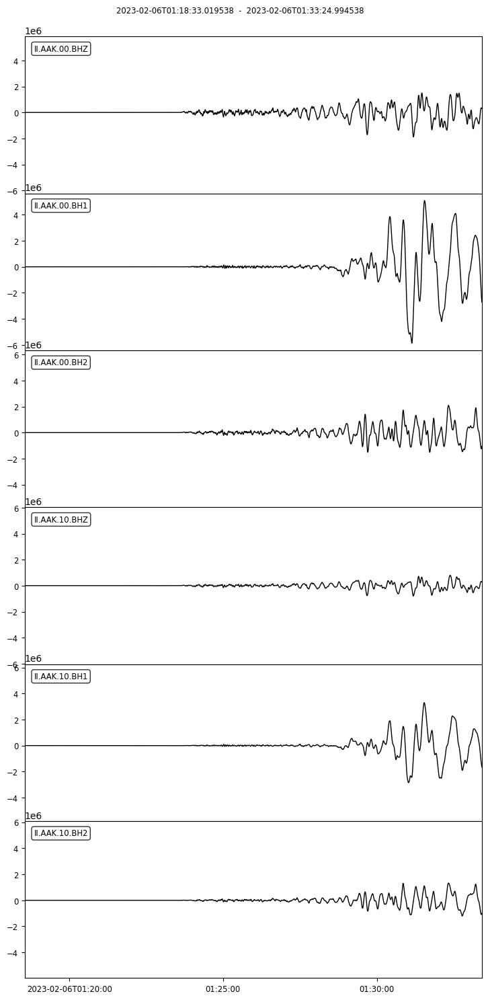

6 Trace(s) in Stream:
II.ABPO.00.BH1 | 2023-02-06T01:22:20.019538Z - 2023-02-06T01:40:14.994538Z | 40.0 Hz, 43000 samples
II.ABPO.00.BH2 | 2023-02-06T01:22:20.019538Z - 2023-02-06T01:40:14.994538Z | 40.0 Hz, 43000 samples
II.ABPO.00.BHZ | 2023-02-06T01:22:20.019538Z - 2023-02-06T01:40:14.994538Z | 40.0 Hz, 43000 samples
II.ABPO.10.BH1 | 2023-02-06T01:22:20.019538Z - 2023-02-06T01:40:14.994538Z | 40.0 Hz, 43000 samples
II.ABPO.10.BH2 | 2023-02-06T01:22:20.019538Z - 2023-02-06T01:40:14.994538Z | 40.0 Hz, 43000 samples
II.ABPO.10.BHZ | 2023-02-06T01:22:20.019538Z - 2023-02-06T01:40:14.994538Z | 40.0 Hz, 43000 samples


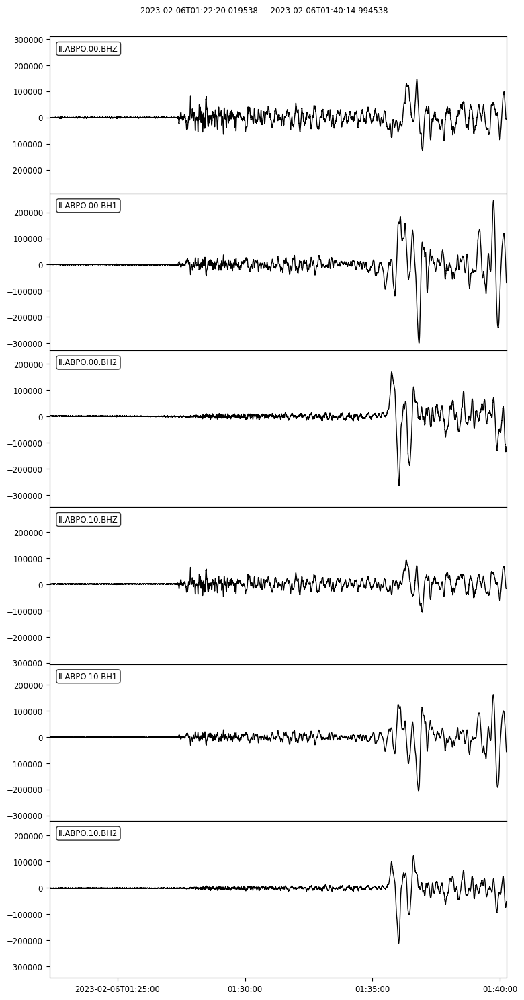

9 Trace(s) in Stream:
IU.ADK.00.BH1 | 2023-02-06T01:25:15.019538Z - 2023-02-06T01:45:49.994538Z | 40.0 Hz, 49400 samples
IU.ADK.00.BH2 | 2023-02-06T01:25:15.019538Z - 2023-02-06T01:45:49.994538Z | 40.0 Hz, 49400 samples
IU.ADK.00.BHZ | 2023-02-06T01:25:15.019538Z - 2023-02-06T01:45:49.994538Z | 40.0 Hz, 49400 samples
IU.ADK.10.BH1 | 2023-02-06T01:25:15.019538Z - 2023-02-06T01:45:49.994538Z | 40.0 Hz, 49400 samples
IU.ADK.10.BH2 | 2023-02-06T01:25:15.019538Z - 2023-02-06T01:45:49.994538Z | 40.0 Hz, 49400 samples
IU.ADK.10.BHZ | 2023-02-06T01:25:15.019538Z - 2023-02-06T01:45:49.994538Z | 40.0 Hz, 49400 samples
IU.ADK.60.BH1 | 2023-02-06T01:25:15.019538Z - 2023-02-06T01:45:49.969538Z | 20.0 Hz, 24700 samples
IU.ADK.60.BH2 | 2023-02-06T01:25:15.019536Z - 2023-02-06T01:45:49.969536Z | 20.0 Hz, 24700 samples
IU.ADK.60.BHZ | 2023-02-06T01:25:15.019538Z - 2023-02-06T01:45:49.969538Z | 20.0 Hz, 24700 samples


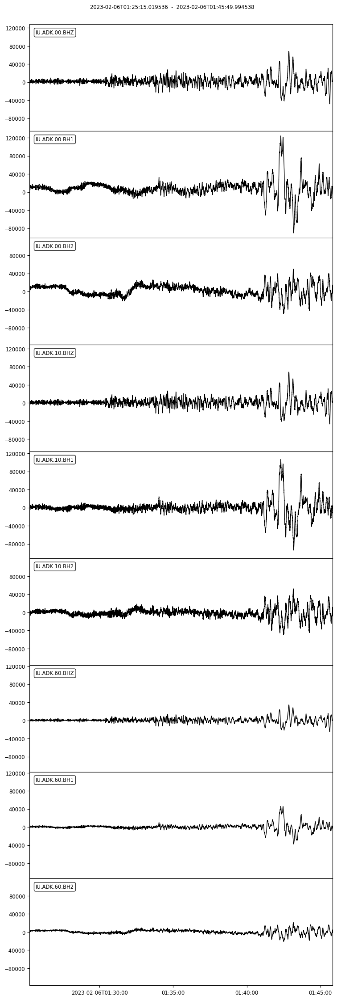

0 Trace(s) in Stream:

No waveform data found for station AFI 
 
 

1 Trace(s) in Stream:
II.ALE.00.BHZ | 2023-02-06T01:22:00.019536Z - 2023-02-06T01:39:38.969536Z | 20.0 Hz, 21180 samples


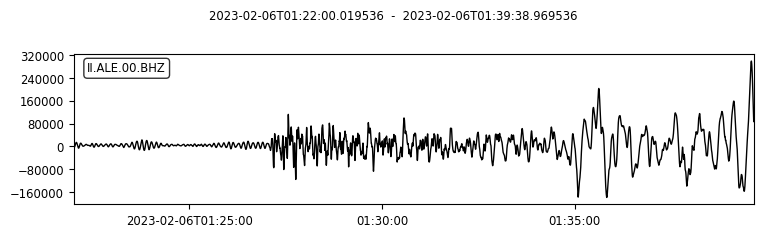

6 Trace(s) in Stream:
IU.ANMO.00.BH1 | 2023-02-06T01:26:20.019538Z - 2023-02-06T01:47:54.994538Z | 40.0 Hz, 51800 samples
IU.ANMO.00.BH2 | 2023-02-06T01:26:20.019538Z - 2023-02-06T01:47:54.994538Z | 40.0 Hz, 51800 samples
IU.ANMO.00.BHZ | 2023-02-06T01:26:20.019538Z - 2023-02-06T01:47:54.994538Z | 40.0 Hz, 51800 samples
IU.ANMO.10.BH1 | 2023-02-06T01:26:20.019538Z - 2023-02-06T01:47:54.994538Z | 40.0 Hz, 51800 samples
IU.ANMO.10.BH2 | 2023-02-06T01:26:20.019536Z - 2023-02-06T01:47:54.994536Z | 40.0 Hz, 51800 samples
IU.ANMO.10.BHZ | 2023-02-06T01:26:20.019538Z - 2023-02-06T01:47:54.994538Z | 40.0 Hz, 51800 samples


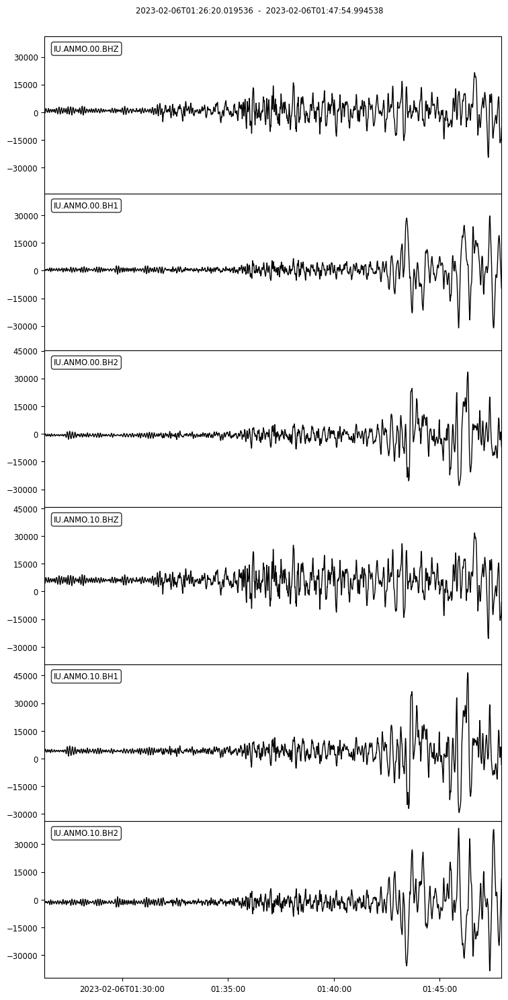

6 Trace(s) in Stream:
IU.ANTO.00.BH1 | 2023-02-06T01:13:38.019538Z - 2023-02-06T01:24:27.994538Z | 40.0 Hz, 26000 samples
IU.ANTO.00.BH2 | 2023-02-06T01:13:38.019538Z - 2023-02-06T01:24:27.994538Z | 40.0 Hz, 26000 samples
IU.ANTO.00.BHZ | 2023-02-06T01:13:38.019538Z - 2023-02-06T01:24:27.994538Z | 40.0 Hz, 26000 samples
IU.ANTO.10.BH1 | 2023-02-06T01:13:38.019536Z - 2023-02-06T01:24:27.994536Z | 40.0 Hz, 26000 samples
IU.ANTO.10.BH2 | 2023-02-06T01:13:38.019538Z - 2023-02-06T01:24:27.994538Z | 40.0 Hz, 26000 samples
IU.ANTO.10.BHZ | 2023-02-06T01:13:38.019536Z - 2023-02-06T01:24:27.994536Z | 40.0 Hz, 26000 samples


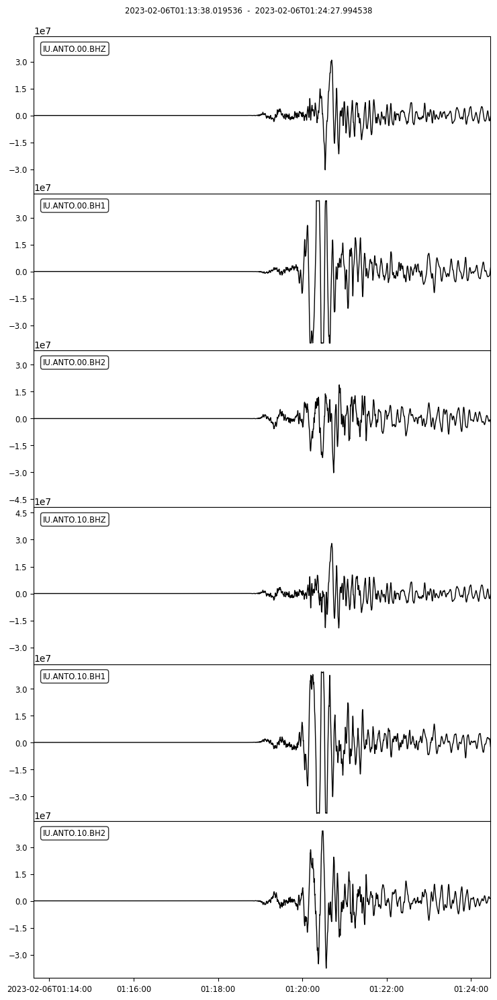

3 Trace(s) in Stream:
CU.ANWB.00.BH1 | 2023-02-06T01:25:15.019536Z - 2023-02-06T01:45:49.994536Z | 40.0 Hz, 49400 samples
CU.ANWB.00.BH2 | 2023-02-06T01:25:15.019536Z - 2023-02-06T01:45:49.994536Z | 40.0 Hz, 49400 samples
CU.ANWB.00.BHZ | 2023-02-06T01:25:15.019538Z - 2023-02-06T01:45:49.994538Z | 40.0 Hz, 49400 samples


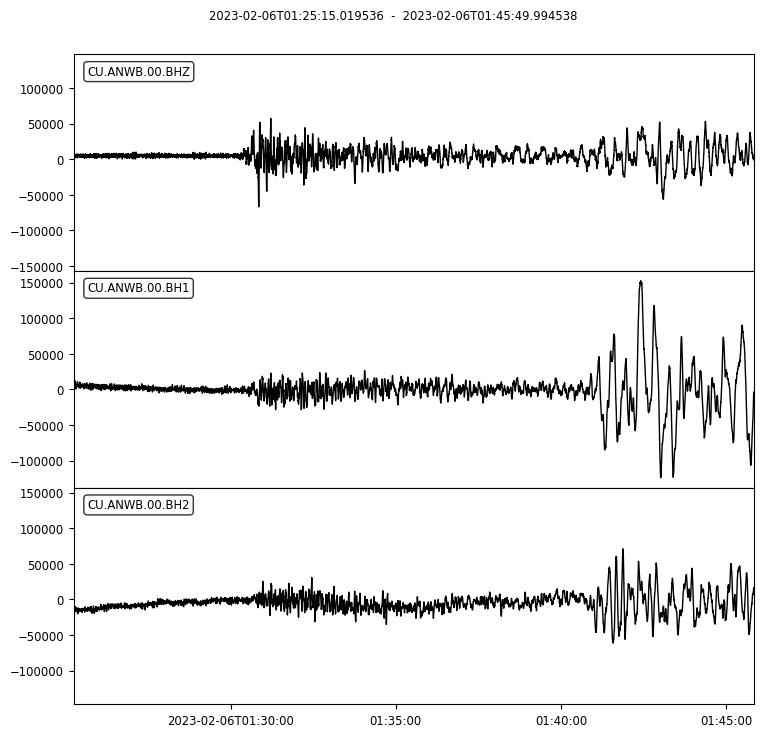

6 Trace(s) in Stream:
II.ARTI.00.BH1 | 2023-02-06T01:17:47.019538Z - 2023-02-06T01:32:04.969538Z | 20.0 Hz, 17160 samples
II.ARTI.00.BH2 | 2023-02-06T01:17:47.019538Z - 2023-02-06T01:32:04.969538Z | 20.0 Hz, 17160 samples
II.ARTI.00.BHZ | 2023-02-06T01:17:47.019538Z - 2023-02-06T01:32:04.969538Z | 20.0 Hz, 17160 samples
II.ARTI.10.BH1 | 2023-02-06T01:17:47.019538Z - 2023-02-06T01:32:04.994538Z | 40.0 Hz, 34320 samples
II.ARTI.10.BH2 | 2023-02-06T01:17:47.019538Z - 2023-02-06T01:32:04.994538Z | 40.0 Hz, 34320 samples
II.ARTI.10.BHZ | 2023-02-06T01:17:47.019538Z - 2023-02-06T01:32:04.994538Z | 40.0 Hz, 34320 samples


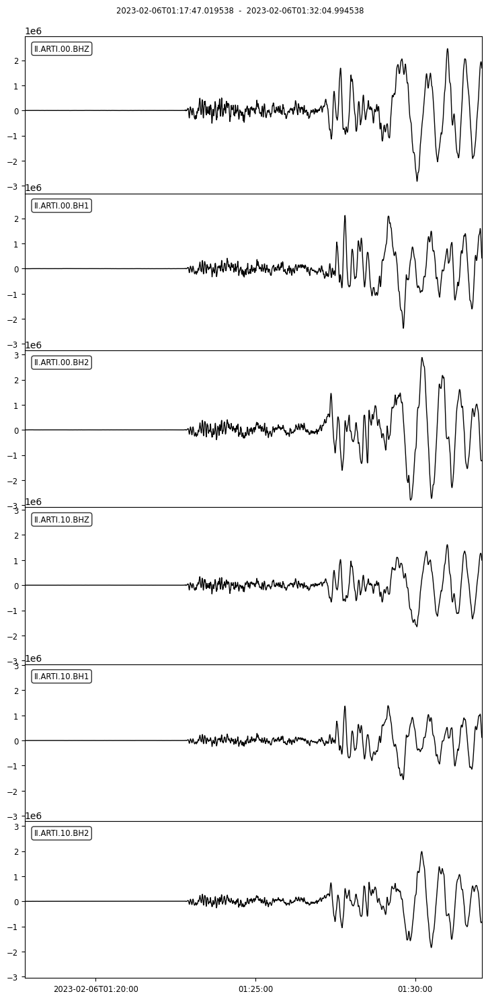

6 Trace(s) in Stream:
II.ASCN.00.BH1 | 2023-02-06T01:23:19.019536Z - 2023-02-06T01:42:06.994536Z | 40.0 Hz, 45120 samples
II.ASCN.00.BH2 | 2023-02-06T01:23:19.019536Z - 2023-02-06T01:42:06.994536Z | 40.0 Hz, 45120 samples
II.ASCN.00.BHZ | 2023-02-06T01:23:19.019536Z - 2023-02-06T01:42:06.994536Z | 40.0 Hz, 45120 samples
II.ASCN.10.BH1 | 2023-02-06T01:23:19.019536Z - 2023-02-06T01:42:06.994536Z | 40.0 Hz, 45120 samples
II.ASCN.10.BH2 | 2023-02-06T01:23:19.019536Z - 2023-02-06T01:42:06.994536Z | 40.0 Hz, 45120 samples
II.ASCN.10.BHZ | 2023-02-06T01:23:19.019536Z - 2023-02-06T01:42:06.994536Z | 40.0 Hz, 45120 samples


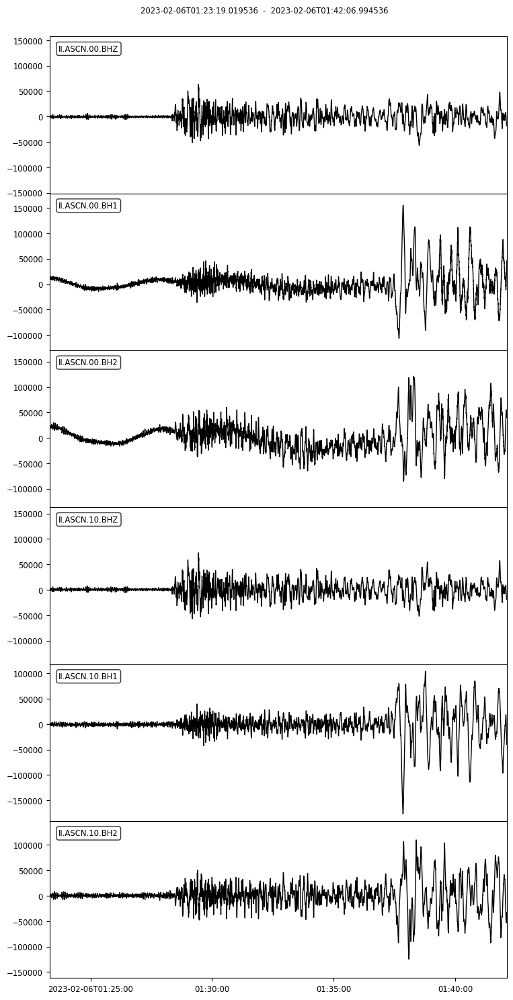

3 Trace(s) in Stream:
CU.BBGH.00.BH1 | 2023-02-06T01:25:20.024998Z - 2023-02-06T01:45:59.999998Z | 40.0 Hz, 49600 samples
CU.BBGH.00.BH2 | 2023-02-06T01:25:20.000000Z - 2023-02-06T01:46:00.000000Z | 40.0 Hz, 49601 samples
CU.BBGH.00.BHZ | 2023-02-06T01:25:20.000000Z - 2023-02-06T01:46:00.000000Z | 40.0 Hz, 49601 samples


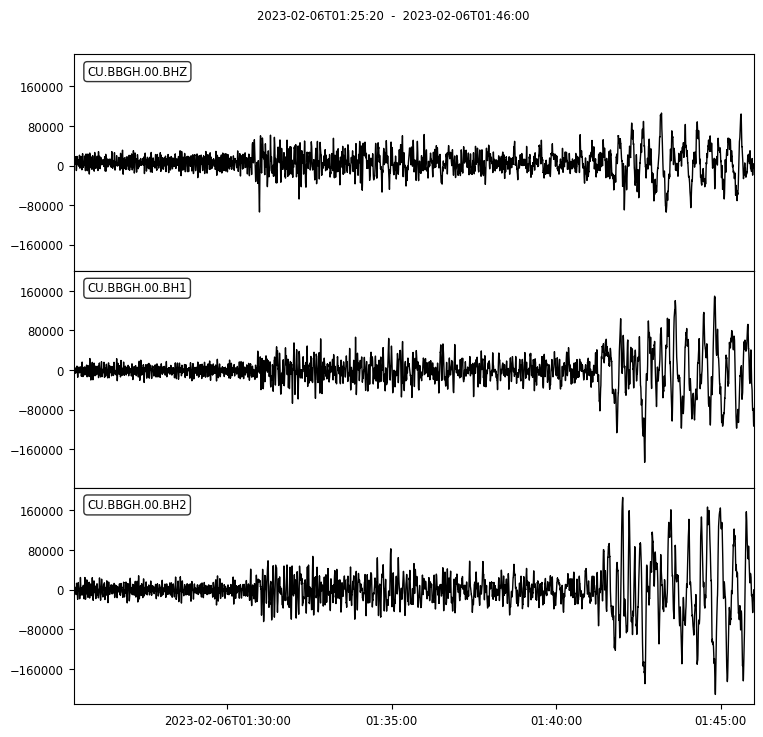

6 Trace(s) in Stream:
IU.BBSR.00.BH1 | 2023-02-06T01:24:39.019538Z - 2023-02-06T01:44:38.994538Z | 40.0 Hz, 48000 samples
IU.BBSR.00.BH2 | 2023-02-06T01:24:39.019538Z - 2023-02-06T01:44:38.994538Z | 40.0 Hz, 48000 samples
IU.BBSR.00.BHZ | 2023-02-06T01:24:39.019538Z - 2023-02-06T01:44:38.994538Z | 40.0 Hz, 48000 samples
IU.BBSR.10.BH1 | 2023-02-06T01:24:39.019538Z - 2023-02-06T01:44:38.994538Z | 40.0 Hz, 48000 samples
IU.BBSR.10.BH2 | 2023-02-06T01:24:39.019538Z - 2023-02-06T01:44:38.994538Z | 40.0 Hz, 48000 samples
IU.BBSR.10.BHZ | 2023-02-06T01:24:39.019538Z - 2023-02-06T01:44:38.994538Z | 40.0 Hz, 48000 samples


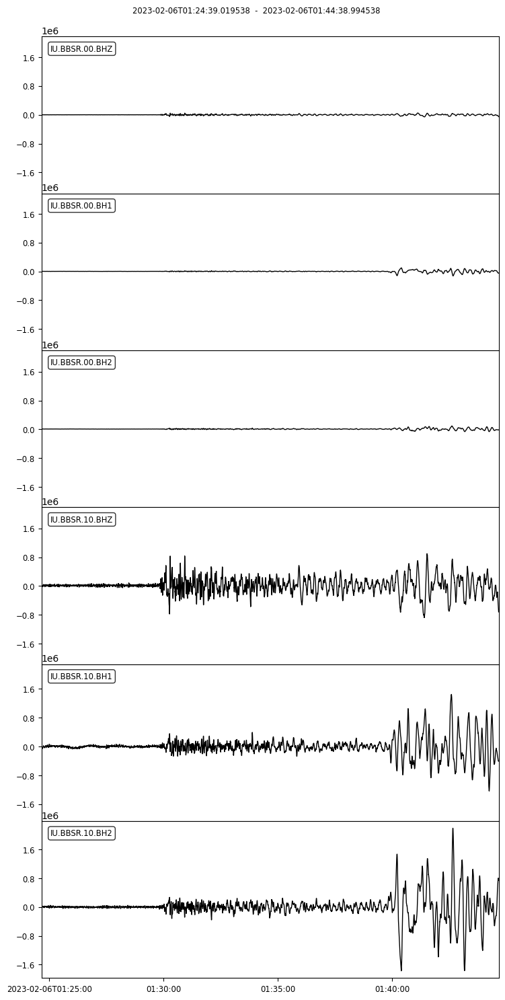

3 Trace(s) in Stream:
CU.BCIP.00.BH1 | 2023-02-06T01:26:41.019538Z - 2023-02-06T01:48:34.994538Z | 40.0 Hz, 52560 samples
CU.BCIP.00.BH2 | 2023-02-06T01:26:41.019538Z - 2023-02-06T01:48:34.994538Z | 40.0 Hz, 52560 samples
CU.BCIP.00.BHZ | 2023-02-06T01:26:41.019538Z - 2023-02-06T01:48:34.994538Z | 40.0 Hz, 52560 samples


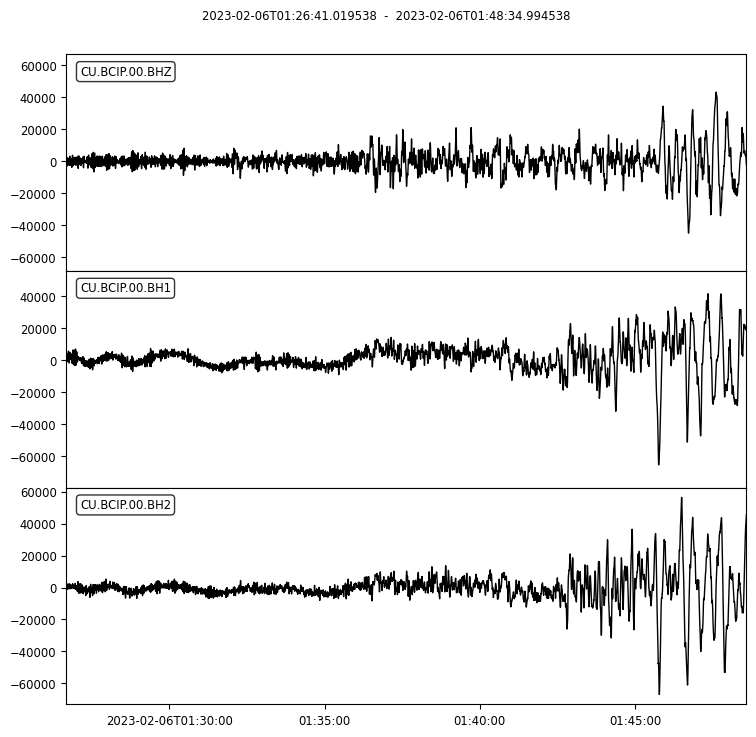

6 Trace(s) in Stream:
II.BFO.00.BHE | 2023-02-06T01:17:44.019538Z - 2023-02-06T01:31:59.969538Z | 20.0 Hz, 17120 samples
II.BFO.00.BHN | 2023-02-06T01:17:44.019538Z - 2023-02-06T01:31:59.969538Z | 20.0 Hz, 17120 samples
II.BFO.00.BHZ | 2023-02-06T01:17:44.019538Z - 2023-02-06T01:31:59.969538Z | 20.0 Hz, 17120 samples
II.BFO.10.BHE | 2023-02-06T01:17:44.019538Z - 2023-02-06T01:31:59.994538Z | 40.0 Hz, 34240 samples
II.BFO.10.BHN | 2023-02-06T01:17:44.019538Z - 2023-02-06T01:31:59.994538Z | 40.0 Hz, 34240 samples
II.BFO.10.BHZ | 2023-02-06T01:17:44.019538Z - 2023-02-06T01:31:59.994538Z | 40.0 Hz, 34240 samples


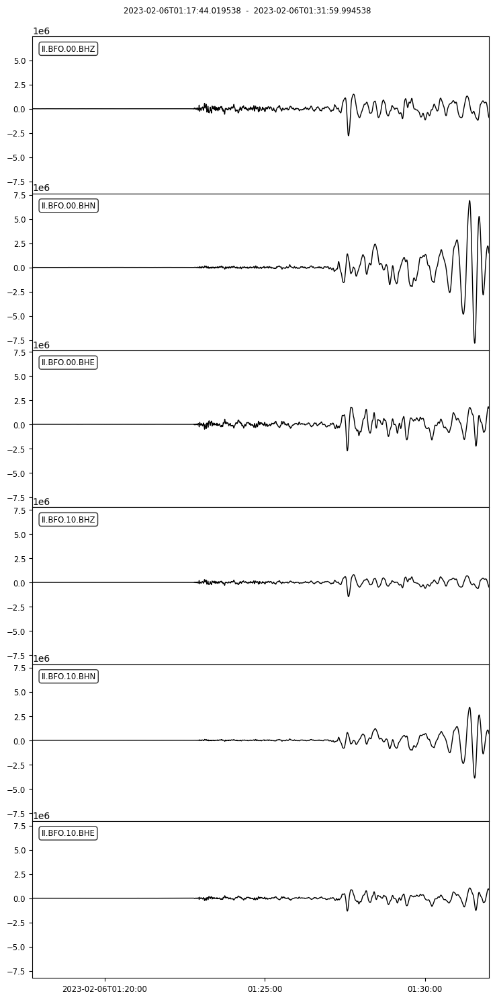

6 Trace(s) in Stream:
IU.BILL.00.BH1 | 2023-02-06T01:23:34.019536Z - 2023-02-06T01:42:34.994536Z | 40.0 Hz, 45640 samples
IU.BILL.00.BH2 | 2023-02-06T01:23:34.019536Z - 2023-02-06T01:42:34.994536Z | 40.0 Hz, 45640 samples
IU.BILL.00.BHZ | 2023-02-06T01:23:34.019536Z - 2023-02-06T01:42:34.994536Z | 40.0 Hz, 45640 samples
IU.BILL.10.BH1 | 2023-02-06T01:23:34.019538Z - 2023-02-06T01:42:34.994538Z | 40.0 Hz, 45640 samples
IU.BILL.10.BH2 | 2023-02-06T01:23:34.019538Z - 2023-02-06T01:42:34.994538Z | 40.0 Hz, 45640 samples
IU.BILL.10.BHZ | 2023-02-06T01:23:34.019539Z - 2023-02-06T01:42:34.994539Z | 40.0 Hz, 45640 samples


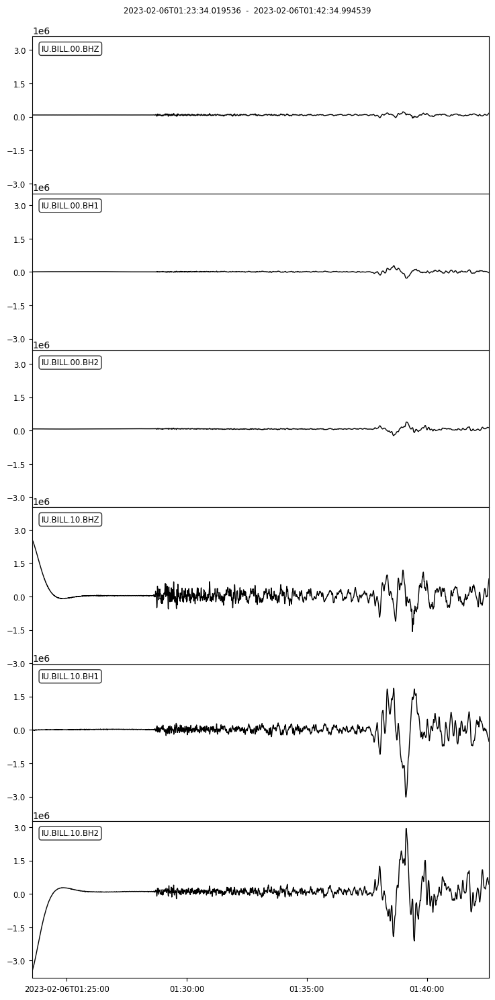

3 Trace(s) in Stream:
IC.BJT.00.BH1 | 2023-02-06T01:22:38.019538Z - 2023-02-06T01:40:49.969538Z | 20.0 Hz, 21840 samples
IC.BJT.00.BH2 | 2023-02-06T01:22:38.019538Z - 2023-02-06T01:40:49.969538Z | 20.0 Hz, 21840 samples
IC.BJT.00.BHZ | 2023-02-06T01:22:38.019538Z - 2023-02-06T01:40:49.969538Z | 20.0 Hz, 21840 samples


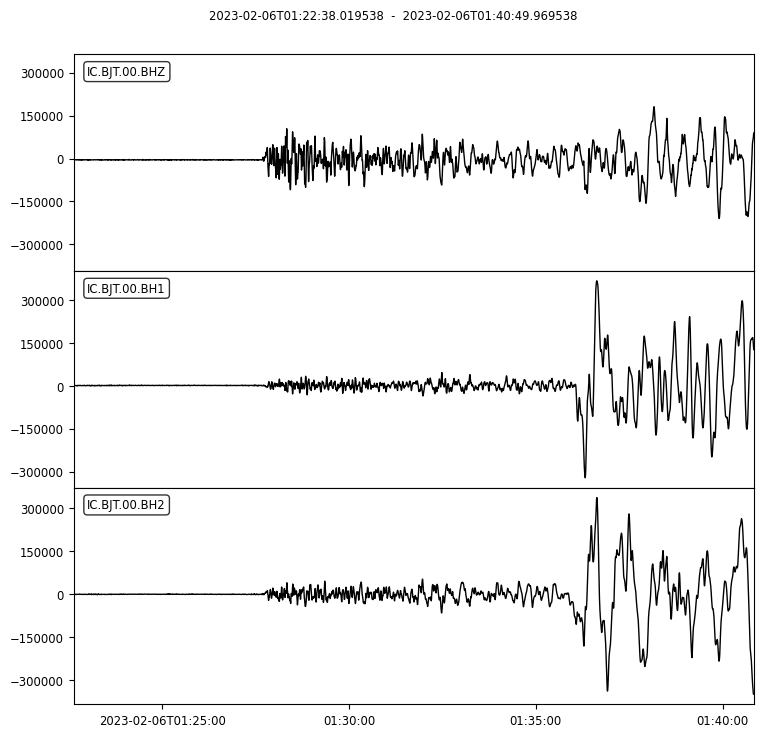

6 Trace(s) in Stream:
II.BORG.00.BH1 | 2023-02-06T01:20:37.019536Z - 2023-02-06T01:37:05.994536Z | 40.0 Hz, 39560 samples
II.BORG.00.BH2 | 2023-02-06T01:20:37.019536Z - 2023-02-06T01:37:05.994536Z | 40.0 Hz, 39560 samples
II.BORG.00.BHZ | 2023-02-06T01:20:37.019536Z - 2023-02-06T01:37:05.994536Z | 40.0 Hz, 39560 samples
II.BORG.10.BH1 | 2023-02-06T01:20:37.019538Z - 2023-02-06T01:37:05.994538Z | 40.0 Hz, 39560 samples
II.BORG.10.BH2 | 2023-02-06T01:20:37.019538Z - 2023-02-06T01:37:05.994538Z | 40.0 Hz, 39560 samples
II.BORG.10.BHZ | 2023-02-06T01:20:37.019538Z - 2023-02-06T01:37:05.994538Z | 40.0 Hz, 39560 samples


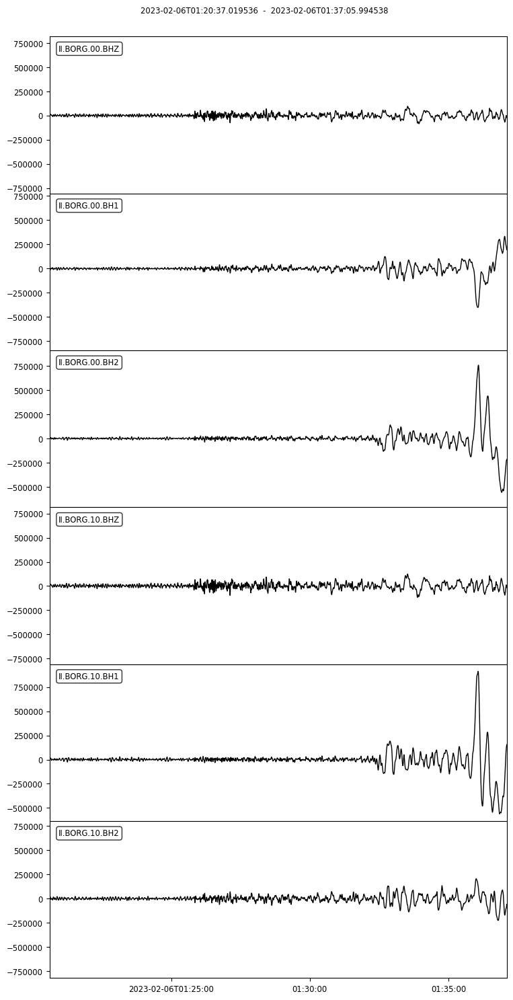

3 Trace(s) in Stream:
II.BORK.10.BH1 | 2023-02-06T01:18:24.019538Z - 2023-02-06T01:33:08.994538Z | 40.0 Hz, 35400 samples
II.BORK.10.BH2 | 2023-02-06T01:18:24.019538Z - 2023-02-06T01:33:08.994538Z | 40.0 Hz, 35400 samples
II.BORK.10.BHZ | 2023-02-06T01:18:24.019538Z - 2023-02-06T01:33:08.994538Z | 40.0 Hz, 35400 samples


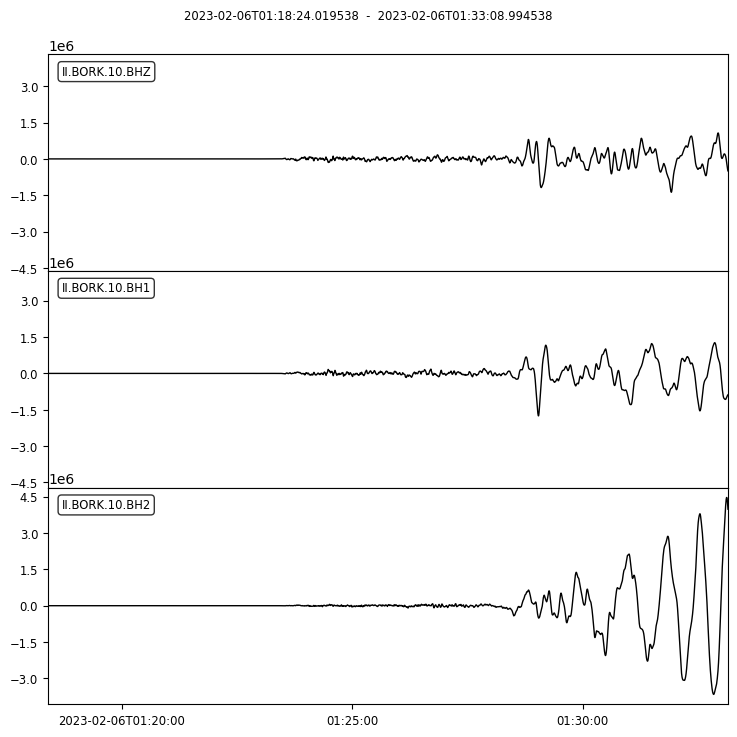

0 Trace(s) in Stream:

No waveform data found for station BTDF 
 
 

6 Trace(s) in Stream:
IU.CASY.00.BH1 | 2023-02-06T01:27:37.019538Z - 2023-02-06T01:50:18.969538Z | 20.0 Hz, 27240 samples
IU.CASY.00.BH2 | 2023-02-06T01:27:37.019538Z - 2023-02-06T01:50:18.969538Z | 20.0 Hz, 27240 samples
IU.CASY.00.BHZ | 2023-02-06T01:27:37.019538Z - 2023-02-06T01:50:18.969538Z | 20.0 Hz, 27240 samples
IU.CASY.10.BH1 | 2023-02-06T01:27:37.019536Z - 2023-02-06T01:50:18.994536Z | 40.0 Hz, 54480 samples
IU.CASY.10.BH2 | 2023-02-06T01:27:37.019536Z - 2023-02-06T01:50:18.994536Z | 40.0 Hz, 54480 samples
IU.CASY.10.BHZ | 2023-02-06T01:27:37.019536Z - 2023-02-06T01:50:18.994536Z | 40.0 Hz, 54480 samples


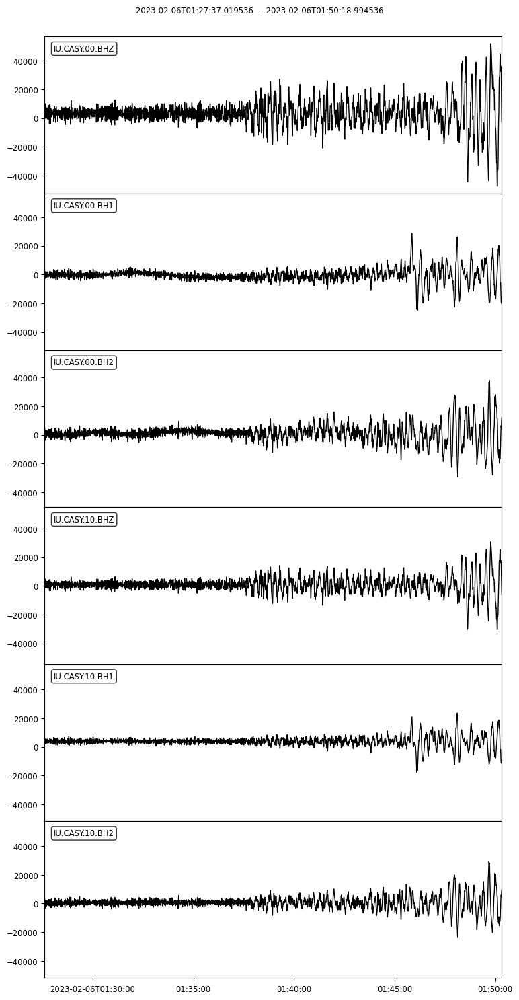

6 Trace(s) in Stream:
IU.CCM.00.BH1 | 2023-02-06T01:25:37.019536Z - 2023-02-06T01:46:33.994536Z | 40.0 Hz, 50280 samples
IU.CCM.00.BH2 | 2023-02-06T01:25:37.019536Z - 2023-02-06T01:46:33.994536Z | 40.0 Hz, 50280 samples
IU.CCM.00.BHZ | 2023-02-06T01:25:37.019538Z - 2023-02-06T01:46:33.994538Z | 40.0 Hz, 50280 samples
IU.CCM.10.BH1 | 2023-02-06T01:25:37.019541Z - 2023-02-06T01:46:33.994541Z | 40.0 Hz, 50280 samples
IU.CCM.10.BH2 | 2023-02-06T01:25:37.019539Z - 2023-02-06T01:46:33.994539Z | 40.0 Hz, 50280 samples
IU.CCM.10.BHZ | 2023-02-06T01:25:37.019536Z - 2023-02-06T01:46:33.994536Z | 40.0 Hz, 50280 samples


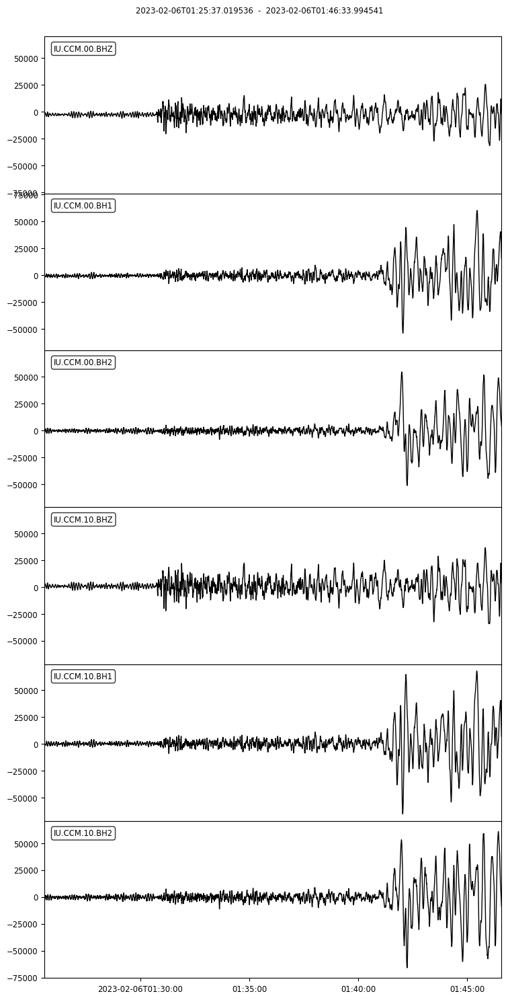

6 Trace(s) in Stream:
IU.CHTO.00.BH1 | 2023-02-06T01:22:17.019538Z - 2023-02-06T01:40:09.994538Z | 40.0 Hz, 42920 samples
IU.CHTO.00.BH2 | 2023-02-06T01:22:17.019538Z - 2023-02-06T01:40:09.994538Z | 40.0 Hz, 42920 samples
IU.CHTO.00.BHZ | 2023-02-06T01:22:17.019538Z - 2023-02-06T01:40:09.994538Z | 40.0 Hz, 42920 samples
IU.CHTO.10.BH1 | 2023-02-06T01:22:17.019538Z - 2023-02-06T01:40:09.994538Z | 40.0 Hz, 42920 samples
IU.CHTO.10.BH2 | 2023-02-06T01:22:17.019538Z - 2023-02-06T01:40:09.994538Z | 40.0 Hz, 42920 samples
IU.CHTO.10.BHZ | 2023-02-06T01:22:17.019538Z - 2023-02-06T01:40:09.994538Z | 40.0 Hz, 42920 samples


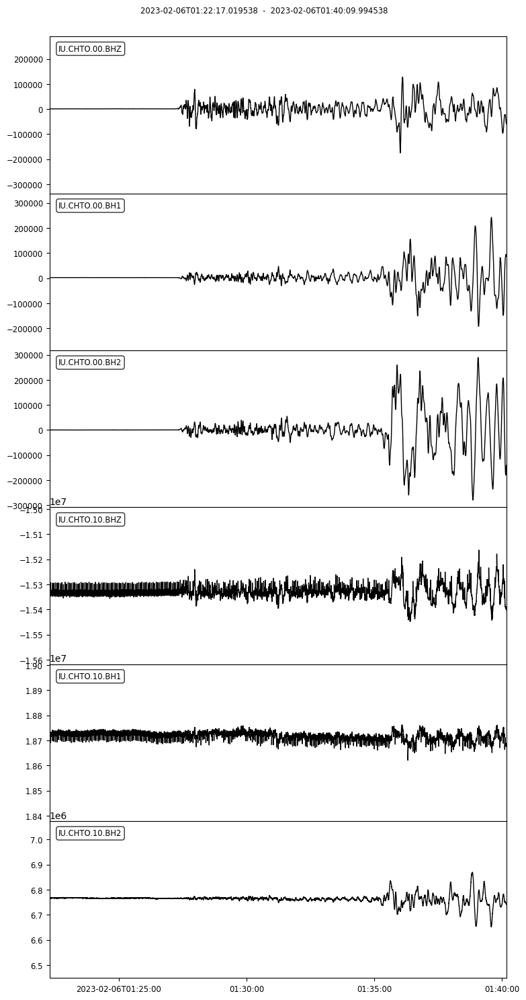

3 Trace(s) in Stream:
BK.CMB.00.BHE | 2023-02-06T01:26:27.019538Z - 2023-02-06T01:48:08.994538Z | 40.0 Hz, 52080 samples
BK.CMB.00.BHN | 2023-02-06T01:26:27.019538Z - 2023-02-06T01:48:08.994538Z | 40.0 Hz, 52080 samples
BK.CMB.00.BHZ | 2023-02-06T01:26:27.019538Z - 2023-02-06T01:48:08.994538Z | 40.0 Hz, 52080 samples


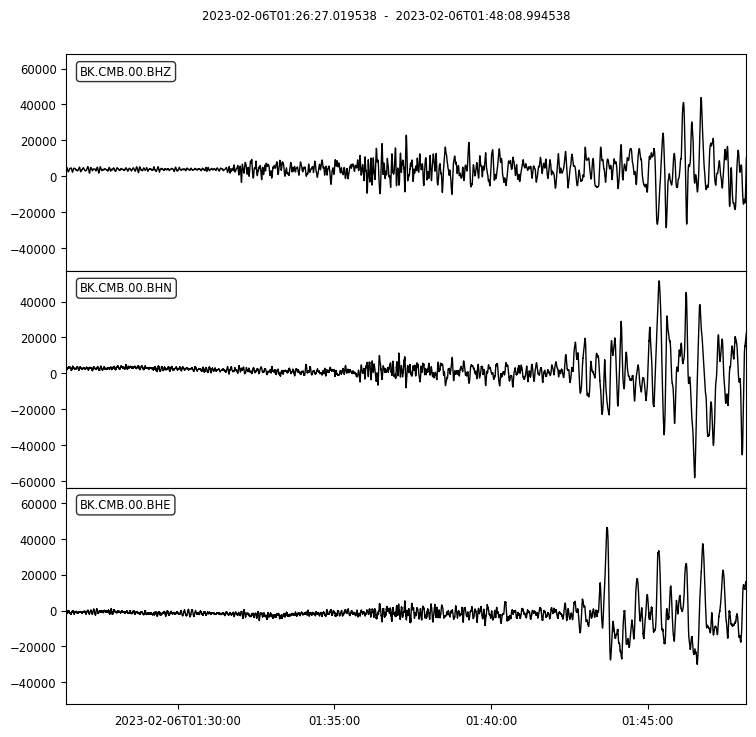

6 Trace(s) in Stream:
II.CMLA.00.BH1 | 2023-02-06T01:21:17.019538Z - 2023-02-06T01:38:19.994538Z | 40.0 Hz, 40920 samples
II.CMLA.00.BH2 | 2023-02-06T01:21:17.019538Z - 2023-02-06T01:38:19.994538Z | 40.0 Hz, 40920 samples
II.CMLA.00.BHZ | 2023-02-06T01:21:17.019538Z - 2023-02-06T01:38:19.994538Z | 40.0 Hz, 40920 samples
II.CMLA.10.BH1 | 2023-02-06T01:21:17.019538Z - 2023-02-06T01:38:19.994538Z | 40.0 Hz, 40920 samples
II.CMLA.10.BH2 | 2023-02-06T01:21:17.019538Z - 2023-02-06T01:38:19.994538Z | 40.0 Hz, 40920 samples
II.CMLA.10.BHZ | 2023-02-06T01:21:17.019538Z - 2023-02-06T01:38:19.994538Z | 40.0 Hz, 40920 samples


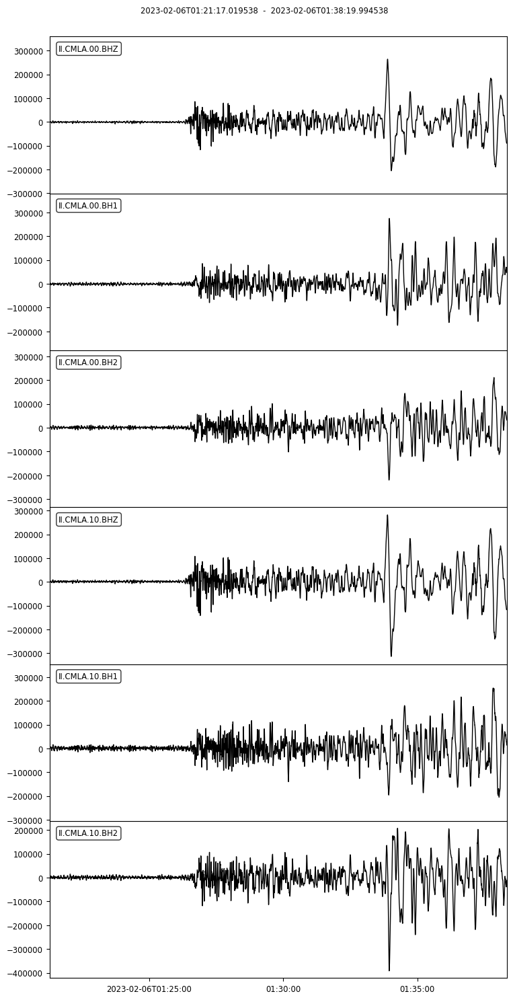

6 Trace(s) in Stream:
II.COCO.00.BH1 | 2023-02-06T01:24:13.019539Z - 2023-02-06T01:43:49.994539Z | 40.0 Hz, 47080 samples
II.COCO.00.BH2 | 2023-02-06T01:24:13.019539Z - 2023-02-06T01:43:49.994539Z | 40.0 Hz, 47080 samples
II.COCO.00.BHZ | 2023-02-06T01:24:13.019539Z - 2023-02-06T01:43:49.994539Z | 40.0 Hz, 47080 samples
II.COCO.10.BH1 | 2023-02-06T01:24:13.019539Z - 2023-02-06T01:43:49.994539Z | 40.0 Hz, 47080 samples
II.COCO.10.BH2 | 2023-02-06T01:24:13.019539Z - 2023-02-06T01:43:49.994539Z | 40.0 Hz, 47080 samples
II.COCO.10.BHZ | 2023-02-06T01:24:13.019539Z - 2023-02-06T01:43:49.994539Z | 40.0 Hz, 47080 samples


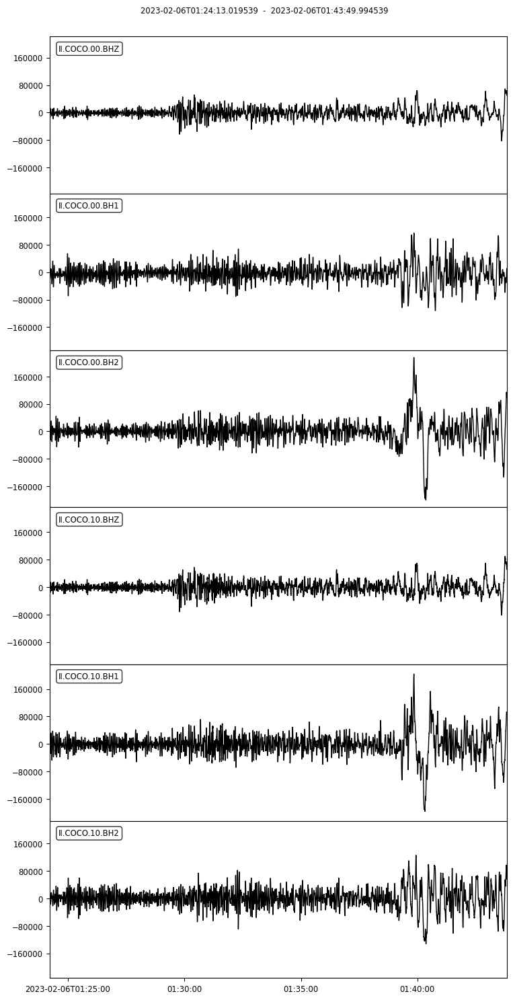

6 Trace(s) in Stream:
IU.COLA.00.BH1 | 2023-02-06T01:24:31.019538Z - 2023-02-06T01:44:24.994538Z | 40.0 Hz, 47760 samples
IU.COLA.00.BH2 | 2023-02-06T01:24:31.019536Z - 2023-02-06T01:44:24.994536Z | 40.0 Hz, 47760 samples
IU.COLA.00.BHZ | 2023-02-06T01:24:31.019536Z - 2023-02-06T01:44:24.994536Z | 40.0 Hz, 47760 samples
IU.COLA.10.BH1 | 2023-02-06T01:24:31.019538Z - 2023-02-06T01:44:24.994538Z | 40.0 Hz, 47760 samples
IU.COLA.10.BH2 | 2023-02-06T01:24:31.019538Z - 2023-02-06T01:44:24.994538Z | 40.0 Hz, 47760 samples
IU.COLA.10.BHZ | 2023-02-06T01:24:31.019538Z - 2023-02-06T01:44:24.994538Z | 40.0 Hz, 47760 samples


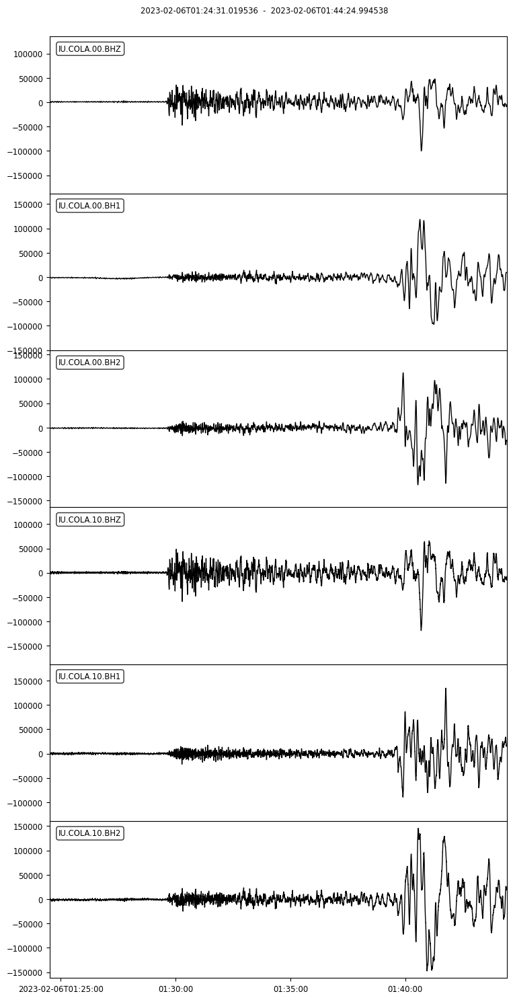

9 Trace(s) in Stream:
IU.COR.00.BH1 | 2023-02-06T01:26:02.019538Z - 2023-02-06T01:47:21.994538Z | 40.0 Hz, 51200 samples
IU.COR.00.BH2 | 2023-02-06T01:26:02.019538Z - 2023-02-06T01:47:21.994538Z | 40.0 Hz, 51200 samples
IU.COR.00.BHZ | 2023-02-06T01:26:02.019538Z - 2023-02-06T01:47:21.994538Z | 40.0 Hz, 51200 samples
IU.COR.10.BH1 | 2023-02-06T01:26:02.019538Z - 2023-02-06T01:47:21.994538Z | 40.0 Hz, 51200 samples
IU.COR.10.BH2 | 2023-02-06T01:26:02.019538Z - 2023-02-06T01:47:21.994538Z | 40.0 Hz, 51200 samples
IU.COR.10.BHZ | 2023-02-06T01:26:02.019538Z - 2023-02-06T01:47:21.994538Z | 40.0 Hz, 51200 samples
IU.COR.60.BH1 | 2023-02-06T01:26:02.019538Z - 2023-02-06T01:47:21.969538Z | 20.0 Hz, 25600 samples
IU.COR.60.BH2 | 2023-02-06T01:26:02.019538Z - 2023-02-06T01:47:21.969538Z | 20.0 Hz, 25600 samples
IU.COR.60.BHZ | 2023-02-06T01:26:02.019538Z - 2023-02-06T01:47:21.969538Z | 20.0 Hz, 25600 samples


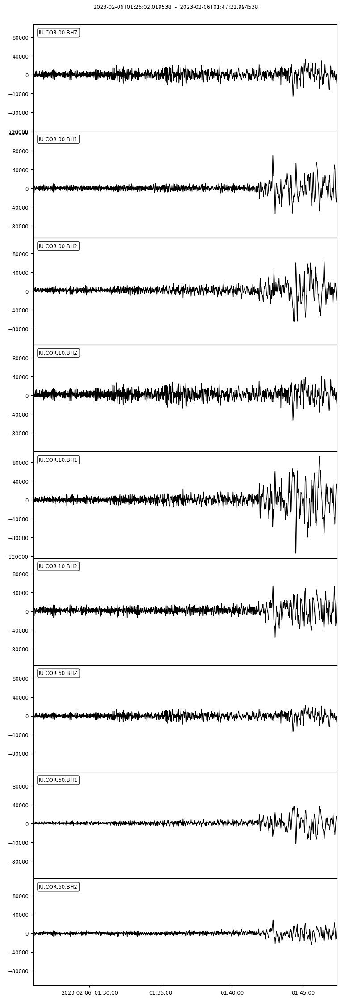

6 Trace(s) in Stream:
IU.CTAO.00.BH1 | 2023-02-06T01:27:34.019538Z - 2023-02-06T01:50:14.994538Z | 40.0 Hz, 54440 samples
IU.CTAO.00.BH2 | 2023-02-06T01:27:34.019538Z - 2023-02-06T01:50:14.994538Z | 40.0 Hz, 54440 samples
IU.CTAO.00.BHZ | 2023-02-06T01:27:34.019539Z - 2023-02-06T01:50:14.994539Z | 40.0 Hz, 54440 samples
IU.CTAO.10.BH1 | 2023-02-06T01:27:34.019538Z - 2023-02-06T01:50:14.994538Z | 40.0 Hz, 54440 samples
IU.CTAO.10.BH2 | 2023-02-06T01:27:34.019538Z - 2023-02-06T01:50:14.994538Z | 40.0 Hz, 54440 samples
IU.CTAO.10.BHZ | 2023-02-06T01:27:34.019538Z - 2023-02-06T01:50:14.994538Z | 40.0 Hz, 54440 samples


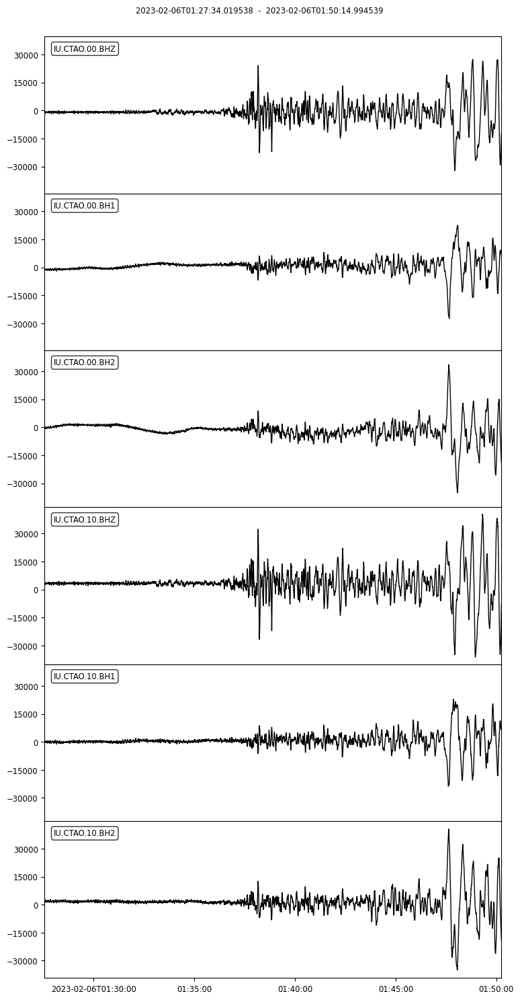

6 Trace(s) in Stream:
IU.DAV.00.BH1 | 2023-02-06T01:25:07.019539Z - 2023-02-06T01:45:34.994539Z | 40.0 Hz, 49120 samples
IU.DAV.00.BH2 | 2023-02-06T01:25:07.019539Z - 2023-02-06T01:45:34.994539Z | 40.0 Hz, 49120 samples
IU.DAV.00.BHZ | 2023-02-06T01:25:07.019539Z - 2023-02-06T01:45:34.994539Z | 40.0 Hz, 49120 samples
IU.DAV.10.BH1 | 2023-02-06T01:25:07.019538Z - 2023-02-06T01:45:34.994538Z | 40.0 Hz, 49120 samples
IU.DAV.10.BH2 | 2023-02-06T01:25:07.019539Z - 2023-02-06T01:45:34.994539Z | 40.0 Hz, 49120 samples
IU.DAV.10.BHZ | 2023-02-06T01:25:07.019539Z - 2023-02-06T01:45:34.994539Z | 40.0 Hz, 49120 samples


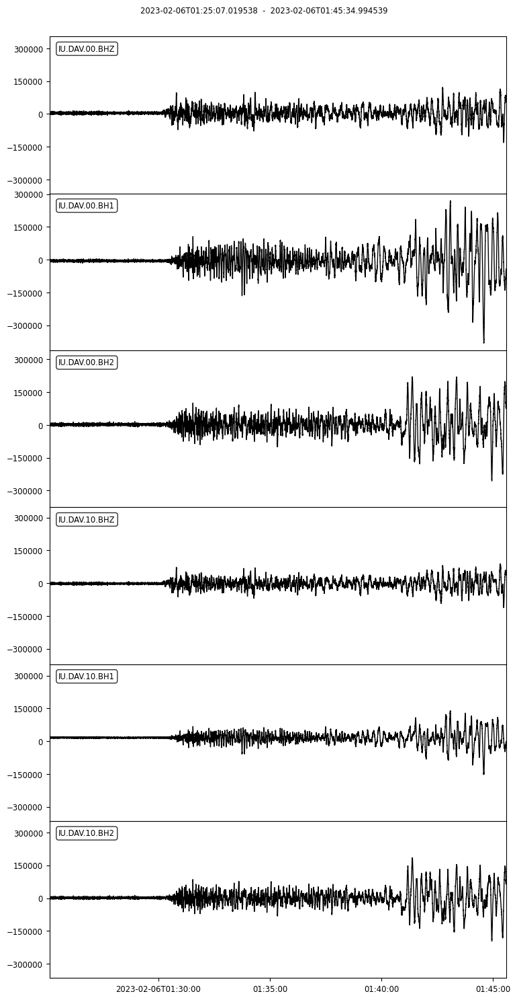

6 Trace(s) in Stream:
II.DGAR.00.BH1 | 2023-02-06T01:22:09.019536Z - 2023-02-06T01:39:54.969536Z | 20.0 Hz, 21320 samples
II.DGAR.00.BH2 | 2023-02-06T01:22:09.019536Z - 2023-02-06T01:39:54.969536Z | 20.0 Hz, 21320 samples
II.DGAR.00.BHZ | 2023-02-06T01:22:09.019536Z - 2023-02-06T01:39:54.969536Z | 20.0 Hz, 21320 samples
II.DGAR.10.BH1 | 2023-02-06T01:22:09.019538Z - 2023-02-06T01:39:54.994538Z | 40.0 Hz, 42640 samples
II.DGAR.10.BH2 | 2023-02-06T01:22:09.019538Z - 2023-02-06T01:39:54.994538Z | 40.0 Hz, 42640 samples
II.DGAR.10.BHZ | 2023-02-06T01:22:09.019538Z - 2023-02-06T01:39:54.994538Z | 40.0 Hz, 42640 samples


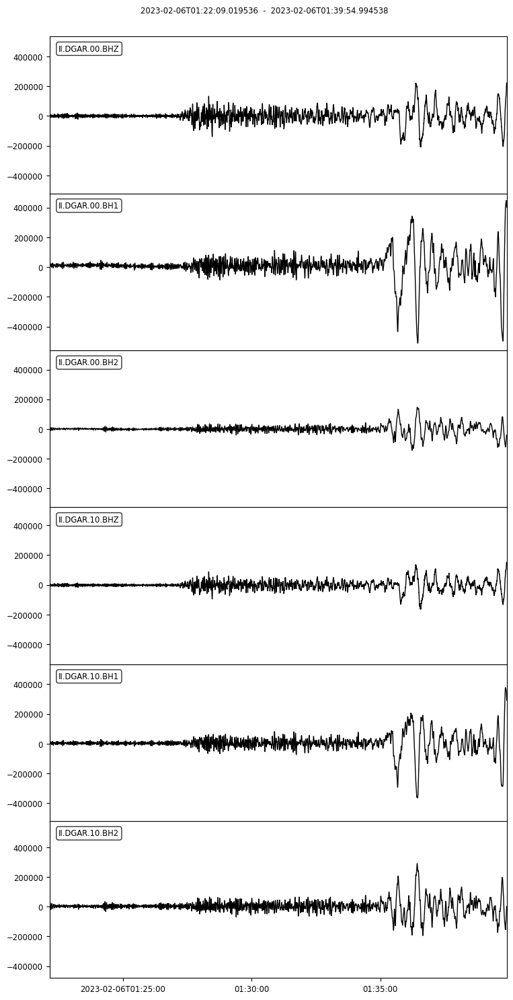

6 Trace(s) in Stream:
IU.DWPF.00.BH1 | 2023-02-06T01:25:46.019538Z - 2023-02-06T01:46:51.994538Z | 40.0 Hz, 50640 samples
IU.DWPF.00.BH2 | 2023-02-06T01:25:46.019538Z - 2023-02-06T01:46:51.994538Z | 40.0 Hz, 50640 samples
IU.DWPF.00.BHZ | 2023-02-06T01:25:46.019538Z - 2023-02-06T01:46:51.994538Z | 40.0 Hz, 50640 samples
IU.DWPF.10.BH1 | 2023-02-06T01:25:46.019538Z - 2023-02-06T01:46:51.994538Z | 40.0 Hz, 50640 samples
IU.DWPF.10.BH2 | 2023-02-06T01:25:46.019538Z - 2023-02-06T01:46:51.994538Z | 40.0 Hz, 50640 samples
IU.DWPF.10.BHZ | 2023-02-06T01:25:46.019538Z - 2023-02-06T01:46:51.994538Z | 40.0 Hz, 50640 samples


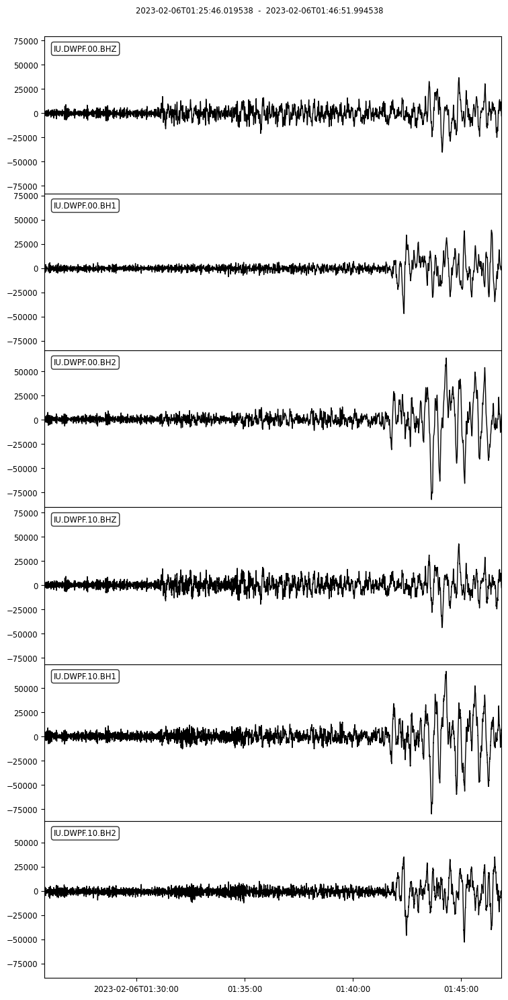

6 Trace(s) in Stream:
II.EFI.00.BH1 | 2023-02-06T01:27:53.019538Z - 2023-02-06T01:50:49.994538Z | 40.0 Hz, 55080 samples
II.EFI.00.BH2 | 2023-02-06T01:27:53.019538Z - 2023-02-06T01:50:49.994538Z | 40.0 Hz, 55080 samples
II.EFI.00.BHZ | 2023-02-06T01:27:53.019538Z - 2023-02-06T01:50:49.994538Z | 40.0 Hz, 55080 samples
II.EFI.10.BH1 | 2023-02-06T01:27:53.019538Z - 2023-02-06T01:50:49.994538Z | 40.0 Hz, 55080 samples
II.EFI.10.BH2 | 2023-02-06T01:27:53.019538Z - 2023-02-06T01:50:49.994538Z | 40.0 Hz, 55080 samples
II.EFI.10.BHZ | 2023-02-06T01:27:53.019538Z - 2023-02-06T01:50:49.994538Z | 40.0 Hz, 55080 samples


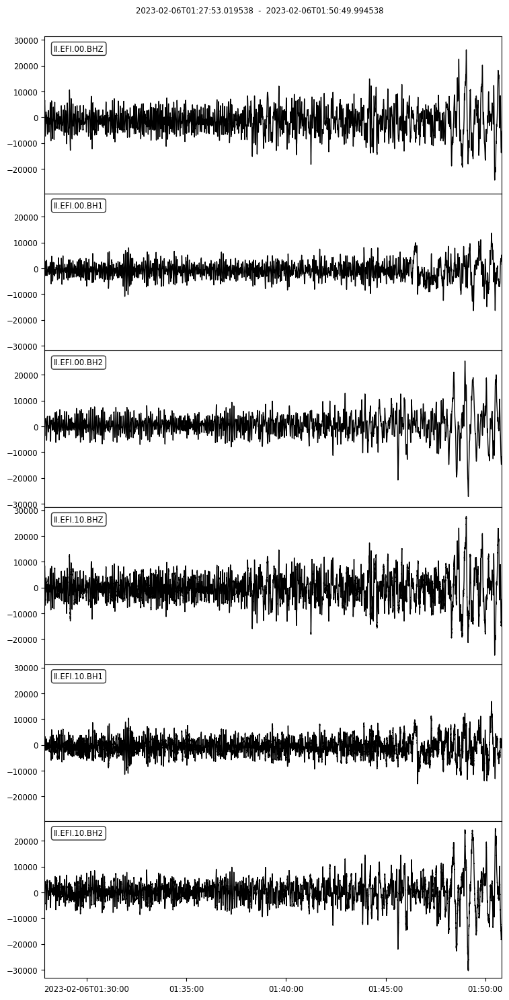

6 Trace(s) in Stream:
IC.ENH.00.BH1 | 2023-02-06T01:22:35.019538Z - 2023-02-06T01:40:42.969538Z | 20.0 Hz, 21760 samples
IC.ENH.00.BH2 | 2023-02-06T01:22:35.019538Z - 2023-02-06T01:40:42.969538Z | 20.0 Hz, 21760 samples
IC.ENH.00.BHZ | 2023-02-06T01:22:35.019538Z - 2023-02-06T01:40:42.969538Z | 20.0 Hz, 21760 samples
IC.ENH.60.BH1 | 2023-02-06T01:22:35.019538Z - 2023-02-06T01:40:42.994538Z | 40.0 Hz, 43520 samples
IC.ENH.60.BH2 | 2023-02-06T01:22:35.019538Z - 2023-02-06T01:40:42.994538Z | 40.0 Hz, 43520 samples
IC.ENH.60.BHZ | 2023-02-06T01:22:35.019538Z - 2023-02-06T01:40:42.994538Z | 40.0 Hz, 43520 samples


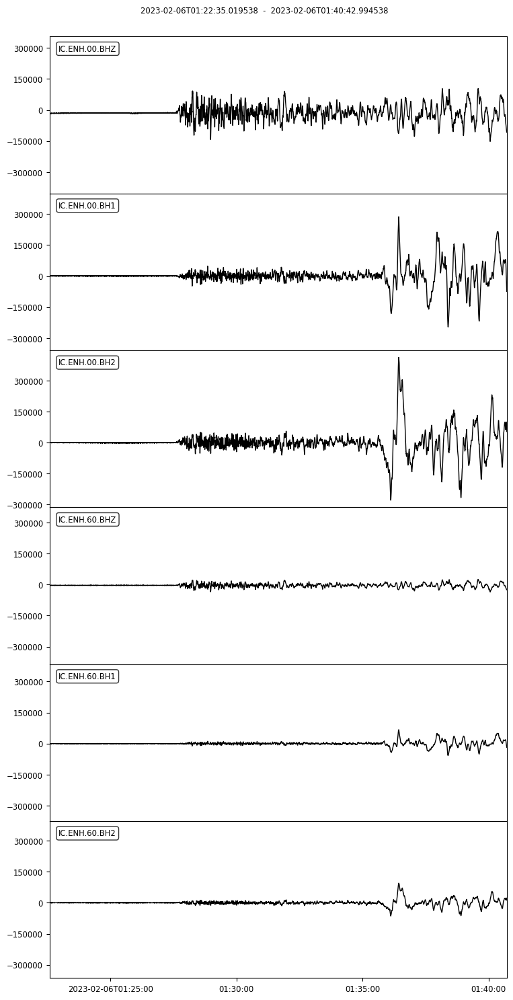

6 Trace(s) in Stream:
II.ERM.00.BH1 | 2023-02-06T01:24:21.019538Z - 2023-02-06T01:44:05.969538Z | 20.0 Hz, 23700 samples
II.ERM.00.BH2 | 2023-02-06T01:24:21.019538Z - 2023-02-06T01:44:05.969538Z | 20.0 Hz, 23700 samples
II.ERM.00.BHZ | 2023-02-06T01:24:21.019538Z - 2023-02-06T01:44:05.969538Z | 20.0 Hz, 23700 samples
II.ERM.10.BH1 | 2023-02-06T01:24:21.019538Z - 2023-02-06T01:44:05.994538Z | 40.0 Hz, 47400 samples
II.ERM.10.BH2 | 2023-02-06T01:24:21.019538Z - 2023-02-06T01:44:05.994538Z | 40.0 Hz, 47400 samples
II.ERM.10.BHZ | 2023-02-06T01:24:21.019538Z - 2023-02-06T01:44:05.994538Z | 40.0 Hz, 47400 samples


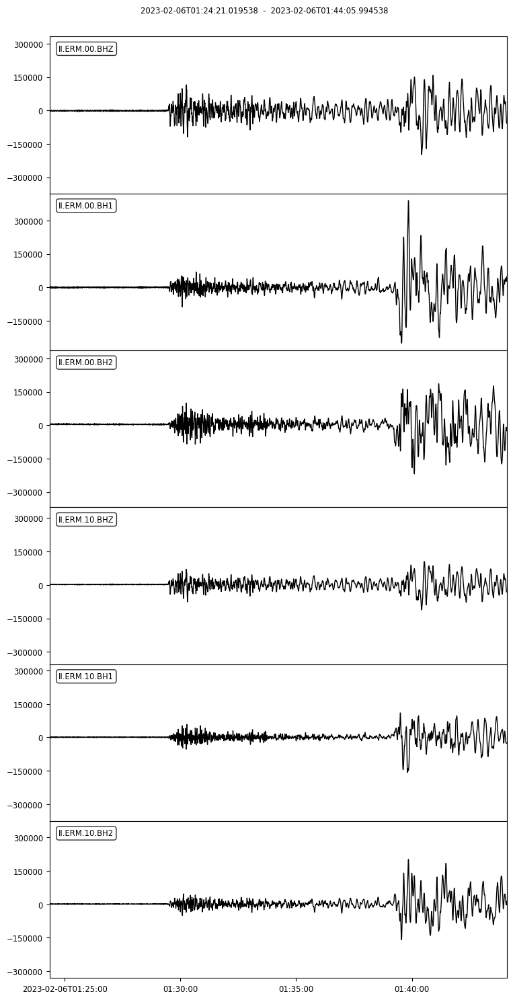

6 Trace(s) in Stream:
II.ESK.00.BH1 | 2023-02-06T01:19:04.019538Z - 2023-02-06T01:34:19.969538Z | 20.0 Hz, 18320 samples
II.ESK.00.BH2 | 2023-02-06T01:19:04.019538Z - 2023-02-06T01:34:19.969538Z | 20.0 Hz, 18320 samples
II.ESK.00.BHZ | 2023-02-06T01:19:04.019538Z - 2023-02-06T01:34:19.969538Z | 20.0 Hz, 18320 samples
II.ESK.10.BH1 | 2023-02-06T01:19:04.019538Z - 2023-02-06T01:34:19.994538Z | 40.0 Hz, 36640 samples
II.ESK.10.BH2 | 2023-02-06T01:19:04.019536Z - 2023-02-06T01:34:19.994536Z | 40.0 Hz, 36640 samples
II.ESK.10.BHZ | 2023-02-06T01:19:04.019538Z - 2023-02-06T01:34:19.994538Z | 40.0 Hz, 36640 samples


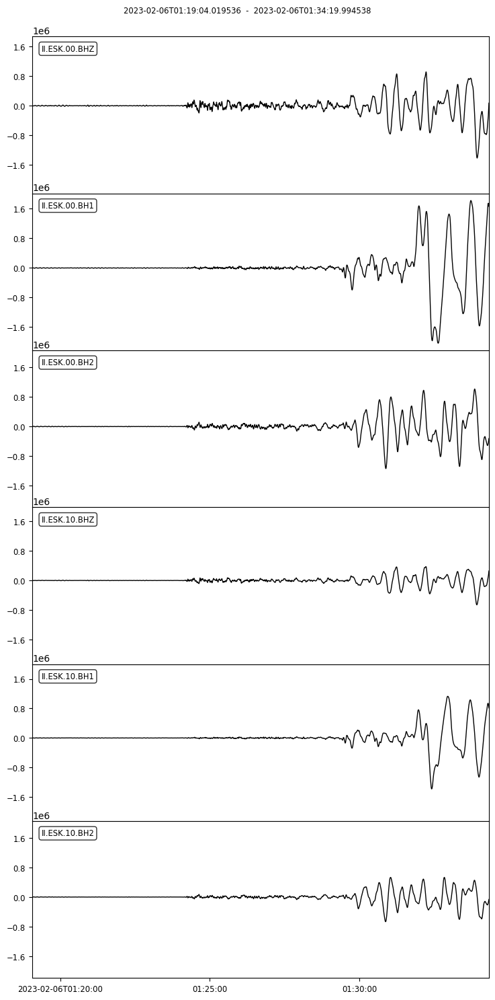

6 Trace(s) in Stream:
II.FFC.00.BH1 | 2023-02-06T01:24:51.019538Z - 2023-02-06T01:45:03.994538Z | 40.0 Hz, 48520 samples
II.FFC.00.BH2 | 2023-02-06T01:24:51.019538Z - 2023-02-06T01:45:03.994538Z | 40.0 Hz, 48520 samples
II.FFC.00.BHZ | 2023-02-06T01:24:51.019538Z - 2023-02-06T01:45:03.994538Z | 40.0 Hz, 48520 samples
II.FFC.10.BH1 | 2023-02-06T01:24:51.019538Z - 2023-02-06T01:45:03.994538Z | 40.0 Hz, 48520 samples
II.FFC.10.BH2 | 2023-02-06T01:24:51.019538Z - 2023-02-06T01:45:03.994538Z | 40.0 Hz, 48520 samples
II.FFC.10.BHZ | 2023-02-06T01:24:51.019538Z - 2023-02-06T01:45:03.994538Z | 40.0 Hz, 48520 samples


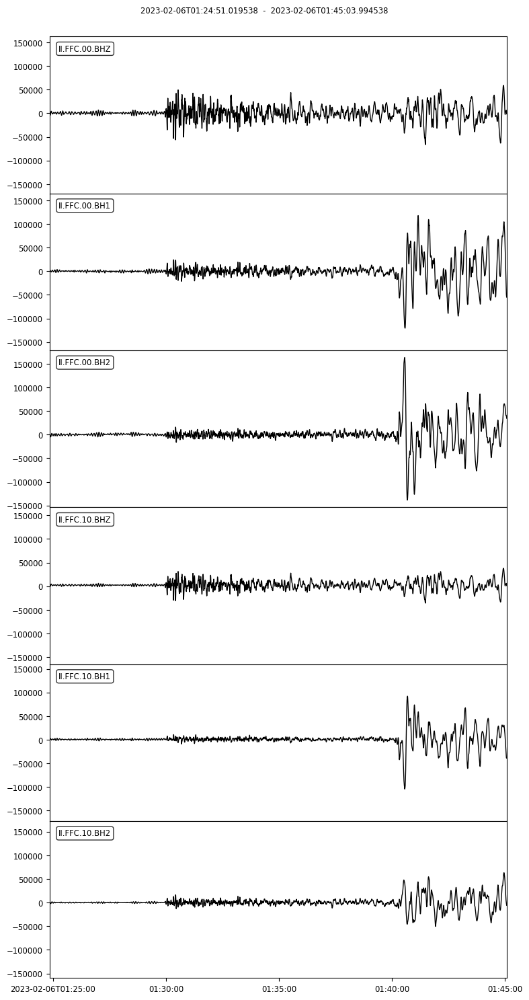

3 Trace(s) in Stream:
IU.FUNA.00.BH1 | 2023-02-06T01:28:56.019538Z - 2023-02-06T01:52:47.994538Z | 40.0 Hz, 57280 samples
IU.FUNA.00.BH2 | 2023-02-06T01:28:56.019538Z - 2023-02-06T01:52:47.994538Z | 40.0 Hz, 57280 samples
IU.FUNA.00.BHZ | 2023-02-06T01:28:56.019538Z - 2023-02-06T01:52:47.994538Z | 40.0 Hz, 57280 samples


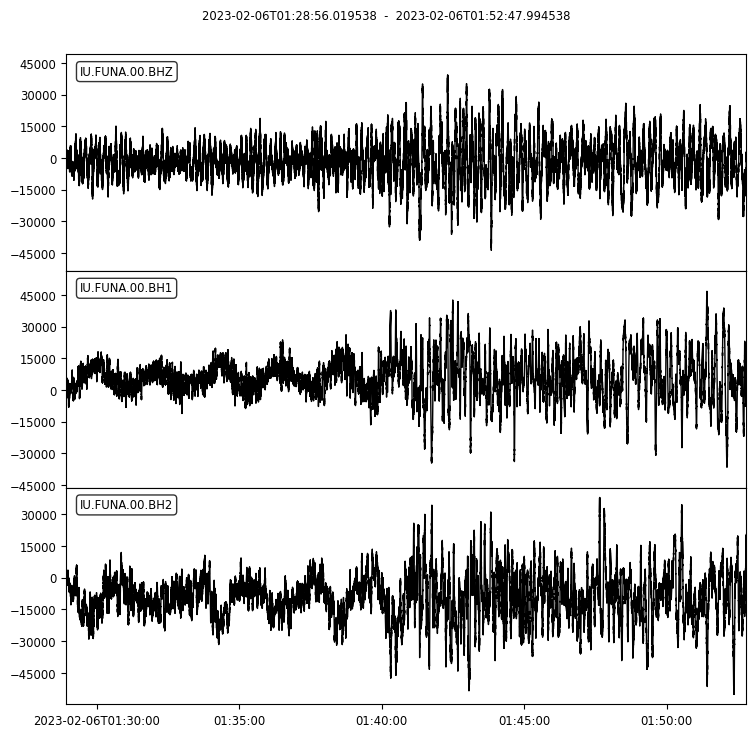

0 Trace(s) in Stream:

No waveform data found for station FURI 
 
 

6 Trace(s) in Stream:
IU.GNI.00.BH1 | 2023-02-06T01:14:12.019541Z - 2023-02-06T01:25:28.969541Z | 20.0 Hz, 13540 samples
IU.GNI.00.BH2 | 2023-02-06T01:14:12.019539Z - 2023-02-06T01:25:28.969539Z | 20.0 Hz, 13540 samples
IU.GNI.00.BHZ | 2023-02-06T01:14:12.019538Z - 2023-02-06T01:25:28.969538Z | 20.0 Hz, 13540 samples
IU.GNI.10.BH1 | 2023-02-06T01:14:12.019539Z - 2023-02-06T01:25:28.994539Z | 40.0 Hz, 27080 samples
IU.GNI.10.BH2 | 2023-02-06T01:14:12.019539Z - 2023-02-06T01:25:28.994539Z | 40.0 Hz, 27080 samples
IU.GNI.10.BHZ | 2023-02-06T01:14:12.019538Z - 2023-02-06T01:25:28.994538Z | 40.0 Hz, 27080 samples


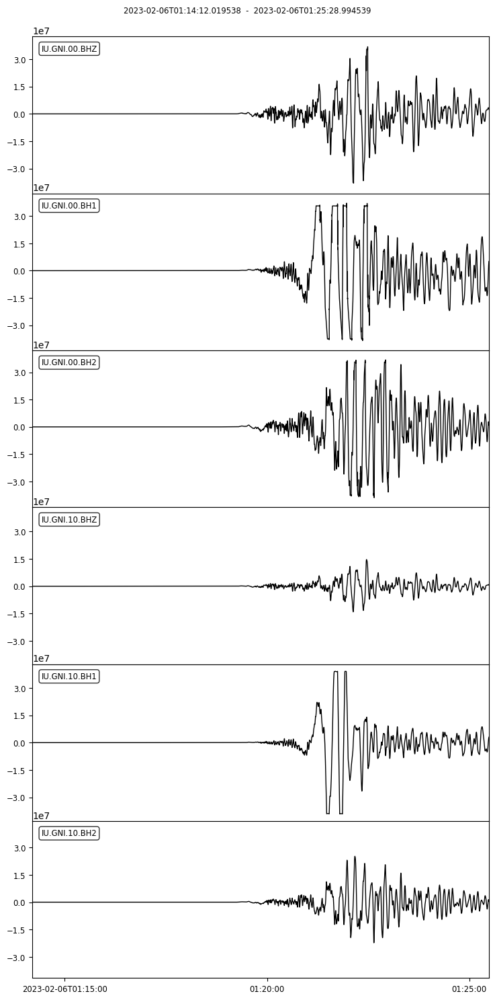

0 Trace(s) in Stream:

No waveform data found for station GRFO 
 
 

3 Trace(s) in Stream:
CU.GRGR.00.BH1 | 2023-02-06T01:25:31.019538Z - 2023-02-06T01:46:20.994538Z | 40.0 Hz, 50000 samples
CU.GRGR.00.BH2 | 2023-02-06T01:25:31.019538Z - 2023-02-06T01:46:20.994538Z | 40.0 Hz, 50000 samples
CU.GRGR.00.BHZ | 2023-02-06T01:25:31.019538Z - 2023-02-06T01:46:20.994538Z | 40.0 Hz, 50000 samples


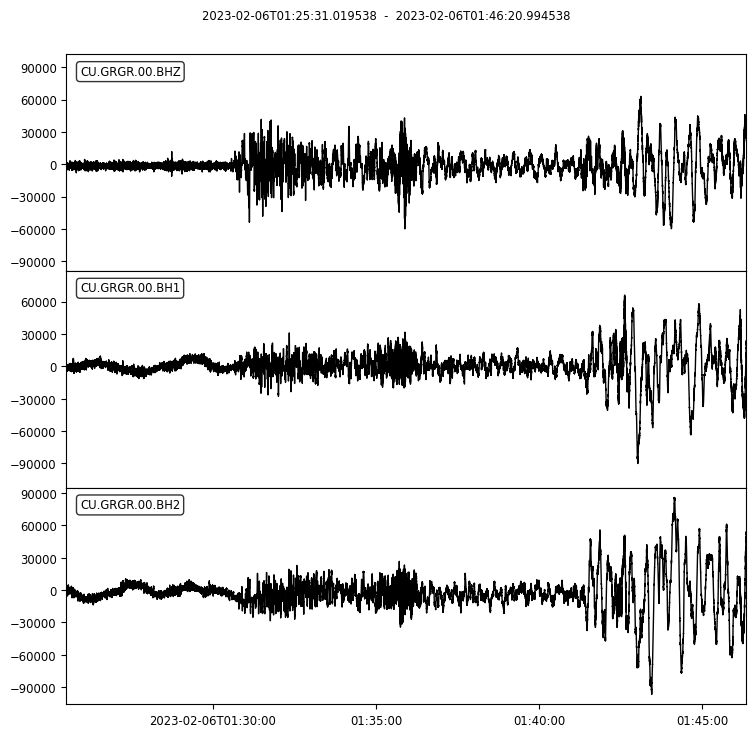

3 Trace(s) in Stream:
CU.GRTK.00.BH1 | 2023-02-06T01:25:36.019538Z - 2023-02-06T01:46:30.994538Z | 40.0 Hz, 50200 samples
CU.GRTK.00.BH2 | 2023-02-06T01:25:36.019539Z - 2023-02-06T01:46:30.994539Z | 40.0 Hz, 50200 samples
CU.GRTK.00.BHZ | 2023-02-06T01:25:36.019538Z - 2023-02-06T01:46:30.994538Z | 40.0 Hz, 50200 samples


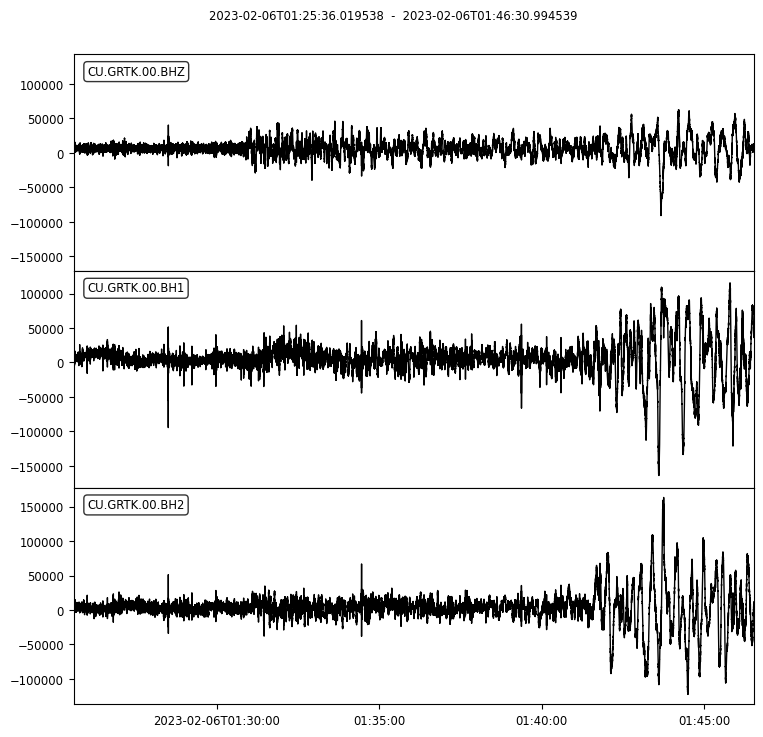

0 Trace(s) in Stream:

No waveform data found for station GTBY 
 
 

6 Trace(s) in Stream:
IU.GUMO.00.BH1 | 2023-02-06T01:25:58.019538Z - 2023-02-06T01:47:14.994538Z | 40.0 Hz, 51080 samples
IU.GUMO.00.BH2 | 2023-02-06T01:25:58.019538Z - 2023-02-06T01:47:14.994538Z | 40.0 Hz, 51080 samples
IU.GUMO.00.BHZ | 2023-02-06T01:25:58.019538Z - 2023-02-06T01:47:14.994538Z | 40.0 Hz, 51080 samples
IU.GUMO.10.BH1 | 2023-02-06T01:25:58.019538Z - 2023-02-06T01:47:14.994538Z | 40.0 Hz, 51080 samples
IU.GUMO.10.BH2 | 2023-02-06T01:25:58.019538Z - 2023-02-06T01:47:14.994538Z | 40.0 Hz, 51080 samples
IU.GUMO.10.BHZ | 2023-02-06T01:25:58.019538Z - 2023-02-06T01:47:14.994538Z | 40.0 Hz, 51080 samples


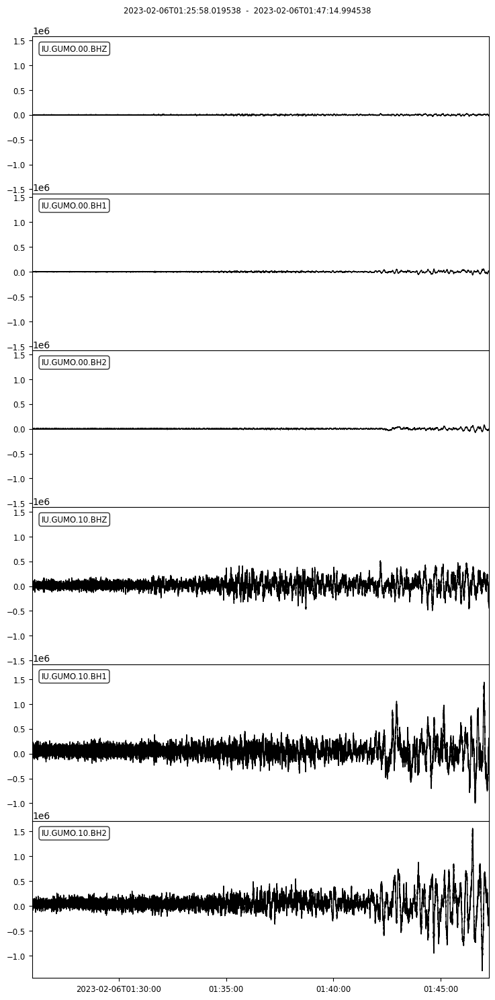

3 Trace(s) in Stream:
IC.HIA.00.BH1 | 2023-02-06T01:22:29.019538Z - 2023-02-06T01:40:31.969538Z | 20.0 Hz, 21660 samples
IC.HIA.00.BH2 | 2023-02-06T01:22:29.019538Z - 2023-02-06T01:40:31.969538Z | 20.0 Hz, 21660 samples
IC.HIA.00.BHZ | 2023-02-06T01:22:29.019536Z - 2023-02-06T01:40:31.969536Z | 20.0 Hz, 21660 samples


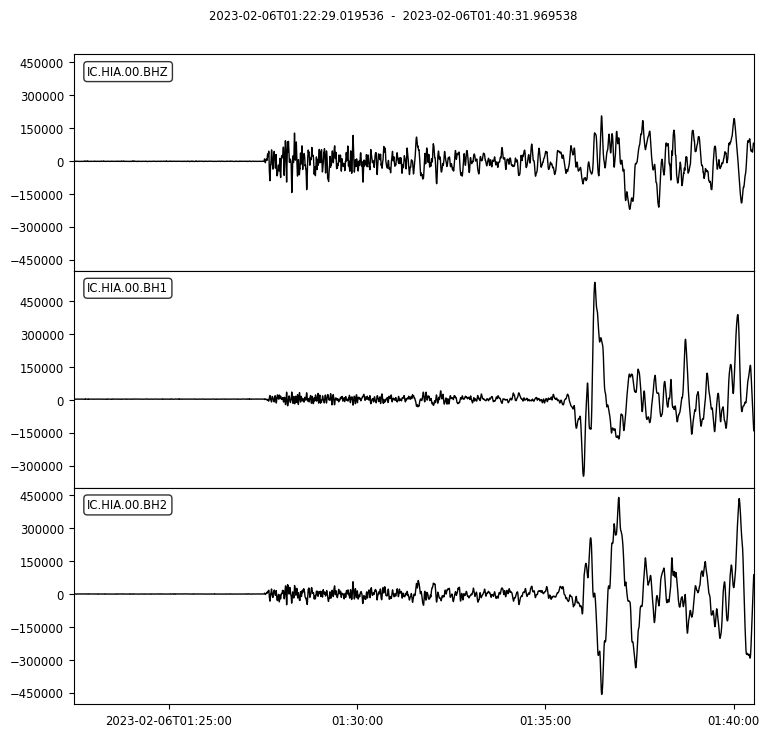

6 Trace(s) in Stream:
HK.HKPS..BHE   | 2023-02-06T01:23:25.019500Z - 2023-02-06T01:42:18.994500Z | 40.0 Hz, 45360 samples
HK.HKPS..BHN   | 2023-02-06T01:23:25.019500Z - 2023-02-06T01:42:18.994500Z | 40.0 Hz, 45360 samples
HK.HKPS..BHZ   | 2023-02-06T01:23:25.019500Z - 2023-02-06T01:42:18.994500Z | 40.0 Hz, 45360 samples
HK.HKPS.00.BHE | 2023-02-06T01:23:25.019500Z - 2023-02-06T01:42:18.969500Z | 20.0 Hz, 22680 samples
HK.HKPS.00.BHN | 2023-02-06T01:23:25.019500Z - 2023-02-06T01:42:18.969500Z | 20.0 Hz, 22680 samples
HK.HKPS.00.BHZ | 2023-02-06T01:23:25.019500Z - 2023-02-06T01:42:18.969500Z | 20.0 Hz, 22680 samples


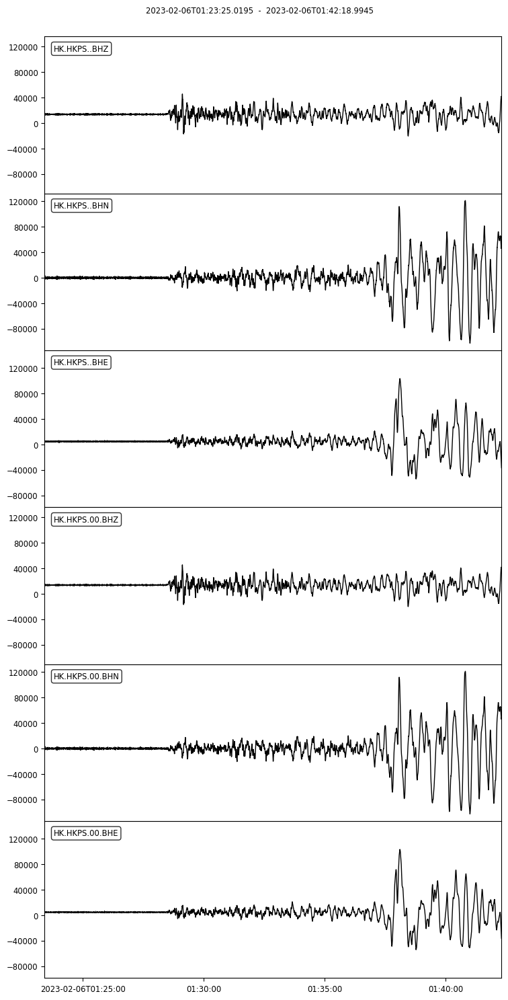

6 Trace(s) in Stream:
IU.HKT.00.BH1 | 2023-02-06T01:26:17.019538Z - 2023-02-06T01:47:49.994538Z | 40.0 Hz, 51720 samples
IU.HKT.00.BH2 | 2023-02-06T01:26:17.019538Z - 2023-02-06T01:47:49.994538Z | 40.0 Hz, 51720 samples
IU.HKT.00.BHZ | 2023-02-06T01:26:17.019538Z - 2023-02-06T01:47:49.994538Z | 40.0 Hz, 51720 samples
IU.HKT.10.BH1 | 2023-02-06T01:26:17.019538Z - 2023-02-06T01:47:49.994538Z | 40.0 Hz, 51720 samples
IU.HKT.10.BH2 | 2023-02-06T01:26:17.019539Z - 2023-02-06T01:47:49.994539Z | 40.0 Hz, 51720 samples
IU.HKT.10.BHZ | 2023-02-06T01:26:17.019539Z - 2023-02-06T01:47:49.994539Z | 40.0 Hz, 51720 samples


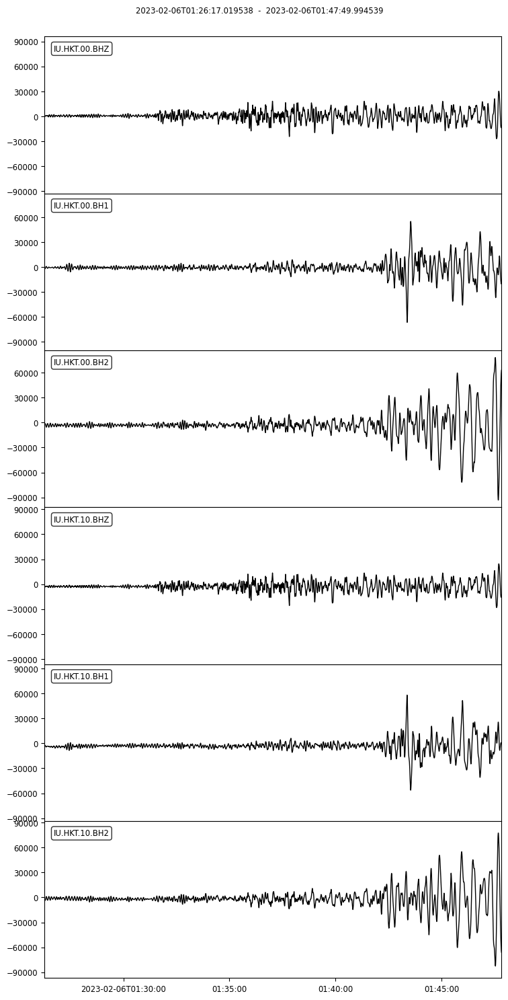

6 Trace(s) in Stream:
IU.HNR.00.BH1 | 2023-02-06T01:27:55.019538Z - 2023-02-06T01:50:53.994538Z | 40.0 Hz, 55160 samples
IU.HNR.00.BH2 | 2023-02-06T01:27:55.019539Z - 2023-02-06T01:50:53.994539Z | 40.0 Hz, 55160 samples
IU.HNR.00.BHZ | 2023-02-06T01:27:55.019539Z - 2023-02-06T01:50:53.994539Z | 40.0 Hz, 55160 samples
IU.HNR.10.BH1 | 2023-02-06T01:27:55.019538Z - 2023-02-06T01:50:53.994538Z | 40.0 Hz, 55160 samples
IU.HNR.10.BH2 | 2023-02-06T01:27:55.019538Z - 2023-02-06T01:50:53.994538Z | 40.0 Hz, 55160 samples
IU.HNR.10.BHZ | 2023-02-06T01:27:55.019538Z - 2023-02-06T01:50:53.994538Z | 40.0 Hz, 55160 samples


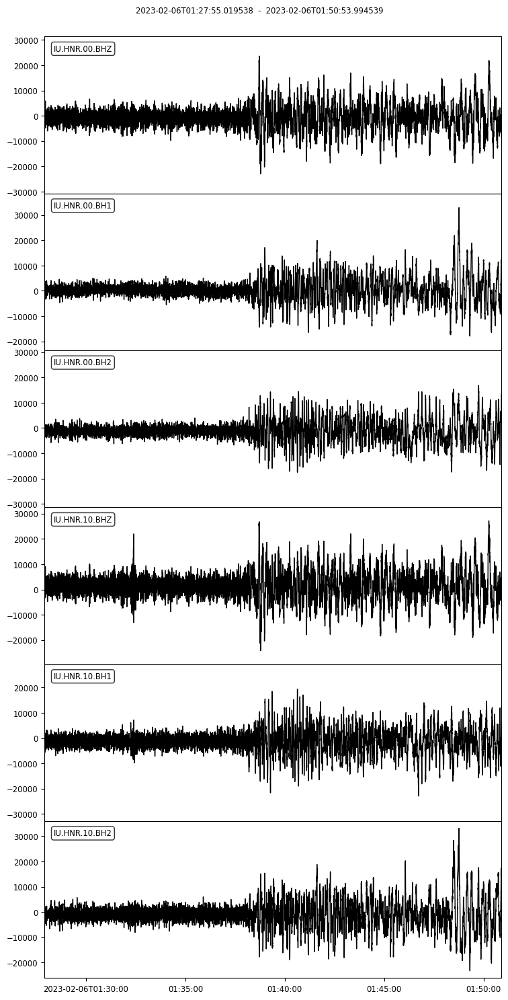

6 Trace(s) in Stream:
II.HOPE.00.BH1 | 2023-02-06T01:27:08.019538Z - 2023-02-06T01:49:24.969538Z | 20.0 Hz, 26740 samples
II.HOPE.00.BH2 | 2023-02-06T01:27:08.019539Z - 2023-02-06T01:49:24.969539Z | 20.0 Hz, 26740 samples
II.HOPE.00.BHZ | 2023-02-06T01:27:08.019538Z - 2023-02-06T01:49:24.969538Z | 20.0 Hz, 26740 samples
II.HOPE.10.BH1 | 2023-02-06T01:27:08.019539Z - 2023-02-06T01:49:24.994539Z | 40.0 Hz, 53480 samples
II.HOPE.10.BH2 | 2023-02-06T01:27:08.019539Z - 2023-02-06T01:49:24.994539Z | 40.0 Hz, 53480 samples
II.HOPE.10.BHZ | 2023-02-06T01:27:08.019539Z - 2023-02-06T01:49:24.994539Z | 40.0 Hz, 53480 samples


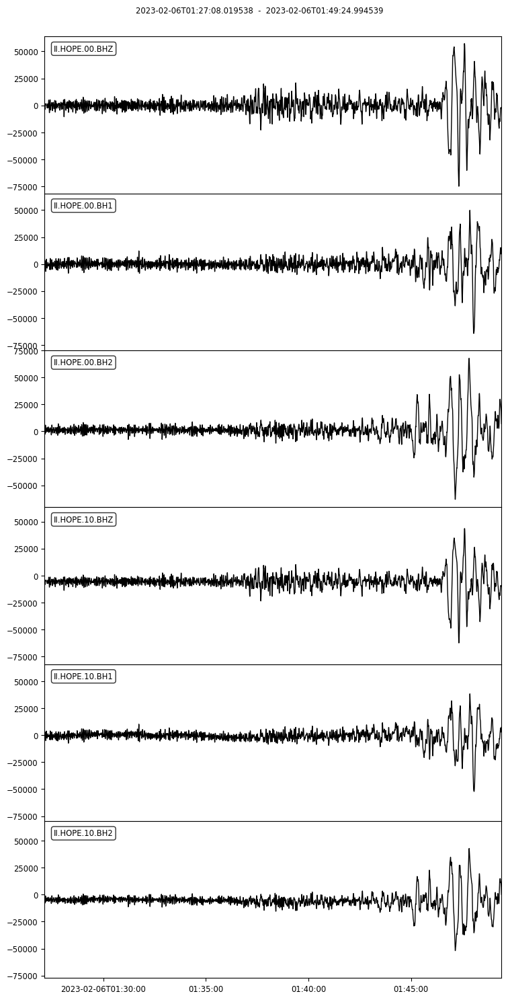

9 Trace(s) in Stream:
IU.HRV.00.BH1 | 2023-02-06T01:24:28.019538Z - 2023-02-06T01:44:17.969538Z | 20.0 Hz, 23800 samples
IU.HRV.00.BH2 | 2023-02-06T01:24:28.019538Z - 2023-02-06T01:44:17.969538Z | 20.0 Hz, 23800 samples
IU.HRV.00.BHZ | 2023-02-06T01:24:28.019538Z - 2023-02-06T01:44:17.969538Z | 20.0 Hz, 23800 samples
IU.HRV.10.BH1 | 2023-02-06T01:24:28.019538Z - 2023-02-06T01:44:17.994538Z | 40.0 Hz, 47600 samples
IU.HRV.10.BH2 | 2023-02-06T01:24:28.019538Z - 2023-02-06T01:44:17.994538Z | 40.0 Hz, 47600 samples
IU.HRV.10.BHZ | 2023-02-06T01:24:28.019538Z - 2023-02-06T01:44:17.994538Z | 40.0 Hz, 47600 samples
IU.HRV.60.BH1 | 2023-02-06T01:24:28.019538Z - 2023-02-06T01:44:17.994538Z | 40.0 Hz, 47600 samples
IU.HRV.60.BH2 | 2023-02-06T01:24:28.019538Z - 2023-02-06T01:44:17.994538Z | 40.0 Hz, 47600 samples
IU.HRV.60.BHZ | 2023-02-06T01:24:28.019538Z - 2023-02-06T01:44:17.994538Z | 40.0 Hz, 47600 samples


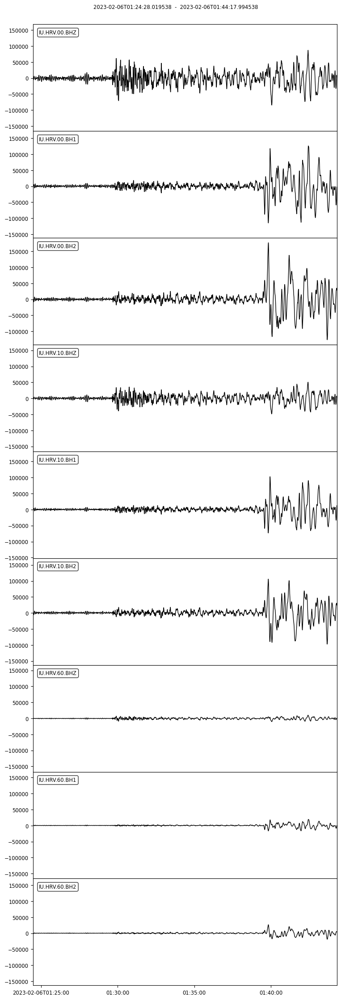

3 Trace(s) in Stream:
IM.IL31..BHE | 2023-02-06T01:24:32.000000Z - 2023-02-06T01:44:26.000000Z | 40.0 Hz, 47761 samples
IM.IL31..BHN | 2023-02-06T01:24:32.000000Z - 2023-02-06T01:44:26.000000Z | 40.0 Hz, 47761 samples
IM.IL31..BHZ | 2023-02-06T01:24:32.000000Z - 2023-02-06T01:44:26.000000Z | 40.0 Hz, 47761 samples


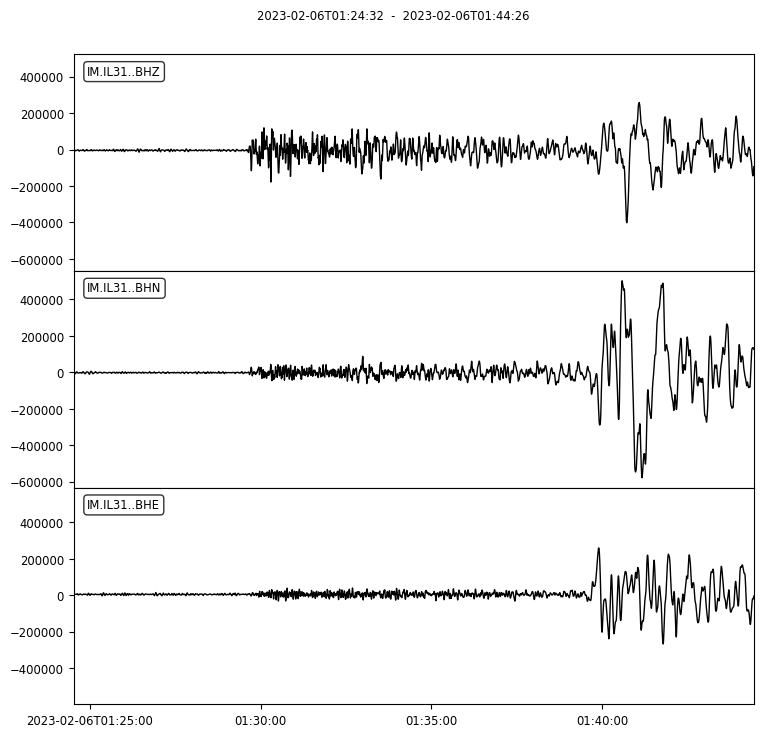

6 Trace(s) in Stream:
IU.INCN.00.BH1 | 2023-02-06T01:23:34.019538Z - 2023-02-06T01:42:33.969538Z | 20.0 Hz, 22800 samples
IU.INCN.00.BH2 | 2023-02-06T01:23:34.019538Z - 2023-02-06T01:42:33.969538Z | 20.0 Hz, 22800 samples
IU.INCN.00.BHZ | 2023-02-06T01:23:34.019538Z - 2023-02-06T01:42:33.969538Z | 20.0 Hz, 22800 samples
IU.INCN.10.BH1 | 2023-02-06T01:23:34.019536Z - 2023-02-06T01:42:33.994536Z | 40.0 Hz, 45600 samples
IU.INCN.10.BH2 | 2023-02-06T01:23:34.019538Z - 2023-02-06T01:42:33.994538Z | 40.0 Hz, 45600 samples
IU.INCN.10.BHZ | 2023-02-06T01:23:34.019538Z - 2023-02-06T01:42:33.994538Z | 40.0 Hz, 45600 samples


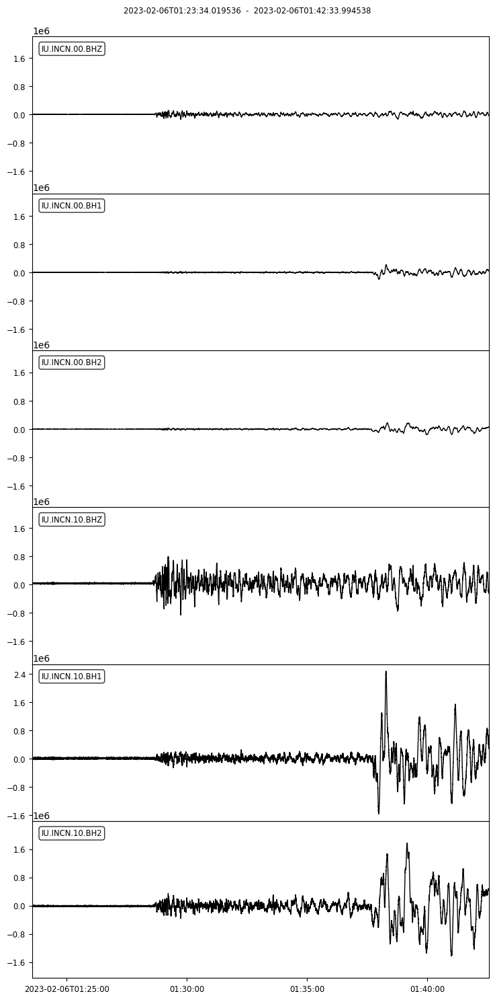

0 Trace(s) in Stream:

No waveform data found for station JOHN 
 
 

6 Trace(s) in Stream:
II.JTS.00.BH1 | 2023-02-06T01:26:53.019538Z - 2023-02-06T01:48:58.994538Z | 40.0 Hz, 53040 samples
II.JTS.00.BH2 | 2023-02-06T01:26:53.019538Z - 2023-02-06T01:48:58.994538Z | 40.0 Hz, 53040 samples
II.JTS.00.BHZ | 2023-02-06T01:26:53.019538Z - 2023-02-06T01:48:58.994538Z | 40.0 Hz, 53040 samples
II.JTS.10.BH1 | 2023-02-06T01:26:53.019538Z - 2023-02-06T01:48:58.994538Z | 40.0 Hz, 53040 samples
II.JTS.10.BH2 | 2023-02-06T01:26:53.019538Z - 2023-02-06T01:48:58.994538Z | 40.0 Hz, 53040 samples
II.JTS.10.BHZ | 2023-02-06T01:26:53.019538Z - 2023-02-06T01:48:58.994538Z | 40.0 Hz, 53040 samples


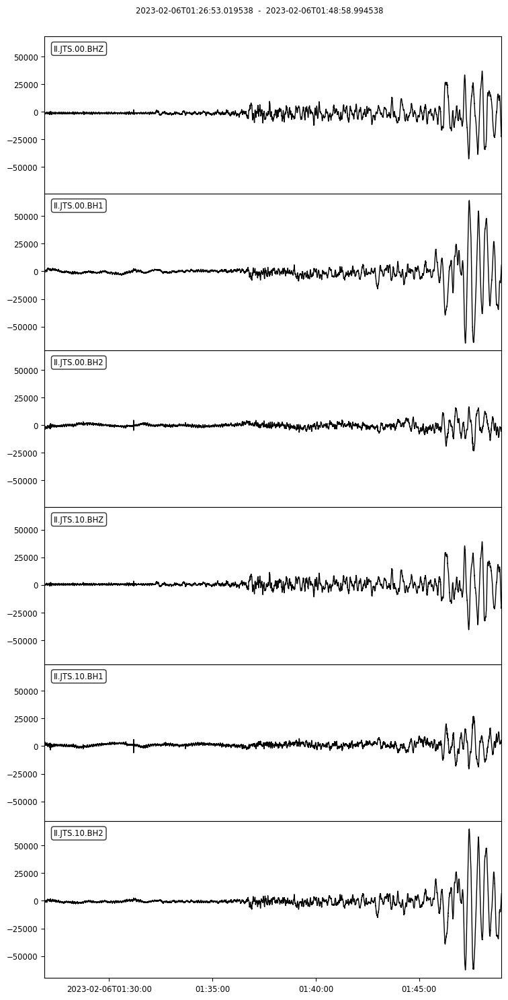

6 Trace(s) in Stream:
II.KAPI.00.BH1 | 2023-02-06T01:25:20.019538Z - 2023-02-06T01:46:00.994538Z | 40.0 Hz, 49640 samples
II.KAPI.00.BH2 | 2023-02-06T01:25:20.019538Z - 2023-02-06T01:46:00.994538Z | 40.0 Hz, 49640 samples
II.KAPI.00.BHZ | 2023-02-06T01:25:20.019538Z - 2023-02-06T01:46:00.994538Z | 40.0 Hz, 49640 samples
II.KAPI.10.BH1 | 2023-02-06T01:25:20.019538Z - 2023-02-06T01:46:00.994538Z | 40.0 Hz, 49640 samples
II.KAPI.10.BH2 | 2023-02-06T01:25:20.019538Z - 2023-02-06T01:46:00.994538Z | 40.0 Hz, 49640 samples
II.KAPI.10.BHZ | 2023-02-06T01:25:20.019538Z - 2023-02-06T01:46:00.994538Z | 40.0 Hz, 49640 samples


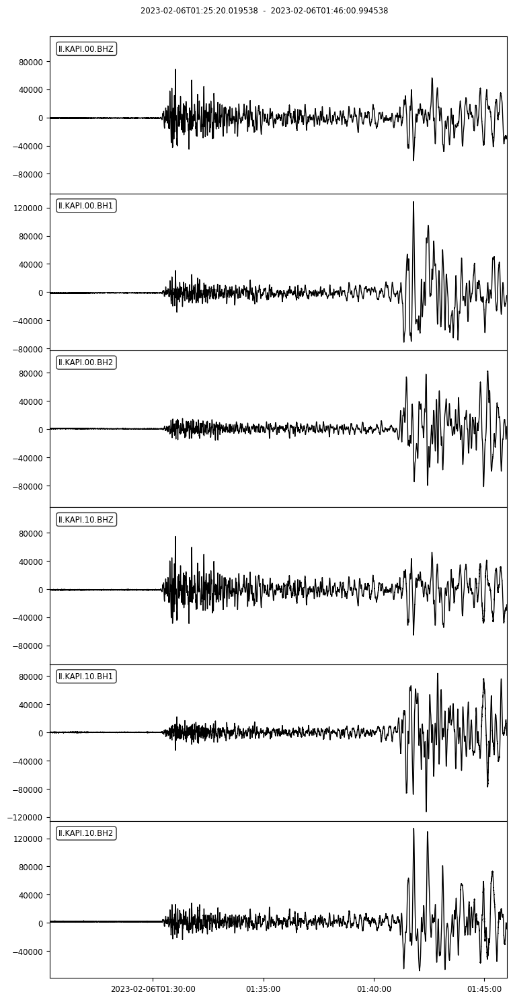

3 Trace(s) in Stream:
IU.KBL..BHE | 2023-02-06T01:18:06.020000Z - 2023-02-06T01:32:37.995000Z | 40.0 Hz, 34880 samples
IU.KBL..BHN | 2023-02-06T01:18:06.020000Z - 2023-02-06T01:32:37.995000Z | 40.0 Hz, 34880 samples
IU.KBL..BHZ | 2023-02-06T01:18:06.020000Z - 2023-02-06T01:32:37.995000Z | 40.0 Hz, 34880 samples


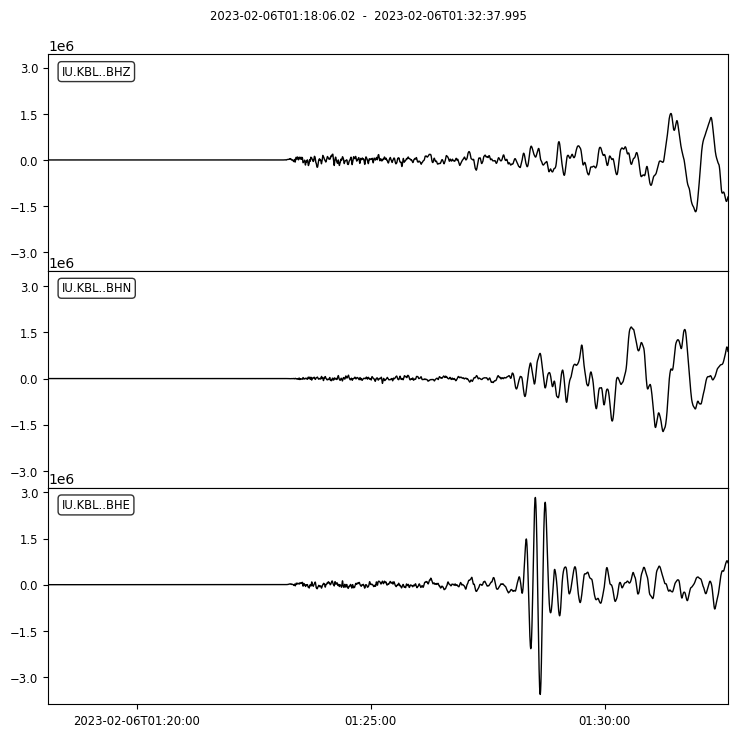

3 Trace(s) in Stream:
IU.KBS.00.BH1 | 2023-02-06T01:20:32.019538Z - 2023-02-06T01:36:57.994538Z | 40.0 Hz, 39440 samples
IU.KBS.00.BH2 | 2023-02-06T01:20:32.019539Z - 2023-02-06T01:36:57.994539Z | 40.0 Hz, 39440 samples
IU.KBS.00.BHZ | 2023-02-06T01:20:32.019539Z - 2023-02-06T01:36:57.994539Z | 40.0 Hz, 39440 samples


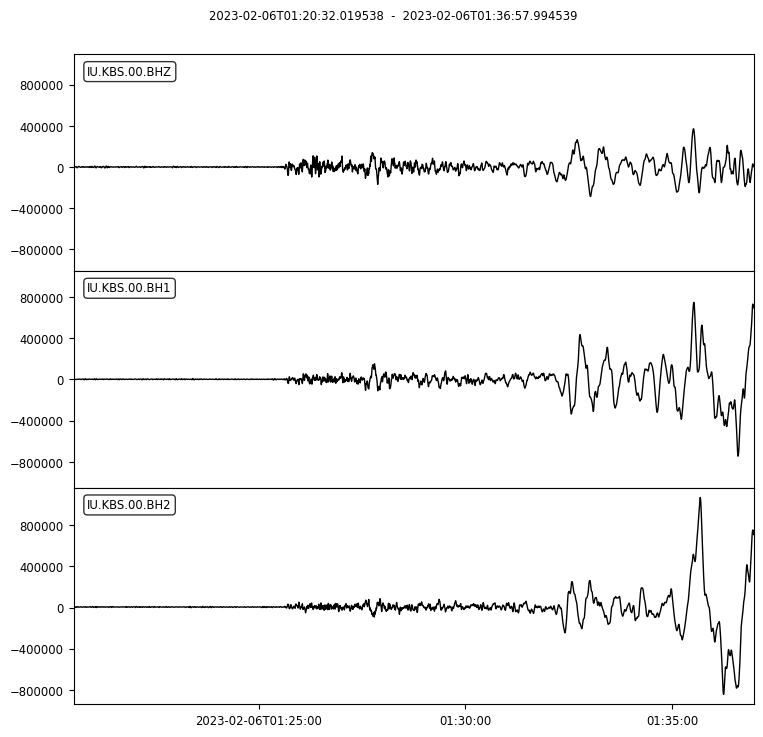

6 Trace(s) in Stream:
II.KDAK.00.BH1 | 2023-02-06T01:25:07.019538Z - 2023-02-06T01:45:34.994538Z | 40.0 Hz, 49120 samples
II.KDAK.00.BH2 | 2023-02-06T01:25:07.019538Z - 2023-02-06T01:45:34.994538Z | 40.0 Hz, 49120 samples
II.KDAK.00.BHZ | 2023-02-06T01:25:07.019538Z - 2023-02-06T01:45:34.994538Z | 40.0 Hz, 49120 samples
II.KDAK.10.BH1 | 2023-02-06T01:25:07.019538Z - 2023-02-06T01:45:34.994538Z | 40.0 Hz, 49120 samples
II.KDAK.10.BH2 | 2023-02-06T01:25:07.019538Z - 2023-02-06T01:45:34.994538Z | 40.0 Hz, 49120 samples
II.KDAK.10.BHZ | 2023-02-06T01:25:07.019538Z - 2023-02-06T01:45:34.994538Z | 40.0 Hz, 49120 samples


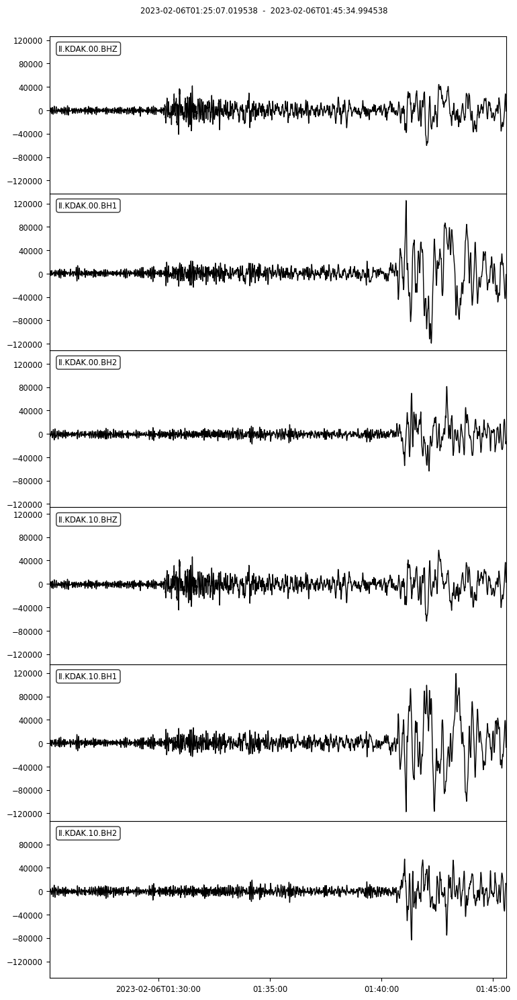

6 Trace(s) in Stream:
IU.KEV.00.BH1 | 2023-02-06T01:19:08.019538Z - 2023-02-06T01:34:27.969538Z | 20.0 Hz, 18400 samples
IU.KEV.00.BH2 | 2023-02-06T01:19:08.019538Z - 2023-02-06T01:34:27.969538Z | 20.0 Hz, 18400 samples
IU.KEV.00.BHZ | 2023-02-06T01:19:08.019538Z - 2023-02-06T01:34:27.969538Z | 20.0 Hz, 18400 samples
IU.KEV.10.BH1 | 2023-02-06T01:19:08.019538Z - 2023-02-06T01:34:27.994538Z | 40.0 Hz, 36800 samples
IU.KEV.10.BH2 | 2023-02-06T01:19:08.019538Z - 2023-02-06T01:34:27.994538Z | 40.0 Hz, 36800 samples
IU.KEV.10.BHZ | 2023-02-06T01:19:08.019539Z - 2023-02-06T01:34:27.994539Z | 40.0 Hz, 36800 samples


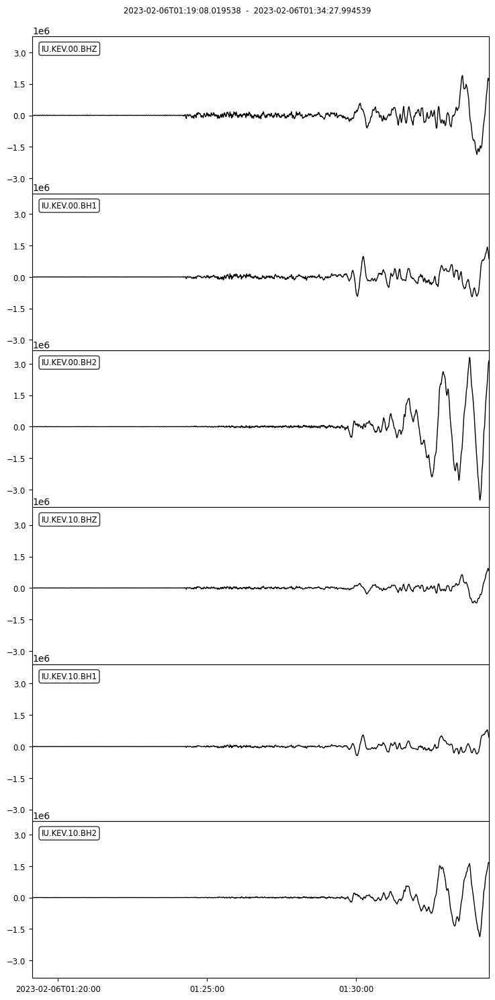

6 Trace(s) in Stream:
IU.KIEV.00.BH1 | 2023-02-06T01:16:00.019538Z - 2023-02-06T01:28:42.969538Z | 20.0 Hz, 15260 samples
IU.KIEV.00.BH2 | 2023-02-06T01:16:00.019536Z - 2023-02-06T01:28:42.969536Z | 20.0 Hz, 15260 samples
IU.KIEV.00.BHZ | 2023-02-06T01:16:00.019538Z - 2023-02-06T01:28:42.969538Z | 20.0 Hz, 15260 samples
IU.KIEV.10.BH1 | 2023-02-06T01:16:00.019538Z - 2023-02-06T01:28:42.994538Z | 40.0 Hz, 30520 samples
IU.KIEV.10.BH2 | 2023-02-06T01:16:00.019538Z - 2023-02-06T01:28:42.994538Z | 40.0 Hz, 30520 samples
IU.KIEV.10.BHZ | 2023-02-06T01:16:00.019538Z - 2023-02-06T01:28:42.994538Z | 40.0 Hz, 30520 samples


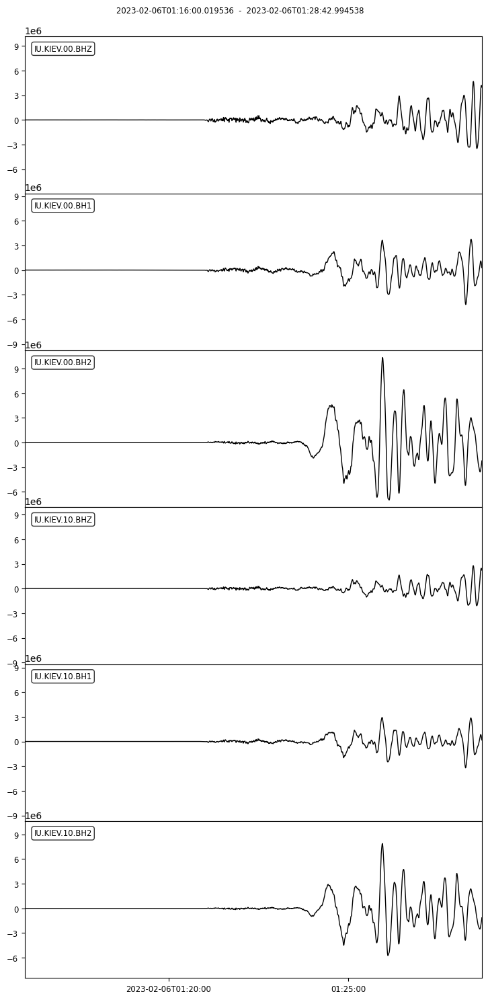

9 Trace(s) in Stream:
IU.KIP.00.BH1 | 2023-02-06T01:27:46.019536Z - 2023-02-06T01:50:36.994536Z | 40.0 Hz, 54840 samples
IU.KIP.00.BH2 | 2023-02-06T01:27:46.019538Z - 2023-02-06T01:50:36.994538Z | 40.0 Hz, 54840 samples
IU.KIP.00.BHZ | 2023-02-06T01:27:46.019538Z - 2023-02-06T01:50:36.994538Z | 40.0 Hz, 54840 samples
IU.KIP.10.BH1 | 2023-02-06T01:27:46.019538Z - 2023-02-06T01:50:36.994538Z | 40.0 Hz, 54840 samples
IU.KIP.10.BH2 | 2023-02-06T01:27:46.019536Z - 2023-02-06T01:50:36.994536Z | 40.0 Hz, 54840 samples
IU.KIP.10.BHZ | 2023-02-06T01:27:46.019538Z - 2023-02-06T01:50:36.994538Z | 40.0 Hz, 54840 samples
IU.KIP.60.BH1 | 2023-02-06T01:27:46.019538Z - 2023-02-06T01:50:36.969538Z | 20.0 Hz, 27420 samples
IU.KIP.60.BH2 | 2023-02-06T01:27:46.019538Z - 2023-02-06T01:50:36.969538Z | 20.0 Hz, 27420 samples
IU.KIP.60.BHZ | 2023-02-06T01:27:46.019536Z - 2023-02-06T01:50:36.969536Z | 20.0 Hz, 27420 samples


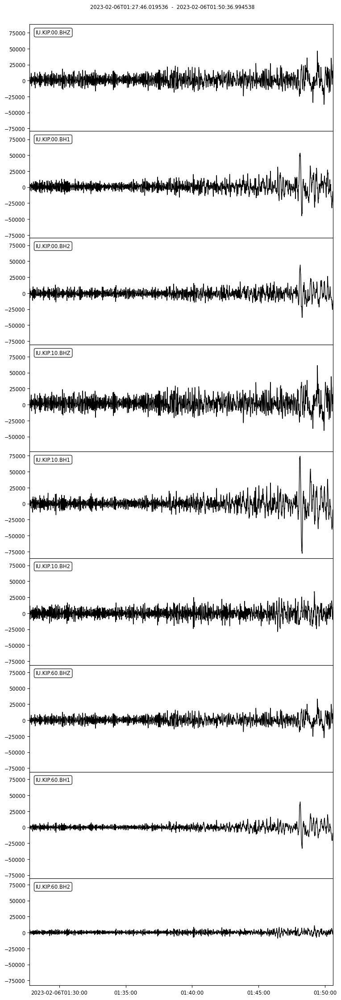

6 Trace(s) in Stream:
II.KIV.00.BH1 | 2023-02-06T01:14:30.019538Z - 2023-02-06T01:26:00.969538Z | 20.0 Hz, 13820 samples
II.KIV.00.BH2 | 2023-02-06T01:14:30.019538Z - 2023-02-06T01:26:00.969538Z | 20.0 Hz, 13820 samples
II.KIV.00.BHZ | 2023-02-06T01:14:30.019538Z - 2023-02-06T01:26:00.969538Z | 20.0 Hz, 13820 samples
II.KIV.10.BH1 | 2023-02-06T01:14:30.019538Z - 2023-02-06T01:26:00.994538Z | 40.0 Hz, 27640 samples
II.KIV.10.BH2 | 2023-02-06T01:14:30.019538Z - 2023-02-06T01:26:00.994538Z | 40.0 Hz, 27640 samples
II.KIV.10.BHZ | 2023-02-06T01:14:30.019538Z - 2023-02-06T01:26:00.994538Z | 40.0 Hz, 27640 samples


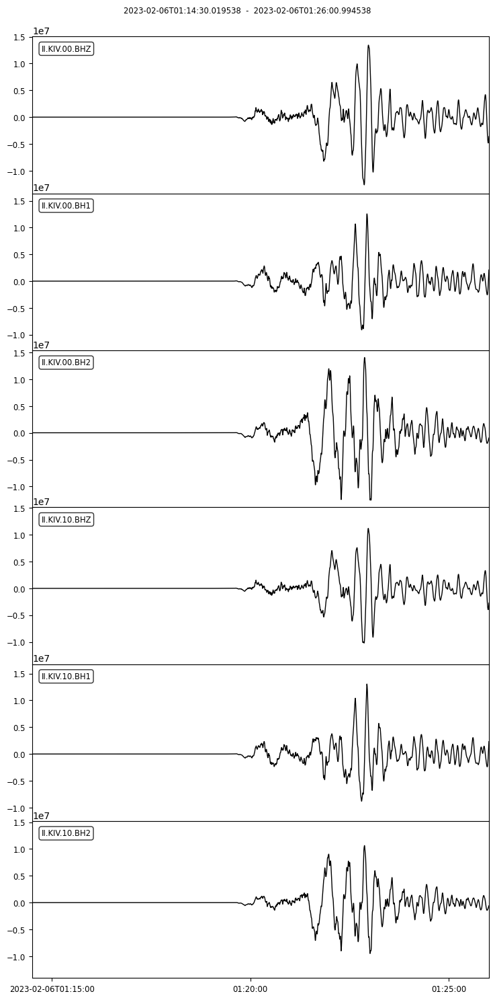

9 Trace(s) in Stream:
IU.KMBO.00.BH1 | 2023-02-06T01:19:54.019538Z - 2023-02-06T01:35:49.969538Z | 20.0 Hz, 19120 samples
IU.KMBO.00.BH2 | 2023-02-06T01:19:54.019538Z - 2023-02-06T01:35:49.969538Z | 20.0 Hz, 19120 samples
IU.KMBO.00.BHZ | 2023-02-06T01:19:54.019538Z - 2023-02-06T01:35:49.969538Z | 20.0 Hz, 19120 samples
IU.KMBO.10.BH1 | 2023-02-06T01:19:54.019538Z - 2023-02-06T01:35:49.994538Z | 40.0 Hz, 38240 samples
IU.KMBO.10.BH2 | 2023-02-06T01:19:54.019538Z - 2023-02-06T01:35:49.994538Z | 40.0 Hz, 38240 samples
IU.KMBO.10.BHZ | 2023-02-06T01:19:54.019538Z - 2023-02-06T01:35:49.994538Z | 40.0 Hz, 38240 samples
IU.KMBO.60.BH1 | 2023-02-06T01:19:54.019538Z - 2023-02-06T01:35:49.969538Z | 20.0 Hz, 19120 samples
IU.KMBO.60.BH2 | 2023-02-06T01:19:54.019538Z - 2023-02-06T01:35:49.969538Z | 20.0 Hz, 19120 samples
IU.KMBO.60.BHZ | 2023-02-06T01:19:54.019538Z - 2023-02-06T01:35:49.969538Z | 20.0 Hz, 19120 samples


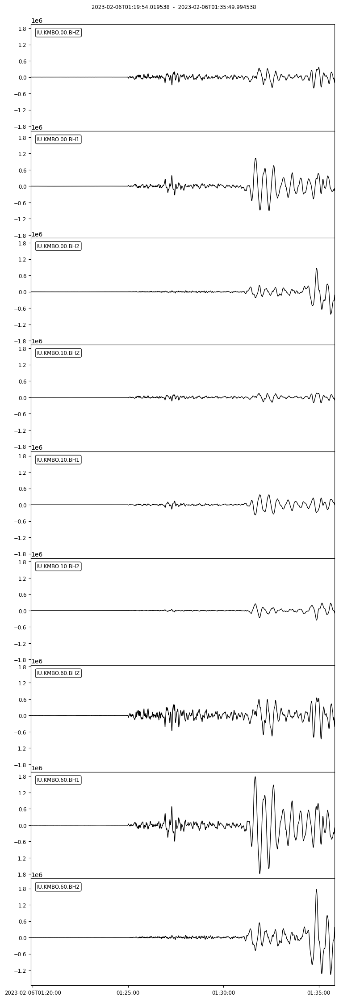

0 Trace(s) in Stream:

No waveform data found for station KMI 
 
 

0 Trace(s) in Stream:

No waveform data found for station KNTN 
 
 

3 Trace(s) in Stream:
IU.KONO.00.BH1 | 2023-02-06T01:18:29.019539Z - 2023-02-06T01:33:16.994539Z | 40.0 Hz, 35520 samples
IU.KONO.00.BH2 | 2023-02-06T01:18:29.019536Z - 2023-02-06T01:33:16.994536Z | 40.0 Hz, 35520 samples
IU.KONO.00.BHZ | 2023-02-06T01:18:29.019538Z - 2023-02-06T01:33:16.994538Z | 40.0 Hz, 35520 samples


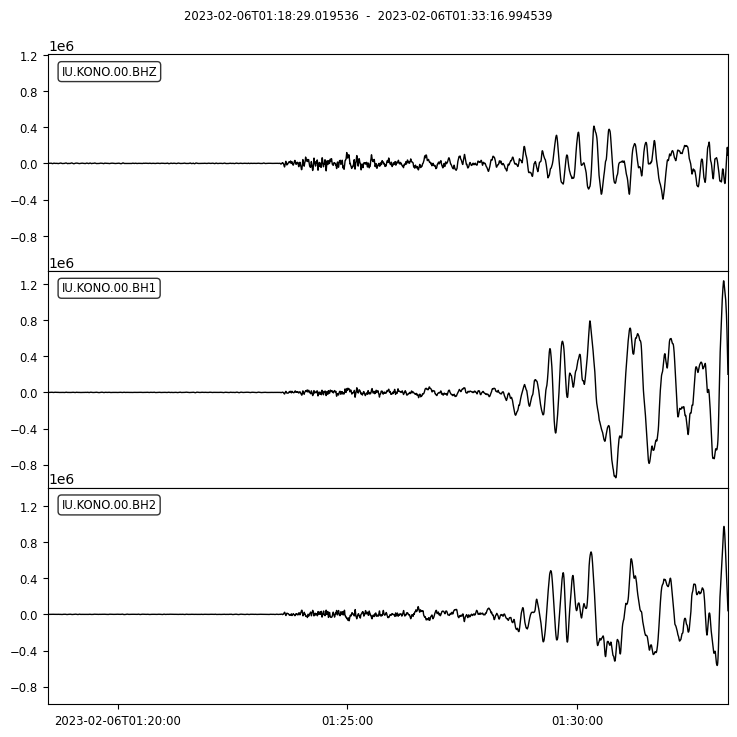

6 Trace(s) in Stream:
II.KURK.00.BH1 | 2023-02-06T01:19:02.019536Z - 2023-02-06T01:34:16.994536Z | 40.0 Hz, 36600 samples
II.KURK.00.BH2 | 2023-02-06T01:19:02.019536Z - 2023-02-06T01:34:16.994536Z | 40.0 Hz, 36600 samples
II.KURK.00.BHZ | 2023-02-06T01:19:02.019536Z - 2023-02-06T01:34:16.994536Z | 40.0 Hz, 36600 samples
II.KURK.10.BH1 | 2023-02-06T01:19:02.019536Z - 2023-02-06T01:34:16.994536Z | 40.0 Hz, 36600 samples
II.KURK.10.BH2 | 2023-02-06T01:19:02.019536Z - 2023-02-06T01:34:16.994536Z | 40.0 Hz, 36600 samples
II.KURK.10.BHZ | 2023-02-06T01:19:02.019538Z - 2023-02-06T01:34:16.994538Z | 40.0 Hz, 36600 samples


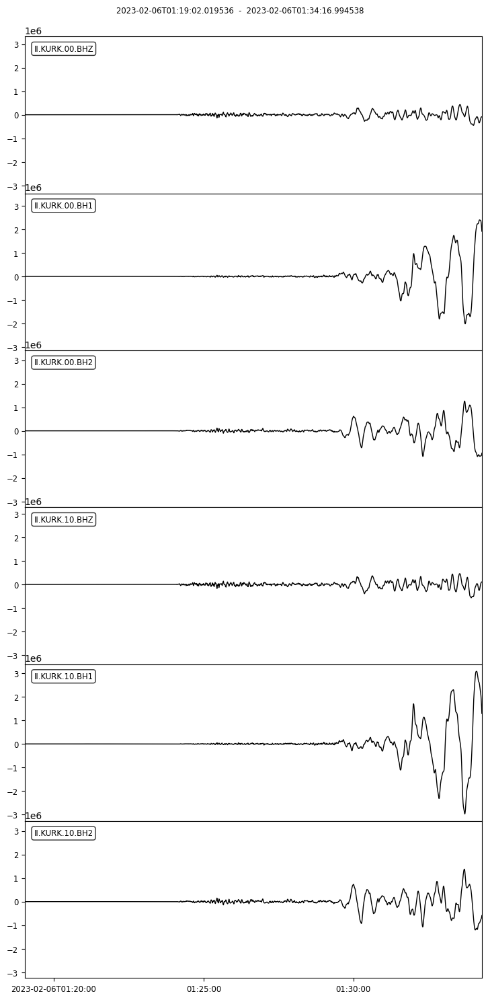

6 Trace(s) in Stream:
II.KWJN.00.BH1 | 2023-02-06T01:27:22.019538Z - 2023-02-06T01:49:52.994538Z | 40.0 Hz, 54040 samples
II.KWJN.00.BH2 | 2023-02-06T01:27:22.019538Z - 2023-02-06T01:49:52.994538Z | 40.0 Hz, 54040 samples
II.KWJN.00.BHZ | 2023-02-06T01:27:22.019538Z - 2023-02-06T01:49:52.994538Z | 40.0 Hz, 54040 samples
II.KWJN.10.BH1 | 2023-02-06T01:27:22.019538Z - 2023-02-06T01:49:52.994538Z | 40.0 Hz, 54040 samples
II.KWJN.10.BH2 | 2023-02-06T01:27:22.019538Z - 2023-02-06T01:49:52.994538Z | 40.0 Hz, 54040 samples
II.KWJN.10.BHZ | 2023-02-06T01:27:22.019538Z - 2023-02-06T01:49:52.994538Z | 40.0 Hz, 54040 samples


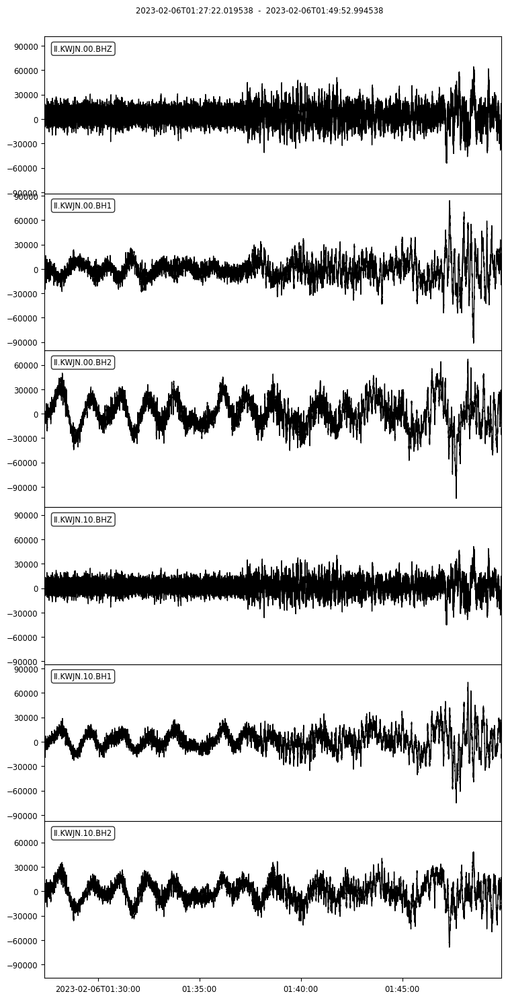

3 Trace(s) in Stream:
GT.LBTB.00.BHE | 2023-02-06T01:23:02.000000Z - 2023-02-06T01:41:34.000000Z | 40.0 Hz, 44481 samples
GT.LBTB.00.BHN | 2023-02-06T01:23:02.000000Z - 2023-02-06T01:41:34.000000Z | 40.0 Hz, 44481 samples
GT.LBTB.00.BHZ | 2023-02-06T01:23:02.000000Z - 2023-02-06T01:41:34.000000Z | 40.0 Hz, 44481 samples


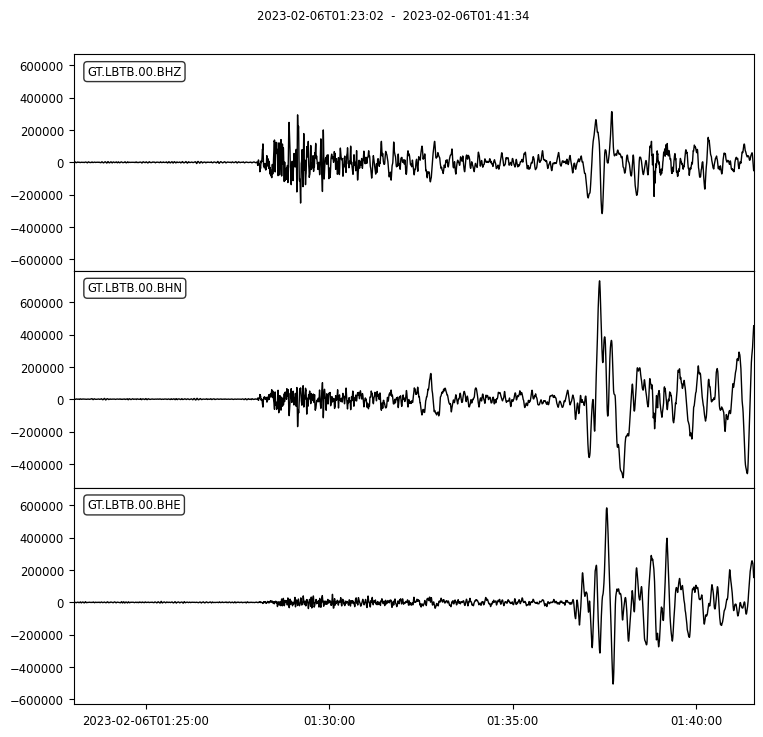

9 Trace(s) in Stream:
IU.LCO.00.BH1 | 2023-02-06T01:27:49.019538Z - 2023-02-06T01:50:42.969538Z | 20.0 Hz, 27480 samples
IU.LCO.00.BH2 | 2023-02-06T01:27:49.019538Z - 2023-02-06T01:50:42.969538Z | 20.0 Hz, 27480 samples
IU.LCO.00.BHZ | 2023-02-06T01:27:49.019538Z - 2023-02-06T01:50:42.969538Z | 20.0 Hz, 27480 samples
IU.LCO.10.BH1 | 2023-02-06T01:27:49.019539Z - 2023-02-06T01:50:42.994539Z | 40.0 Hz, 54960 samples
IU.LCO.10.BH2 | 2023-02-06T01:27:49.019538Z - 2023-02-06T01:50:42.994538Z | 40.0 Hz, 54960 samples
IU.LCO.10.BHZ | 2023-02-06T01:27:49.019538Z - 2023-02-06T01:50:42.994538Z | 40.0 Hz, 54960 samples
IU.LCO.60.BH1 | 2023-02-06T01:27:49.019538Z - 2023-02-06T01:50:42.994538Z | 40.0 Hz, 54960 samples
IU.LCO.60.BH2 | 2023-02-06T01:27:49.019538Z - 2023-02-06T01:50:42.994538Z | 40.0 Hz, 54960 samples
IU.LCO.60.BHZ | 2023-02-06T01:27:49.019538Z - 2023-02-06T01:50:42.994538Z | 40.0 Hz, 54960 samples


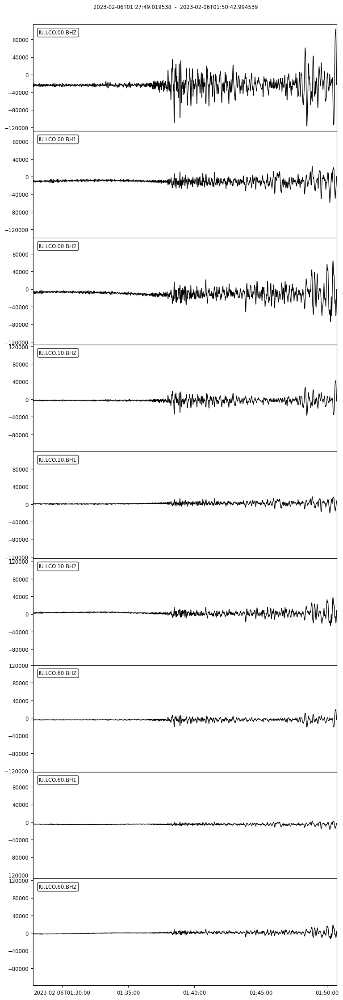

0 Trace(s) in Stream:

No waveform data found for station LSA 
 
 

6 Trace(s) in Stream:
IU.LSZ.00.BH1 | 2023-02-06T01:21:51.019538Z - 2023-02-06T01:39:22.969538Z | 20.0 Hz, 21040 samples
IU.LSZ.00.BH2 | 2023-02-06T01:21:51.019538Z - 2023-02-06T01:39:22.969538Z | 20.0 Hz, 21040 samples
IU.LSZ.00.BHZ | 2023-02-06T01:21:51.019538Z - 2023-02-06T01:39:22.969538Z | 20.0 Hz, 21040 samples
IU.LSZ.10.BH1 | 2023-02-06T01:21:51.019538Z - 2023-02-06T01:39:22.994538Z | 40.0 Hz, 42080 samples
IU.LSZ.10.BH2 | 2023-02-06T01:21:51.019538Z - 2023-02-06T01:39:22.994538Z | 40.0 Hz, 42080 samples
IU.LSZ.10.BHZ | 2023-02-06T01:21:51.019538Z - 2023-02-06T01:39:22.994538Z | 40.0 Hz, 42080 samples


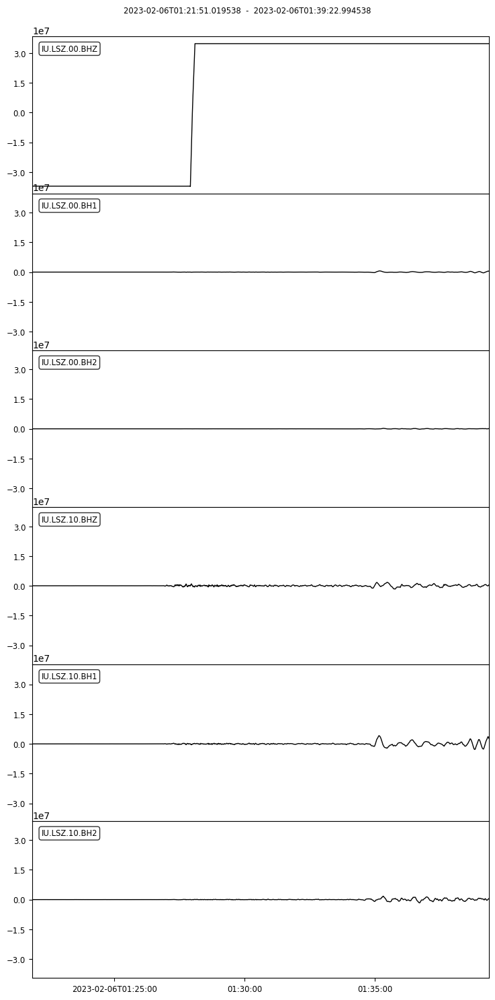

6 Trace(s) in Stream:
II.LVZ.00.BH1 | 2023-02-06T01:18:48.019538Z - 2023-02-06T01:33:51.969538Z | 20.0 Hz, 18080 samples
II.LVZ.00.BH2 | 2023-02-06T01:18:48.019538Z - 2023-02-06T01:33:51.969538Z | 20.0 Hz, 18080 samples
II.LVZ.00.BHZ | 2023-02-06T01:18:48.019538Z - 2023-02-06T01:33:51.969538Z | 20.0 Hz, 18080 samples
II.LVZ.10.BH1 | 2023-02-06T01:18:48.019538Z - 2023-02-06T01:33:51.994538Z | 40.0 Hz, 36160 samples
II.LVZ.10.BH2 | 2023-02-06T01:18:48.019538Z - 2023-02-06T01:33:51.994538Z | 40.0 Hz, 36160 samples
II.LVZ.10.BHZ | 2023-02-06T01:18:48.019538Z - 2023-02-06T01:33:51.994538Z | 40.0 Hz, 36160 samples


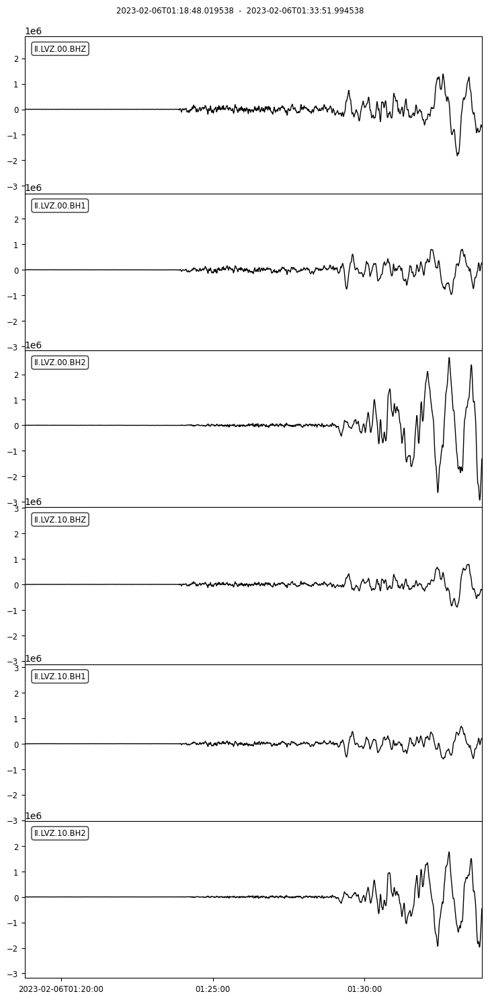

6 Trace(s) in Stream:
IU.MA2.00.BH1 | 2023-02-06T01:23:39.019538Z - 2023-02-06T01:42:43.969538Z | 20.0 Hz, 22900 samples
IU.MA2.00.BH2 | 2023-02-06T01:23:39.019539Z - 2023-02-06T01:42:43.969539Z | 20.0 Hz, 22900 samples
IU.MA2.00.BHZ | 2023-02-06T01:23:39.019538Z - 2023-02-06T01:42:43.969538Z | 20.0 Hz, 22900 samples
IU.MA2.10.BH1 | 2023-02-06T01:23:39.019538Z - 2023-02-06T01:42:43.994538Z | 40.0 Hz, 45800 samples
IU.MA2.10.BH2 | 2023-02-06T01:23:39.019538Z - 2023-02-06T01:42:43.994538Z | 40.0 Hz, 45800 samples
IU.MA2.10.BHZ | 2023-02-06T01:23:39.019538Z - 2023-02-06T01:42:43.994538Z | 40.0 Hz, 45800 samples


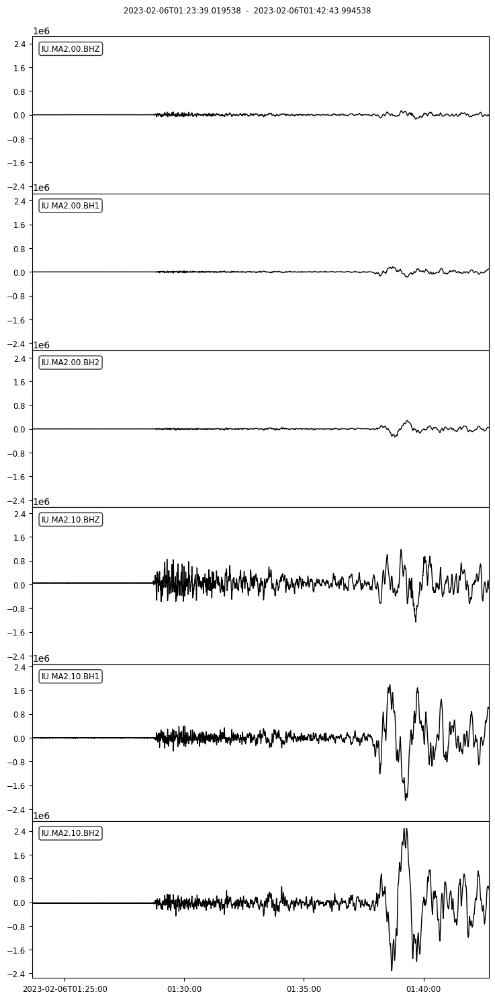

6 Trace(s) in Stream:
IU.MACI.00.BH1 | 2023-02-06T01:20:51.019536Z - 2023-02-06T01:37:32.994536Z | 40.0 Hz, 40080 samples
IU.MACI.00.BH2 | 2023-02-06T01:20:51.019538Z - 2023-02-06T01:37:32.994538Z | 40.0 Hz, 40080 samples
IU.MACI.00.BHZ | 2023-02-06T01:20:51.019536Z - 2023-02-06T01:37:32.994536Z | 40.0 Hz, 40080 samples
IU.MACI.10.BH1 | 2023-02-06T01:20:51.019538Z - 2023-02-06T01:37:32.994538Z | 40.0 Hz, 40080 samples
IU.MACI.10.BH2 | 2023-02-06T01:20:51.019538Z - 2023-02-06T01:37:32.994538Z | 40.0 Hz, 40080 samples
IU.MACI.10.BHZ | 2023-02-06T01:20:51.019538Z - 2023-02-06T01:37:32.994538Z | 40.0 Hz, 40080 samples


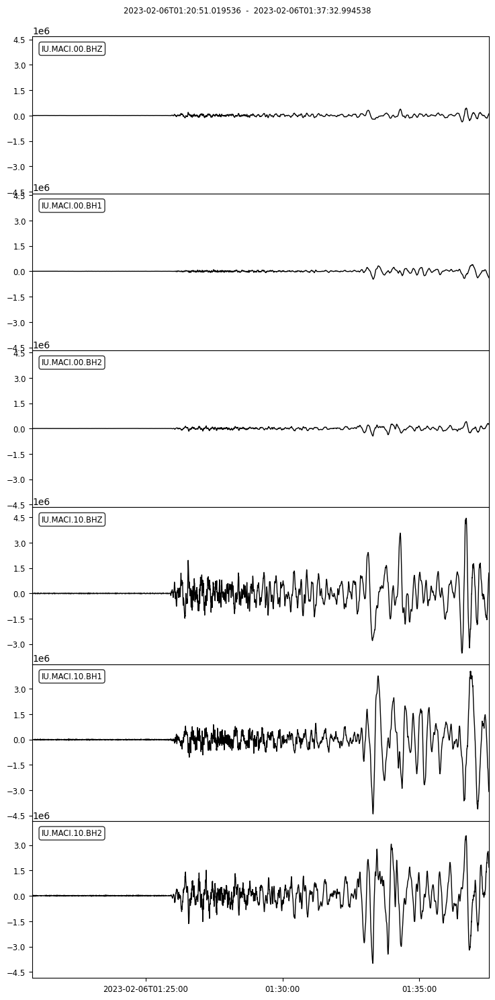

9 Trace(s) in Stream:
IU.MAJO.00.BH1 | 2023-02-06T01:24:23.019538Z - 2023-02-06T01:44:07.969538Z | 20.0 Hz, 23700 samples
IU.MAJO.00.BH2 | 2023-02-06T01:24:23.019538Z - 2023-02-06T01:44:07.969538Z | 20.0 Hz, 23700 samples
IU.MAJO.00.BHZ | 2023-02-06T01:24:23.019538Z - 2023-02-06T01:44:07.969538Z | 20.0 Hz, 23700 samples
IU.MAJO.10.BH1 | 2023-02-06T01:24:23.019538Z - 2023-02-06T01:44:07.994538Z | 40.0 Hz, 47400 samples
IU.MAJO.10.BH2 | 2023-02-06T01:24:23.019538Z - 2023-02-06T01:44:07.994538Z | 40.0 Hz, 47400 samples
IU.MAJO.10.BHZ | 2023-02-06T01:24:23.019538Z - 2023-02-06T01:44:07.994538Z | 40.0 Hz, 47400 samples
IU.MAJO.60.BH1 | 2023-02-06T01:24:23.019538Z - 2023-02-06T01:44:07.994538Z | 40.0 Hz, 47400 samples
IU.MAJO.60.BH2 | 2023-02-06T01:24:23.019538Z - 2023-02-06T01:44:07.994538Z | 40.0 Hz, 47400 samples
IU.MAJO.60.BHZ | 2023-02-06T01:24:23.019538Z - 2023-02-06T01:44:07.994538Z | 40.0 Hz, 47400 samples


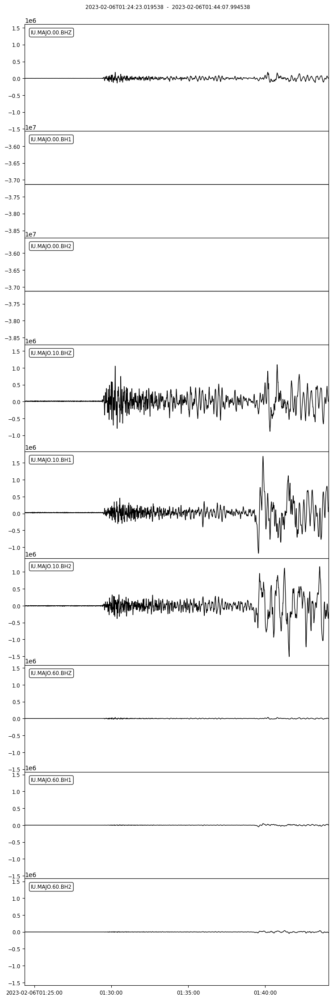

3 Trace(s) in Stream:
IU.MAKZ.00.BH1 | 2023-02-06T01:19:19.019538Z - 2023-02-06T01:34:46.994538Z | 40.0 Hz, 37120 samples
IU.MAKZ.00.BH2 | 2023-02-06T01:19:19.019538Z - 2023-02-06T01:34:46.994538Z | 40.0 Hz, 37120 samples
IU.MAKZ.00.BHZ | 2023-02-06T01:19:19.019538Z - 2023-02-06T01:34:46.994538Z | 40.0 Hz, 37120 samples


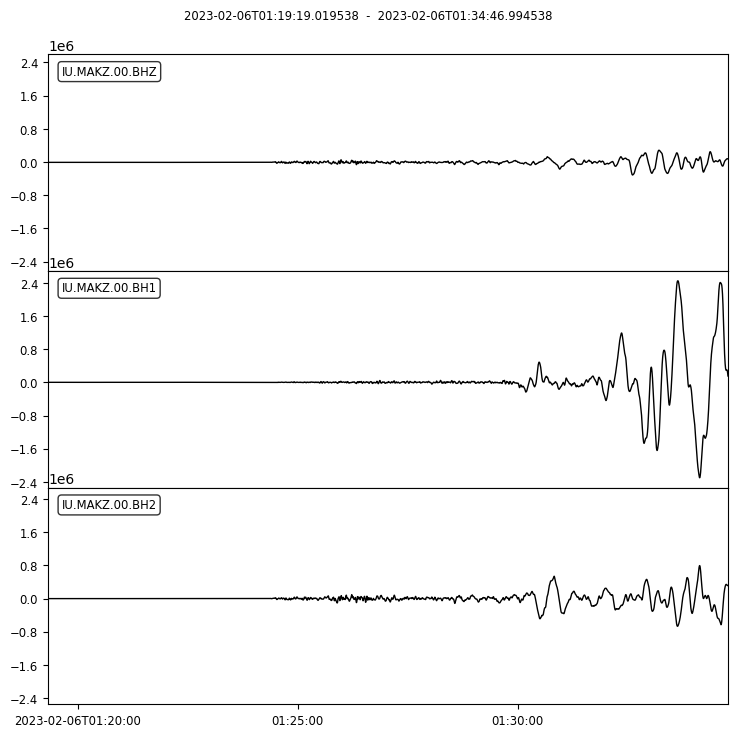

6 Trace(s) in Stream:
II.MBAR.00.BH1 | 2023-02-06T01:19:54.019538Z - 2023-02-06T01:35:48.994538Z | 40.0 Hz, 38200 samples
II.MBAR.00.BH2 | 2023-02-06T01:19:54.019538Z - 2023-02-06T01:35:48.994538Z | 40.0 Hz, 38200 samples
II.MBAR.00.BHZ | 2023-02-06T01:19:54.019538Z - 2023-02-06T01:35:48.994538Z | 40.0 Hz, 38200 samples
II.MBAR.10.BH1 | 2023-02-06T01:19:54.019538Z - 2023-02-06T01:35:48.994538Z | 40.0 Hz, 38200 samples
II.MBAR.10.BH2 | 2023-02-06T01:19:54.019538Z - 2023-02-06T01:35:48.994538Z | 40.0 Hz, 38200 samples
II.MBAR.10.BHZ | 2023-02-06T01:19:54.019538Z - 2023-02-06T01:35:48.994538Z | 40.0 Hz, 38200 samples


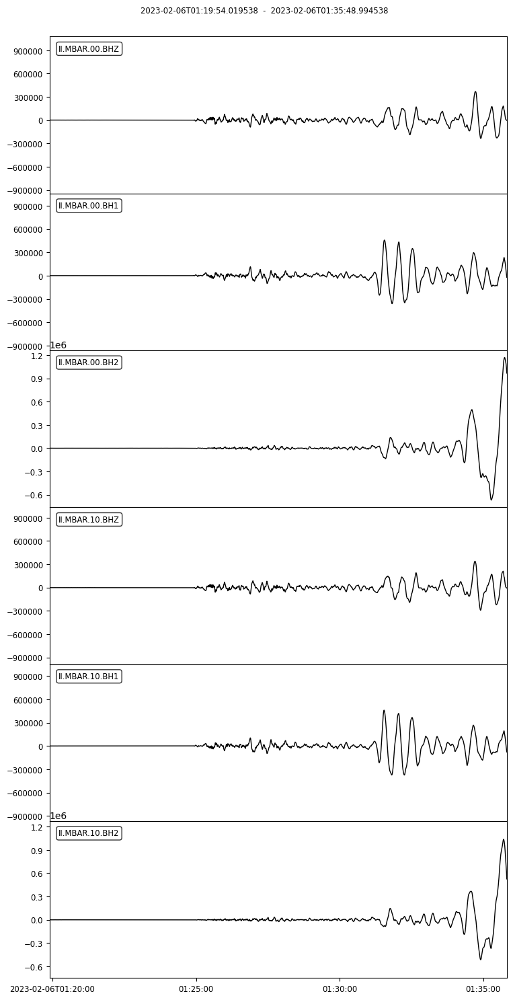

6 Trace(s) in Stream:
IU.MBWA.00.BH1 | 2023-02-06T01:26:06.019536Z - 2023-02-06T01:47:28.994536Z | 40.0 Hz, 51320 samples
IU.MBWA.00.BH2 | 2023-02-06T01:26:06.019536Z - 2023-02-06T01:47:28.994536Z | 40.0 Hz, 51320 samples
IU.MBWA.00.BHZ | 2023-02-06T01:26:06.019538Z - 2023-02-06T01:47:28.994538Z | 40.0 Hz, 51320 samples
IU.MBWA.10.BH1 | 2023-02-06T01:26:06.019538Z - 2023-02-06T01:47:28.994538Z | 40.0 Hz, 51320 samples
IU.MBWA.10.BH2 | 2023-02-06T01:26:06.019538Z - 2023-02-06T01:47:28.994538Z | 40.0 Hz, 51320 samples
IU.MBWA.10.BHZ | 2023-02-06T01:26:06.019538Z - 2023-02-06T01:47:28.994538Z | 40.0 Hz, 51320 samples


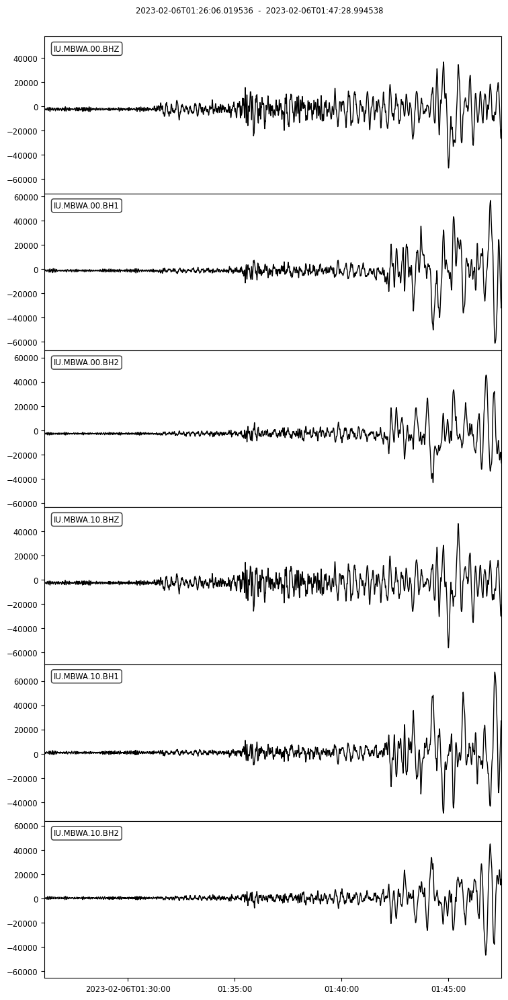

3 Trace(s) in Stream:
AU.MCQ.00.BHE | 2023-02-06T01:29:05.000000Z - 2023-02-06T01:53:05.000000Z | 40.0 Hz, 57601 samples
AU.MCQ.00.BHN | 2023-02-06T01:29:05.000000Z - 2023-02-06T01:53:05.000000Z | 40.0 Hz, 57601 samples
AU.MCQ.00.BHZ | 2023-02-06T01:29:05.000000Z - 2023-02-06T01:53:05.000000Z | 40.0 Hz, 57601 samples


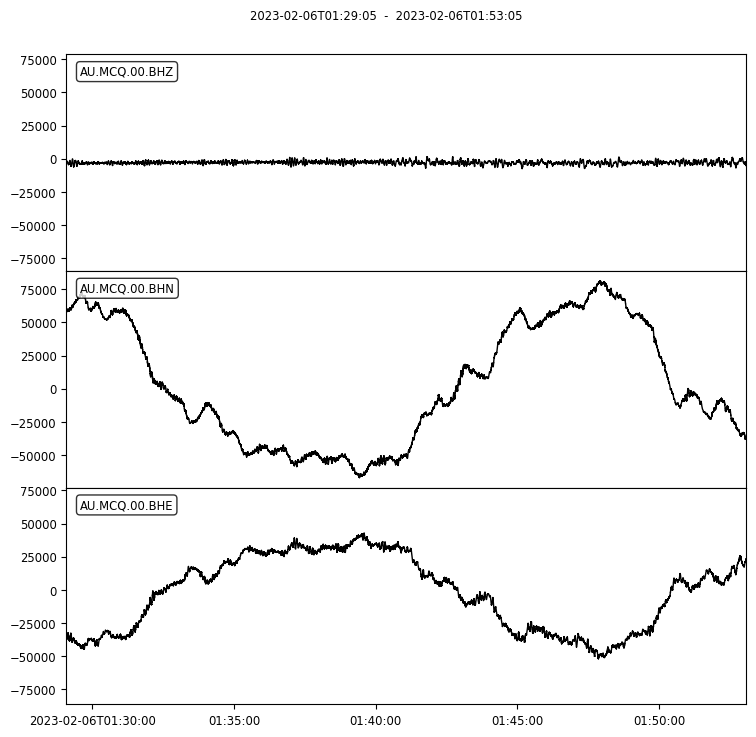

6 Trace(s) in Stream:
IC.MDJ.00.BH1 | 2023-02-06T01:23:23.026672Z - 2023-02-06T01:42:13.976672Z | 20.0 Hz, 22620 samples
IC.MDJ.00.BH2 | 2023-02-06T01:23:23.026672Z - 2023-02-06T01:42:13.976672Z | 20.0 Hz, 22620 samples
IC.MDJ.00.BHZ | 2023-02-06T01:23:23.026672Z - 2023-02-06T01:42:13.976672Z | 20.0 Hz, 22620 samples
IC.MDJ.60.BH1 | 2023-02-06T01:23:23.007530Z - 2023-02-06T01:42:13.982530Z | 40.0 Hz, 45240 samples
IC.MDJ.60.BH2 | 2023-02-06T01:23:23.007530Z - 2023-02-06T01:42:13.982530Z | 40.0 Hz, 45240 samples
IC.MDJ.60.BHZ | 2023-02-06T01:23:23.007530Z - 2023-02-06T01:42:13.982530Z | 40.0 Hz, 45240 samples


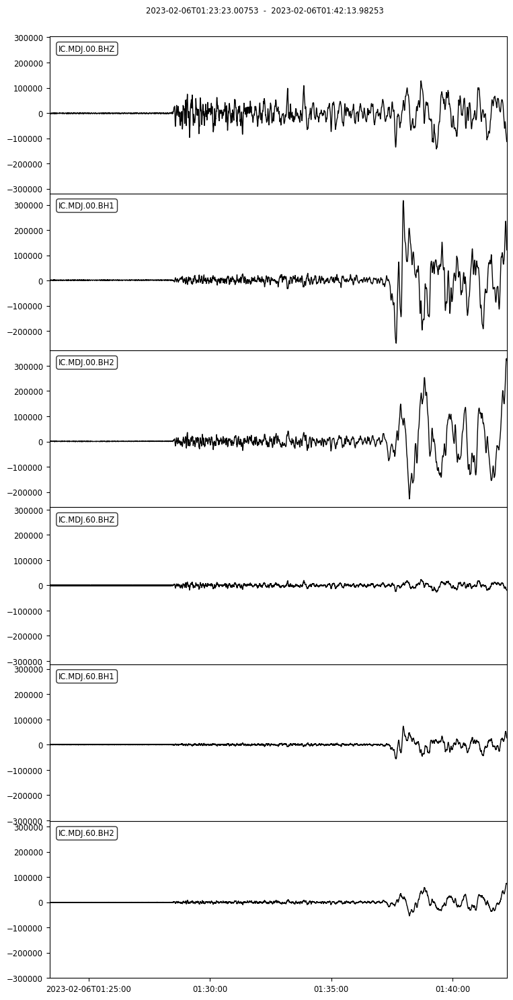

3 Trace(s) in Stream:
IU.MIDW.00.BH1 | 2023-02-06T01:26:50.019538Z - 2023-02-06T01:48:51.994538Z | 40.0 Hz, 52880 samples
IU.MIDW.00.BH2 | 2023-02-06T01:26:50.019538Z - 2023-02-06T01:48:51.994538Z | 40.0 Hz, 52880 samples
IU.MIDW.00.BHZ | 2023-02-06T01:26:50.019538Z - 2023-02-06T01:48:51.994538Z | 40.0 Hz, 52880 samples


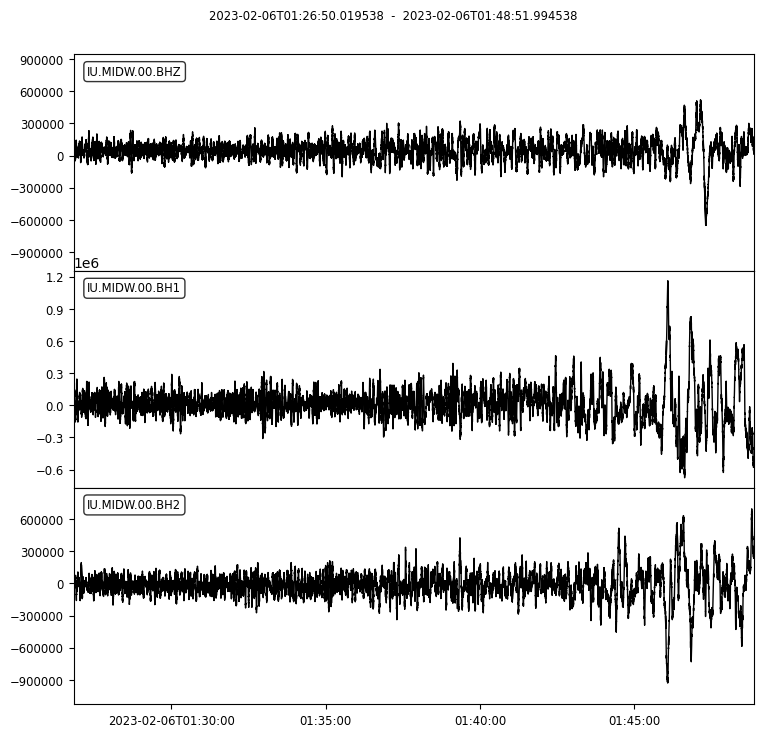

3 Trace(s) in Stream:
II.MSEY.10.BH1 | 2023-02-06T01:20:51.019539Z - 2023-02-06T01:37:31.994539Z | 40.0 Hz, 40040 samples
II.MSEY.10.BH2 | 2023-02-06T01:20:51.019539Z - 2023-02-06T01:37:31.994539Z | 40.0 Hz, 40040 samples
II.MSEY.10.BHZ | 2023-02-06T01:20:51.019539Z - 2023-02-06T01:37:31.994539Z | 40.0 Hz, 40040 samples


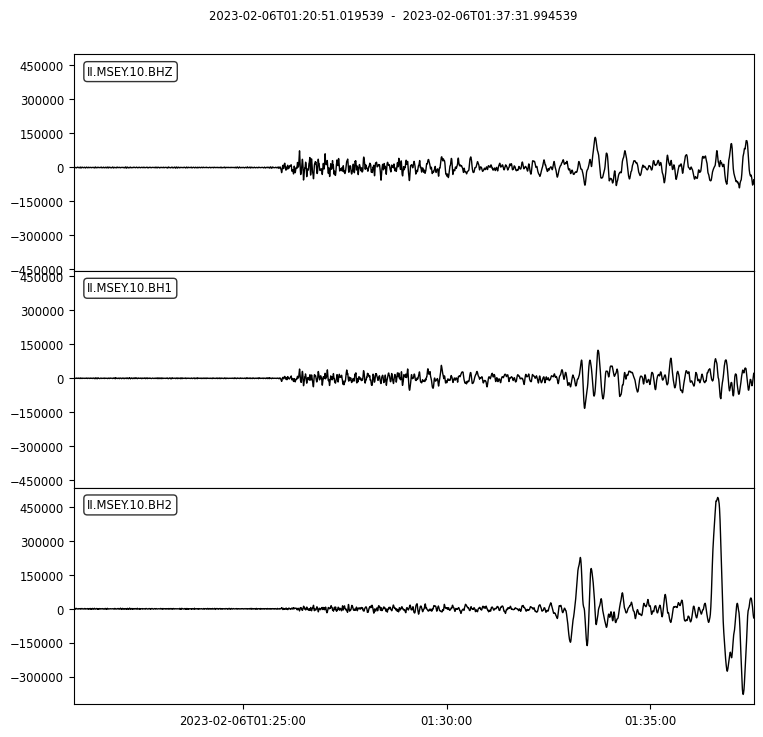

6 Trace(s) in Stream:
II.MSVF.00.BH1 | 2023-02-06T01:29:19.019538Z - 2023-02-06T01:53:31.994538Z | 40.0 Hz, 58120 samples
II.MSVF.00.BH2 | 2023-02-06T01:29:19.019538Z - 2023-02-06T01:53:31.994538Z | 40.0 Hz, 58120 samples
II.MSVF.00.BHZ | 2023-02-06T01:29:19.019538Z - 2023-02-06T01:53:31.994538Z | 40.0 Hz, 58120 samples
II.MSVF.10.BH1 | 2023-02-06T01:29:19.019538Z - 2023-02-06T01:53:31.994538Z | 40.0 Hz, 58120 samples
II.MSVF.10.BH2 | 2023-02-06T01:29:19.019538Z - 2023-02-06T01:53:31.994538Z | 40.0 Hz, 58120 samples
II.MSVF.10.BHZ | 2023-02-06T01:29:19.019538Z - 2023-02-06T01:53:31.994538Z | 40.0 Hz, 58120 samples


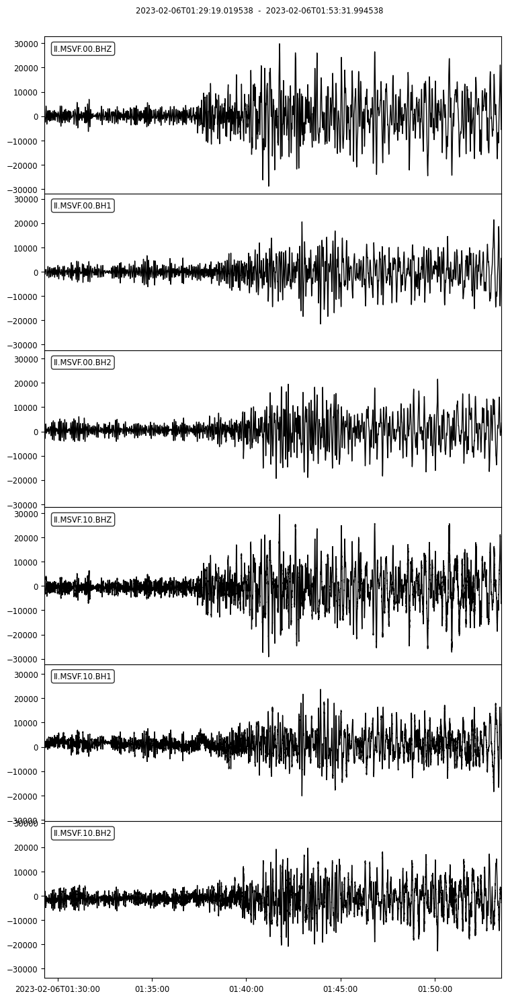

3 Trace(s) in Stream:
CU.MTDJ.00.BH1 | 2023-02-06T01:26:06.024998Z - 2023-02-06T01:47:28.999998Z | 40.0 Hz, 51320 samples
CU.MTDJ.00.BH2 | 2023-02-06T01:26:06.000000Z - 2023-02-06T01:47:29.000000Z | 40.0 Hz, 51321 samples
CU.MTDJ.00.BHZ | 2023-02-06T01:26:06.024998Z - 2023-02-06T01:47:28.999998Z | 40.0 Hz, 51320 samples


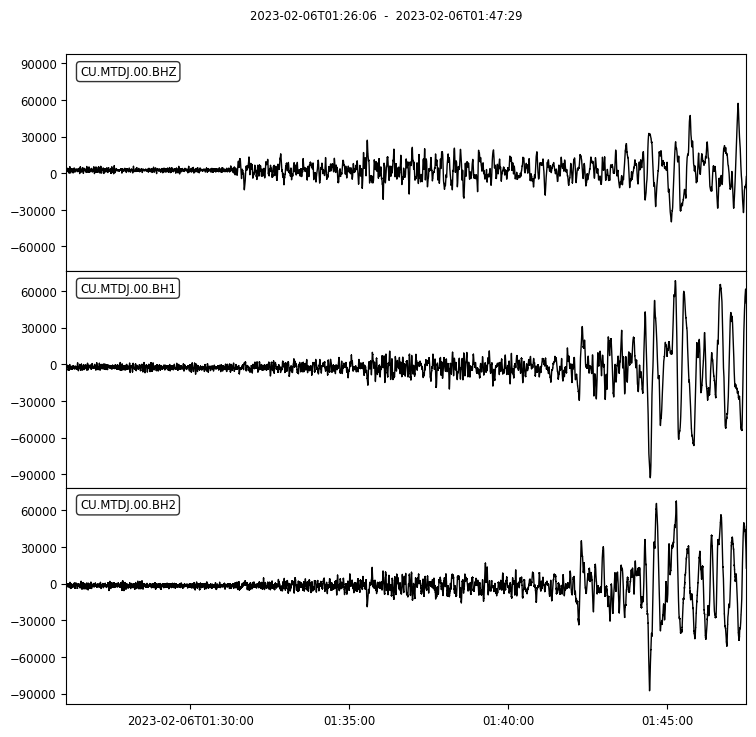

3 Trace(s) in Stream:
II.NIL.10.BH1 | 2023-02-06T01:18:38.019539Z - 2023-02-06T01:33:33.994539Z | 40.0 Hz, 35840 samples
II.NIL.10.BH2 | 2023-02-06T01:18:38.019539Z - 2023-02-06T01:33:33.994539Z | 40.0 Hz, 35840 samples
II.NIL.10.BHZ | 2023-02-06T01:18:38.019539Z - 2023-02-06T01:33:33.994539Z | 40.0 Hz, 35840 samples


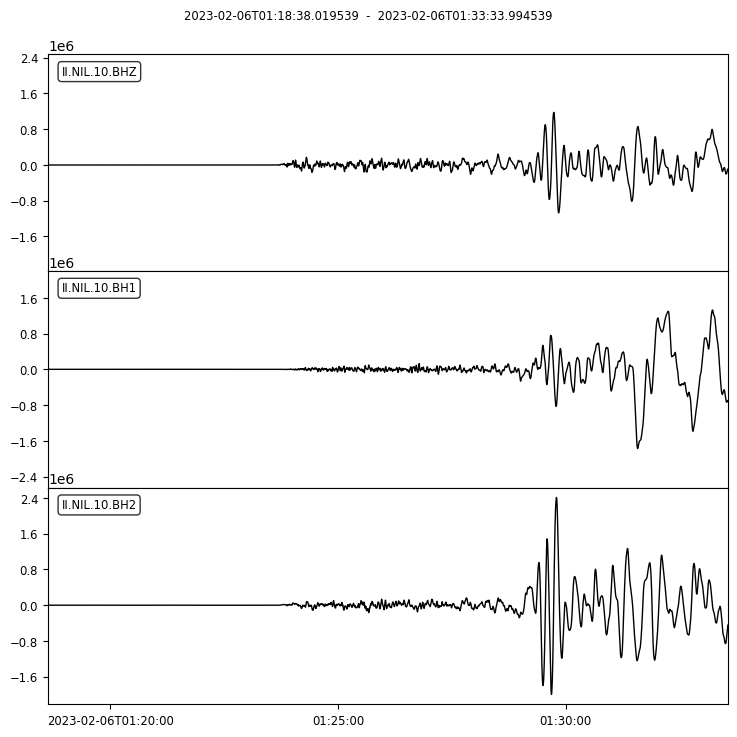

6 Trace(s) in Stream:
II.NNA.00.BH1 | 2023-02-06T01:27:30.019538Z - 2023-02-06T01:50:07.969538Z | 20.0 Hz, 27160 samples
II.NNA.00.BH2 | 2023-02-06T01:27:30.019538Z - 2023-02-06T01:50:07.969538Z | 20.0 Hz, 27160 samples
II.NNA.00.BHZ | 2023-02-06T01:27:30.019538Z - 2023-02-06T01:50:07.969538Z | 20.0 Hz, 27160 samples
II.NNA.10.BH1 | 2023-02-06T01:27:30.019538Z - 2023-02-06T01:50:07.994538Z | 40.0 Hz, 54320 samples
II.NNA.10.BH2 | 2023-02-06T01:27:30.019538Z - 2023-02-06T01:50:07.994538Z | 40.0 Hz, 54320 samples
II.NNA.10.BHZ | 2023-02-06T01:27:30.019538Z - 2023-02-06T01:50:07.994538Z | 40.0 Hz, 54320 samples


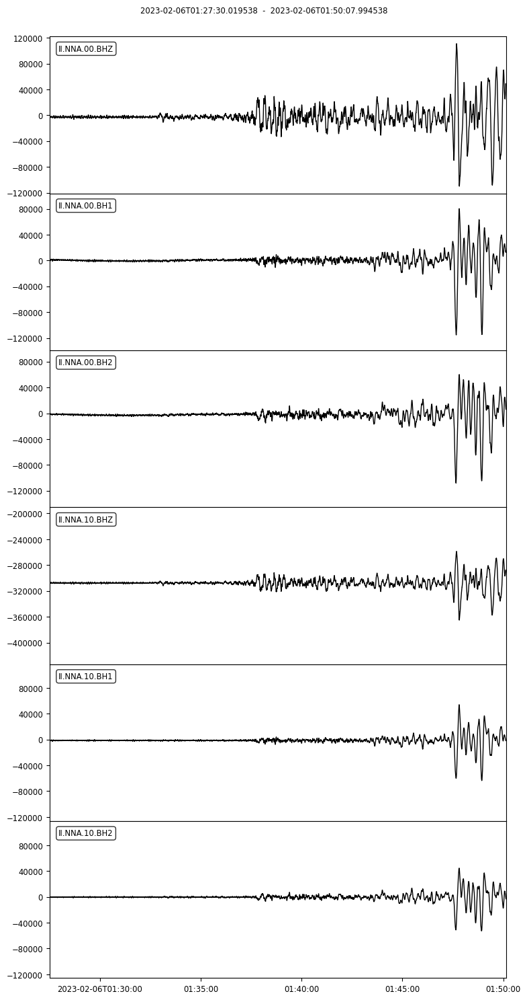

3 Trace(s) in Stream:
IM.NV31..BHE | 2023-02-06T01:26:23.000000Z - 2023-02-06T01:48:01.000000Z | 40.0 Hz, 51921 samples
IM.NV31..BHN | 2023-02-06T01:26:23.000000Z - 2023-02-06T01:48:01.000000Z | 40.0 Hz, 51921 samples
IM.NV31..BHZ | 2023-02-06T01:26:23.000000Z - 2023-02-06T01:48:01.000000Z | 40.0 Hz, 51921 samples


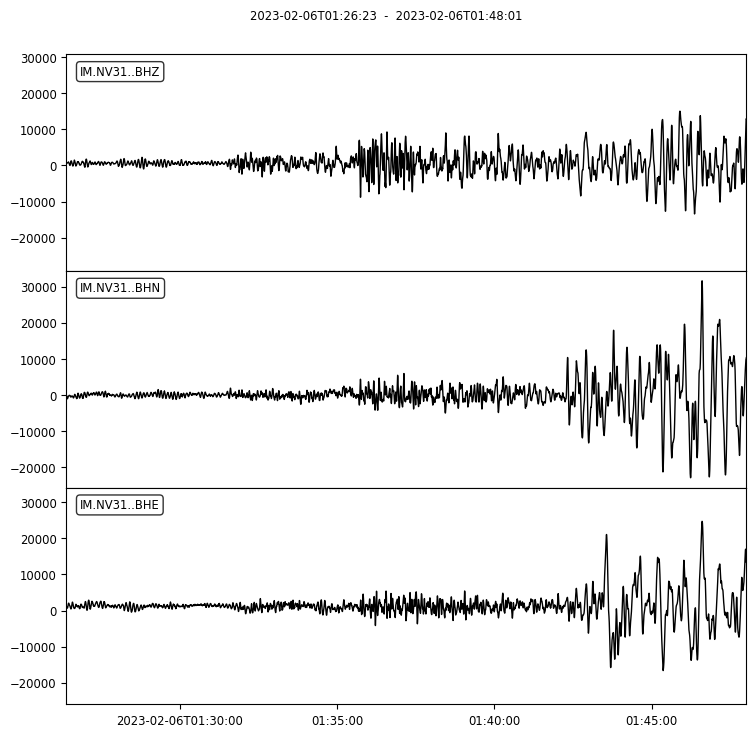

6 Trace(s) in Stream:
IU.NWAO.00.BH1 | 2023-02-06T01:26:29.019539Z - 2023-02-06T01:48:12.994539Z | 40.0 Hz, 52160 samples
IU.NWAO.00.BH2 | 2023-02-06T01:26:29.019539Z - 2023-02-06T01:48:12.994539Z | 40.0 Hz, 52160 samples
IU.NWAO.00.BHZ | 2023-02-06T01:26:29.019539Z - 2023-02-06T01:48:12.994539Z | 40.0 Hz, 52160 samples
IU.NWAO.10.BH1 | 2023-02-06T01:26:29.019536Z - 2023-02-06T01:48:12.994536Z | 40.0 Hz, 52160 samples
IU.NWAO.10.BH2 | 2023-02-06T01:26:29.019538Z - 2023-02-06T01:48:12.994538Z | 40.0 Hz, 52160 samples
IU.NWAO.10.BHZ | 2023-02-06T01:26:29.019536Z - 2023-02-06T01:48:12.994536Z | 40.0 Hz, 52160 samples


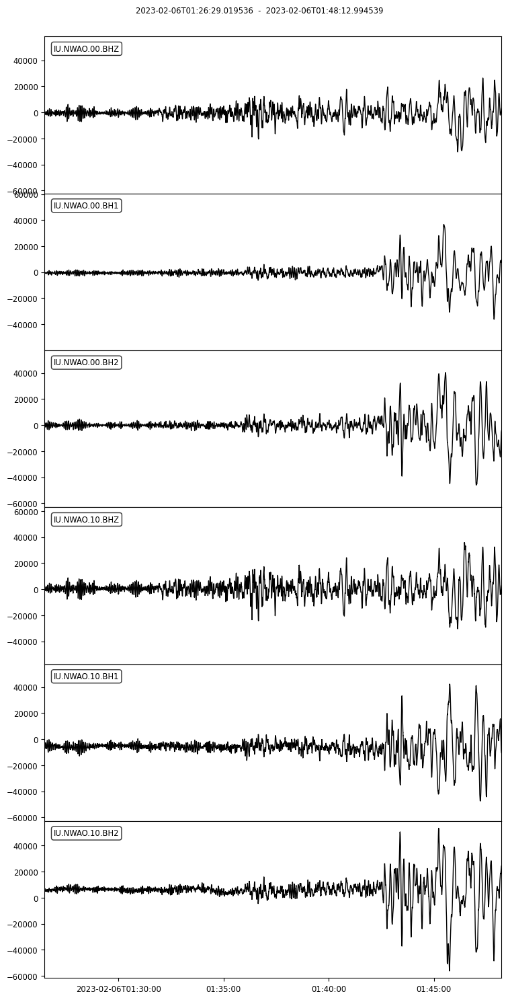

6 Trace(s) in Stream:
II.OBN.00.BH1 | 2023-02-06T01:16:42.019538Z - 2023-02-06T01:30:02.994538Z | 40.0 Hz, 32040 samples
II.OBN.00.BH2 | 2023-02-06T01:16:42.019538Z - 2023-02-06T01:30:02.994538Z | 40.0 Hz, 32040 samples
II.OBN.00.BHZ | 2023-02-06T01:16:42.019538Z - 2023-02-06T01:30:02.994538Z | 40.0 Hz, 32040 samples
II.OBN.10.BH1 | 2023-02-06T01:16:42.019538Z - 2023-02-06T01:30:02.994538Z | 40.0 Hz, 32040 samples
II.OBN.10.BH2 | 2023-02-06T01:16:42.019538Z - 2023-02-06T01:30:02.994538Z | 40.0 Hz, 32040 samples
II.OBN.10.BHZ | 2023-02-06T01:16:42.019538Z - 2023-02-06T01:30:02.994538Z | 40.0 Hz, 32040 samples


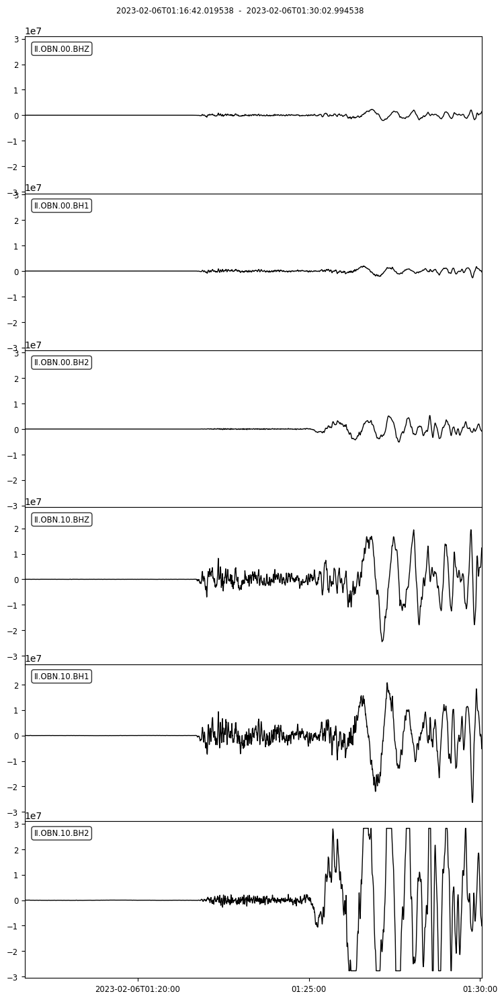

0 Trace(s) in Stream:

No waveform data found for station OTAV 
 
 

6 Trace(s) in Stream:
IU.PAB.00.BH1 | 2023-02-06T01:19:02.019538Z - 2023-02-06T01:34:15.994538Z | 40.0 Hz, 36560 samples
IU.PAB.00.BH2 | 2023-02-06T01:19:02.019538Z - 2023-02-06T01:34:15.994538Z | 40.0 Hz, 36560 samples
IU.PAB.00.BHZ | 2023-02-06T01:19:02.019538Z - 2023-02-06T01:34:15.994538Z | 40.0 Hz, 36560 samples
IU.PAB.10.BH1 | 2023-02-06T01:19:02.019538Z - 2023-02-06T01:34:15.994538Z | 40.0 Hz, 36560 samples
IU.PAB.10.BH2 | 2023-02-06T01:19:02.019538Z - 2023-02-06T01:34:15.994538Z | 40.0 Hz, 36560 samples
IU.PAB.10.BHZ | 2023-02-06T01:19:02.019538Z - 2023-02-06T01:34:15.994538Z | 40.0 Hz, 36560 samples


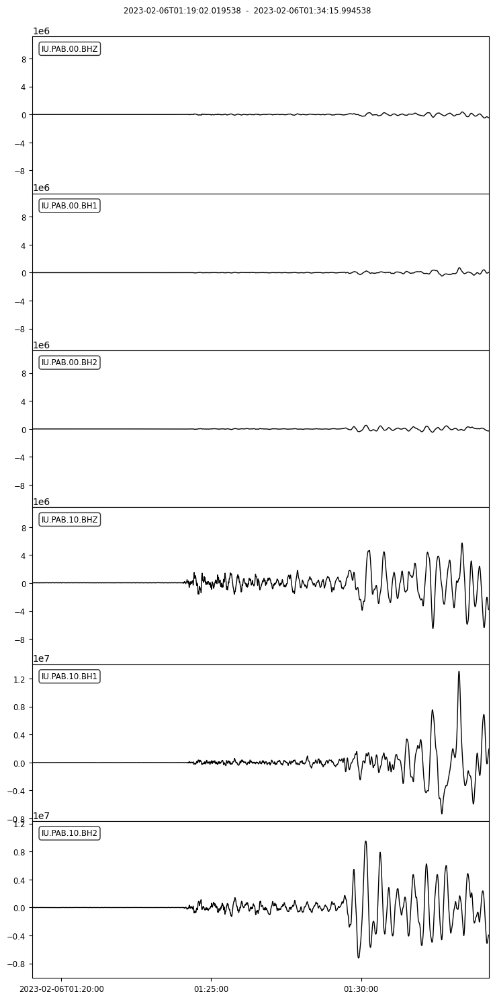

6 Trace(s) in Stream:
II.PALK.00.BH1 | 2023-02-06T01:21:25.019538Z - 2023-02-06T01:38:33.994538Z | 40.0 Hz, 41160 samples
II.PALK.00.BH2 | 2023-02-06T01:21:25.019538Z - 2023-02-06T01:38:33.994538Z | 40.0 Hz, 41160 samples
II.PALK.00.BHZ | 2023-02-06T01:21:25.019538Z - 2023-02-06T01:38:33.994538Z | 40.0 Hz, 41160 samples
II.PALK.10.BH1 | 2023-02-06T01:21:25.019538Z - 2023-02-06T01:38:33.994538Z | 40.0 Hz, 41160 samples
II.PALK.10.BH2 | 2023-02-06T01:21:25.019538Z - 2023-02-06T01:38:33.994538Z | 40.0 Hz, 41160 samples
II.PALK.10.BHZ | 2023-02-06T01:21:25.019538Z - 2023-02-06T01:38:33.994538Z | 40.0 Hz, 41160 samples


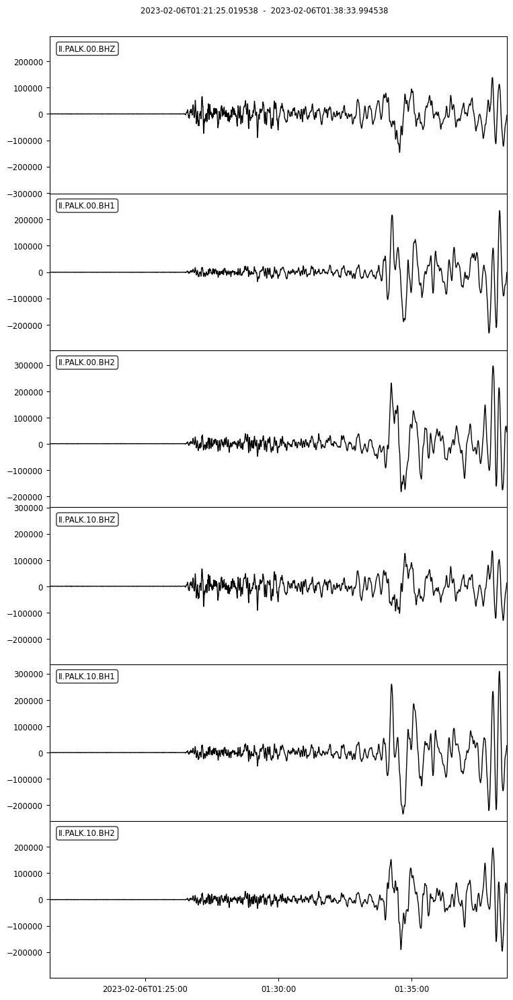

6 Trace(s) in Stream:
CI.PASC.00.BHE | 2023-02-06T01:26:40.994500Z - 2023-02-06T01:48:33.994500Z | 40.0 Hz, 52521 samples
CI.PASC.10.BHE | 2023-02-06T01:26:40.994500Z - 2023-02-06T01:48:33.994500Z | 40.0 Hz, 52521 samples
CI.PASC.00.BHN | 2023-02-06T01:26:40.994500Z - 2023-02-06T01:48:33.994500Z | 40.0 Hz, 52521 samples
CI.PASC.10.BHN | 2023-02-06T01:26:40.994500Z - 2023-02-06T01:48:33.994500Z | 40.0 Hz, 52521 samples
CI.PASC.00.BHZ | 2023-02-06T01:26:40.994500Z - 2023-02-06T01:48:33.994500Z | 40.0 Hz, 52521 samples
CI.PASC.10.BHZ | 2023-02-06T01:26:40.994500Z - 2023-02-06T01:48:33.994500Z | 40.0 Hz, 52521 samples


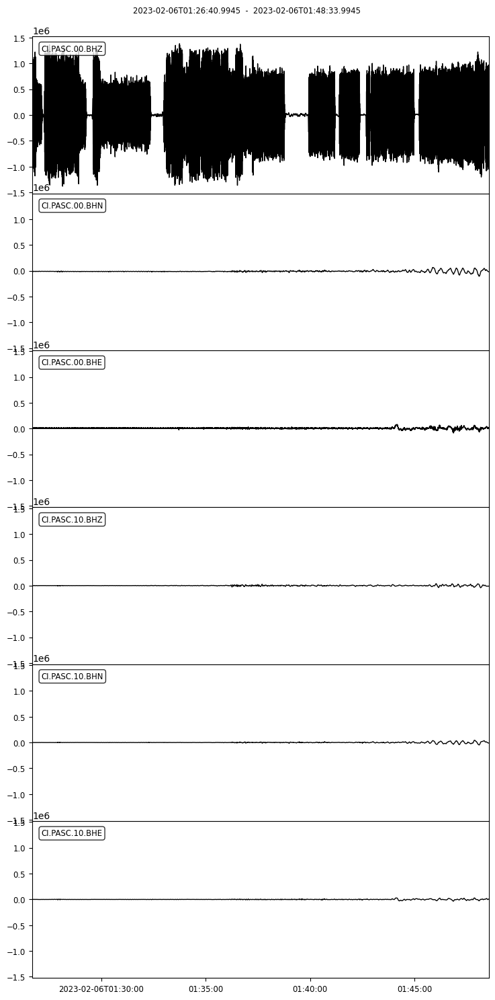

0 Trace(s) in Stream:

No waveform data found for station PAYG 
 
 

3 Trace(s) in Stream:
IM.PD31..BHE | 2023-02-06T01:25:54.000000Z - 2023-02-06T01:47:06.000000Z | 40.0 Hz, 50881 samples
IM.PD31..BHN | 2023-02-06T01:25:54.000000Z - 2023-02-06T01:47:06.000000Z | 40.0 Hz, 50881 samples
IM.PD31..BHZ | 2023-02-06T01:25:54.000000Z - 2023-02-06T01:47:06.000000Z | 40.0 Hz, 50881 samples


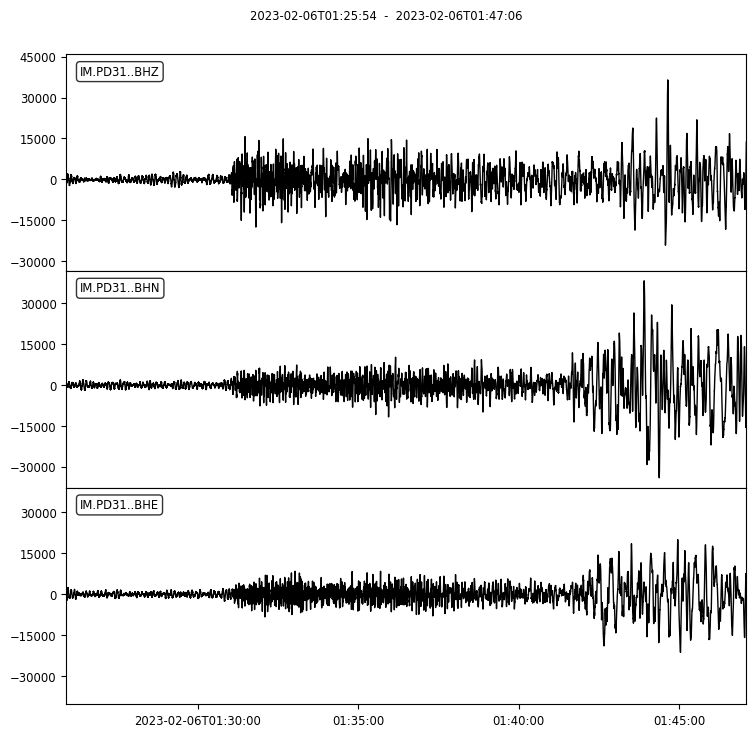

6 Trace(s) in Stream:
IU.PET.00.BH1 | 2023-02-06T01:24:24.019538Z - 2023-02-06T01:44:10.994538Z | 40.0 Hz, 47480 samples
IU.PET.00.BH2 | 2023-02-06T01:24:24.019538Z - 2023-02-06T01:44:10.994538Z | 40.0 Hz, 47480 samples
IU.PET.00.BHZ | 2023-02-06T01:24:24.019538Z - 2023-02-06T01:44:10.994538Z | 40.0 Hz, 47480 samples
IU.PET.10.BH1 | 2023-02-06T01:24:24.019538Z - 2023-02-06T01:44:10.994538Z | 40.0 Hz, 47480 samples
IU.PET.10.BH2 | 2023-02-06T01:24:24.019538Z - 2023-02-06T01:44:10.994538Z | 40.0 Hz, 47480 samples
IU.PET.10.BHZ | 2023-02-06T01:24:24.019538Z - 2023-02-06T01:44:10.994538Z | 40.0 Hz, 47480 samples


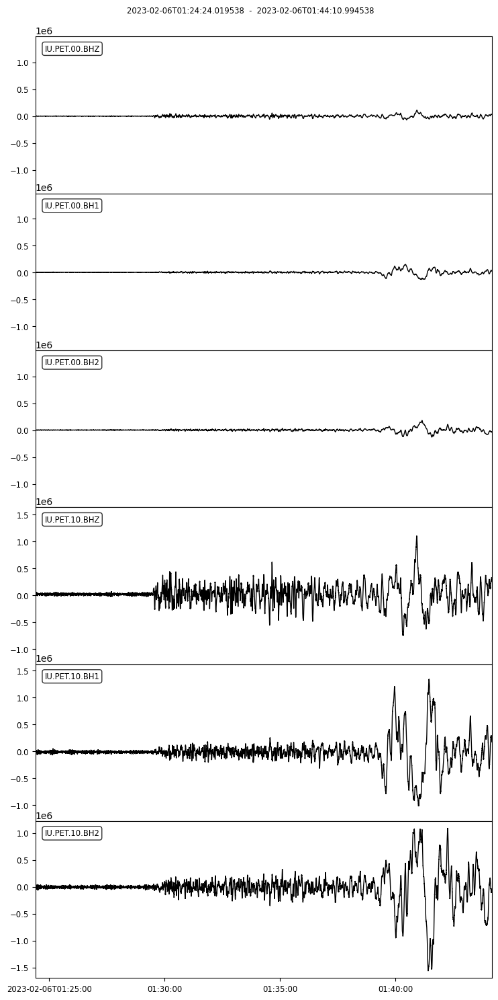

6 Trace(s) in Stream:
II.PFO.00.BH1 | 2023-02-06T01:26:41.019538Z - 2023-02-06T01:48:34.994538Z | 40.0 Hz, 52560 samples
II.PFO.00.BH2 | 2023-02-06T01:26:41.019538Z - 2023-02-06T01:48:34.994538Z | 40.0 Hz, 52560 samples
II.PFO.00.BHZ | 2023-02-06T01:26:41.019538Z - 2023-02-06T01:48:34.994538Z | 40.0 Hz, 52560 samples
II.PFO.10.BH1 | 2023-02-06T01:26:41.019538Z - 2023-02-06T01:48:34.994538Z | 40.0 Hz, 52560 samples
II.PFO.10.BH2 | 2023-02-06T01:26:41.019538Z - 2023-02-06T01:48:34.994538Z | 40.0 Hz, 52560 samples
II.PFO.10.BHZ | 2023-02-06T01:26:41.019538Z - 2023-02-06T01:48:34.994538Z | 40.0 Hz, 52560 samples


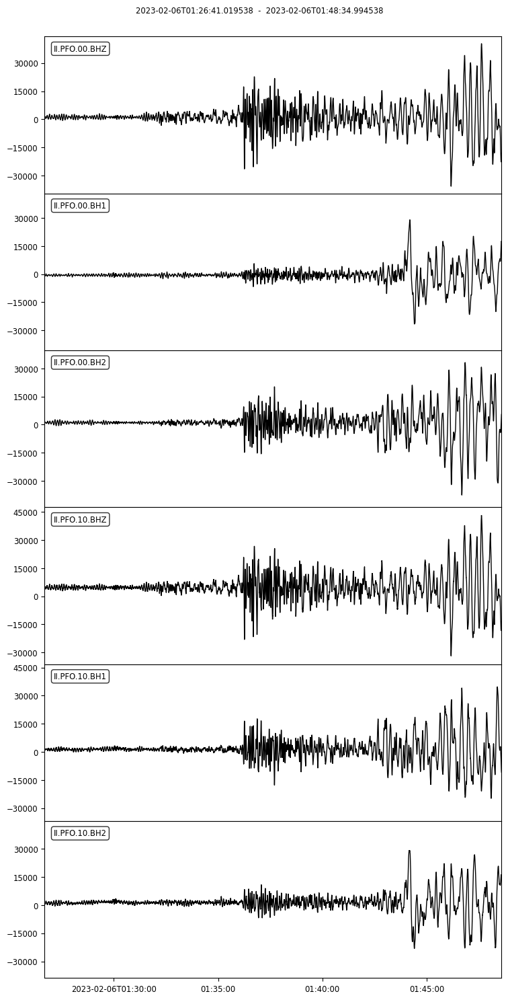

9 Trace(s) in Stream:
IU.PMG.00.BH1 | 2023-02-06T01:27:10.019538Z - 2023-02-06T01:49:29.969538Z | 20.0 Hz, 26800 samples
IU.PMG.00.BH2 | 2023-02-06T01:27:10.019538Z - 2023-02-06T01:49:29.969538Z | 20.0 Hz, 26800 samples
IU.PMG.00.BHZ | 2023-02-06T01:27:10.019538Z - 2023-02-06T01:49:29.969538Z | 20.0 Hz, 26800 samples
IU.PMG.10.BH1 | 2023-02-06T01:27:10.019538Z - 2023-02-06T01:49:29.994538Z | 40.0 Hz, 53600 samples
IU.PMG.10.BH2 | 2023-02-06T01:27:10.019538Z - 2023-02-06T01:49:29.994538Z | 40.0 Hz, 53600 samples
IU.PMG.10.BHZ | 2023-02-06T01:27:10.019538Z - 2023-02-06T01:49:29.994538Z | 40.0 Hz, 53600 samples
IU.PMG.60.BH1 | 2023-02-06T01:27:10.019538Z - 2023-02-06T01:49:29.994538Z | 40.0 Hz, 53600 samples
IU.PMG.60.BH2 | 2023-02-06T01:27:10.019538Z - 2023-02-06T01:49:29.994538Z | 40.0 Hz, 53600 samples
IU.PMG.60.BHZ | 2023-02-06T01:27:10.019538Z - 2023-02-06T01:49:29.994538Z | 40.0 Hz, 53600 samples


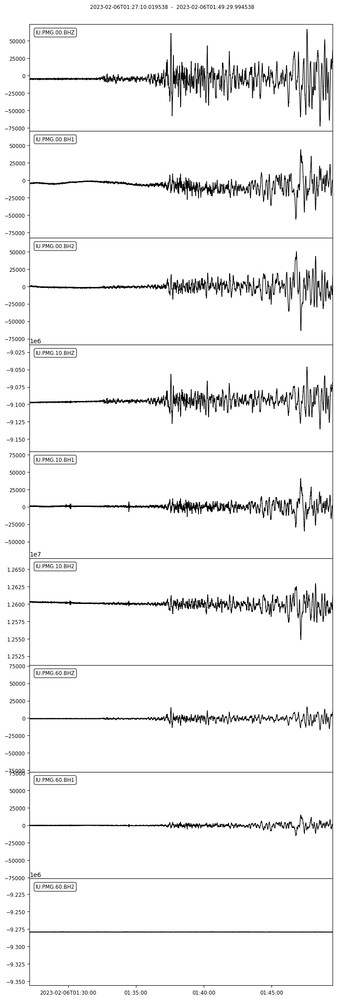

6 Trace(s) in Stream:
IU.PMSA.00.BH1 | 2023-02-06T01:28:22.019538Z - 2023-02-06T01:51:43.969538Z | 20.0 Hz, 28040 samples
IU.PMSA.00.BH2 | 2023-02-06T01:28:22.019538Z - 2023-02-06T01:51:43.969538Z | 20.0 Hz, 28040 samples
IU.PMSA.00.BHZ | 2023-02-06T01:28:22.019538Z - 2023-02-06T01:51:43.969538Z | 20.0 Hz, 28040 samples
IU.PMSA.10.BH1 | 2023-02-06T01:28:22.019538Z - 2023-02-06T01:51:43.994538Z | 40.0 Hz, 56080 samples
IU.PMSA.10.BH2 | 2023-02-06T01:28:22.019538Z - 2023-02-06T01:51:43.994538Z | 40.0 Hz, 56080 samples
IU.PMSA.10.BHZ | 2023-02-06T01:28:22.019538Z - 2023-02-06T01:51:43.994538Z | 40.0 Hz, 56080 samples


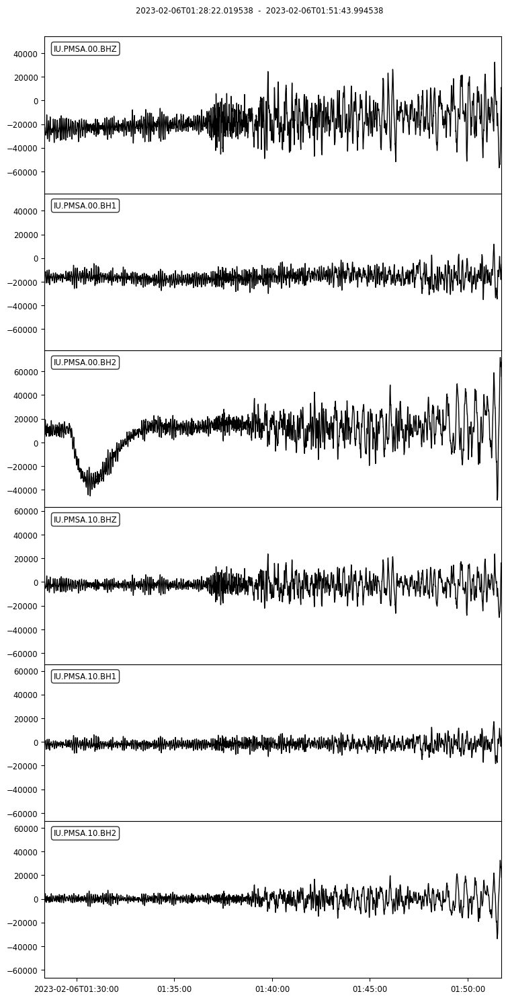

6 Trace(s) in Stream:
IU.POHA.00.BH1 | 2023-02-06T01:27:55.019538Z - 2023-02-06T01:50:54.994538Z | 40.0 Hz, 55200 samples
IU.POHA.00.BH2 | 2023-02-06T01:27:55.019538Z - 2023-02-06T01:50:54.994538Z | 40.0 Hz, 55200 samples
IU.POHA.00.BHZ | 2023-02-06T01:27:55.019538Z - 2023-02-06T01:50:54.994538Z | 40.0 Hz, 55200 samples
IU.POHA.10.BH1 | 2023-02-06T01:27:55.019538Z - 2023-02-06T01:50:54.994538Z | 40.0 Hz, 55200 samples
IU.POHA.10.BH2 | 2023-02-06T01:27:55.019538Z - 2023-02-06T01:50:54.994538Z | 40.0 Hz, 55200 samples
IU.POHA.10.BHZ | 2023-02-06T01:27:55.019538Z - 2023-02-06T01:50:54.994538Z | 40.0 Hz, 55200 samples


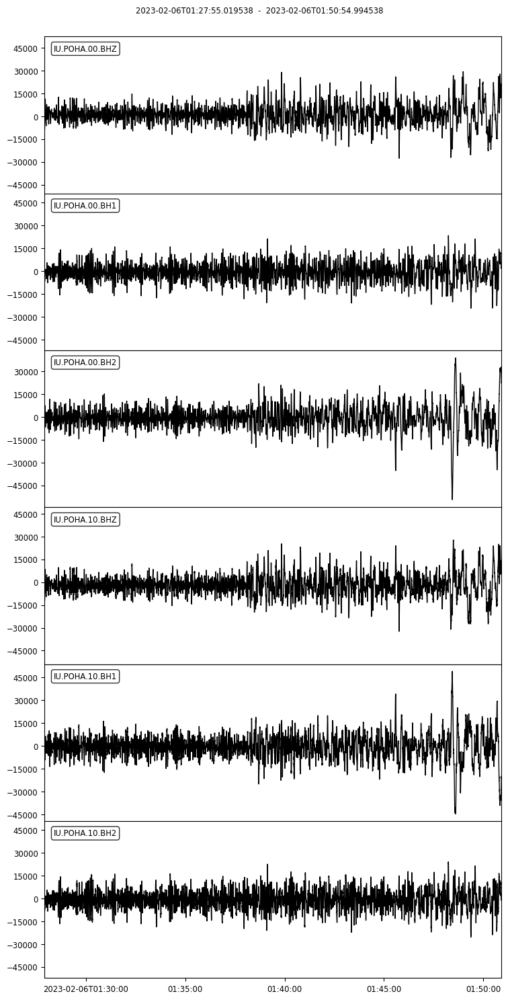

6 Trace(s) in Stream:
IU.PTCN.00.BH1 | 2023-02-06T01:32:36.019538Z - 2023-02-06T01:49:40.994538Z | 40.0 Hz, 41000 samples
IU.PTCN.00.BH2 | 2023-02-06T01:32:36.019538Z - 2023-02-06T01:49:40.994538Z | 40.0 Hz, 41000 samples
IU.PTCN.00.BHZ | 2023-02-06T01:32:36.019538Z - 2023-02-06T01:49:40.994538Z | 40.0 Hz, 41000 samples
IU.PTCN.10.BH1 | 2023-02-06T01:32:36.019538Z - 2023-02-06T01:49:40.994538Z | 40.0 Hz, 41000 samples
IU.PTCN.10.BH2 | 2023-02-06T01:32:36.019538Z - 2023-02-06T01:49:40.994538Z | 40.0 Hz, 41000 samples
IU.PTCN.10.BHZ | 2023-02-06T01:32:36.019538Z - 2023-02-06T01:49:40.994538Z | 40.0 Hz, 41000 samples


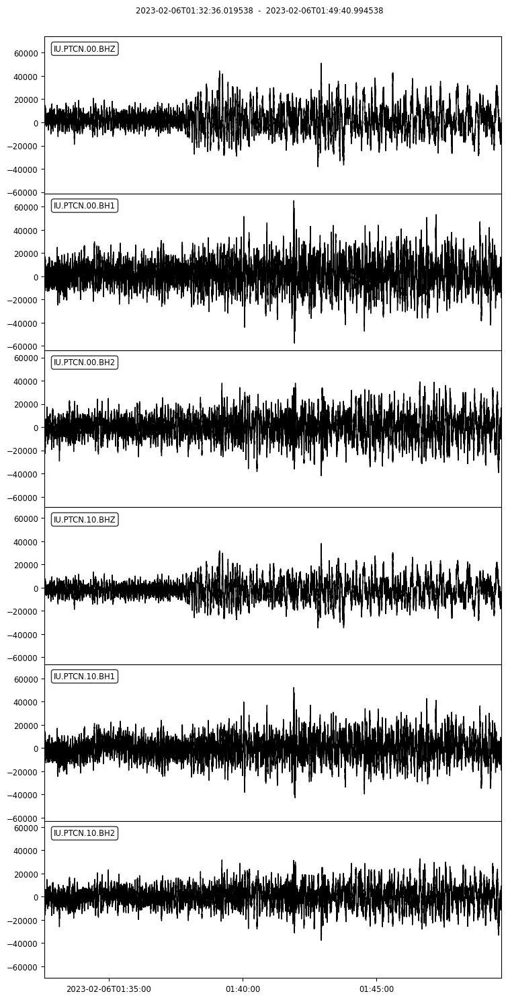

3 Trace(s) in Stream:
IC.QIZ.00.BH1 | 2023-02-06T01:23:15.019538Z - 2023-02-06T01:41:58.969538Z | 20.0 Hz, 22480 samples
IC.QIZ.00.BH2 | 2023-02-06T01:23:15.019536Z - 2023-02-06T01:41:58.969536Z | 20.0 Hz, 22480 samples
IC.QIZ.00.BHZ | 2023-02-06T01:23:15.019538Z - 2023-02-06T01:41:58.969538Z | 20.0 Hz, 22480 samples


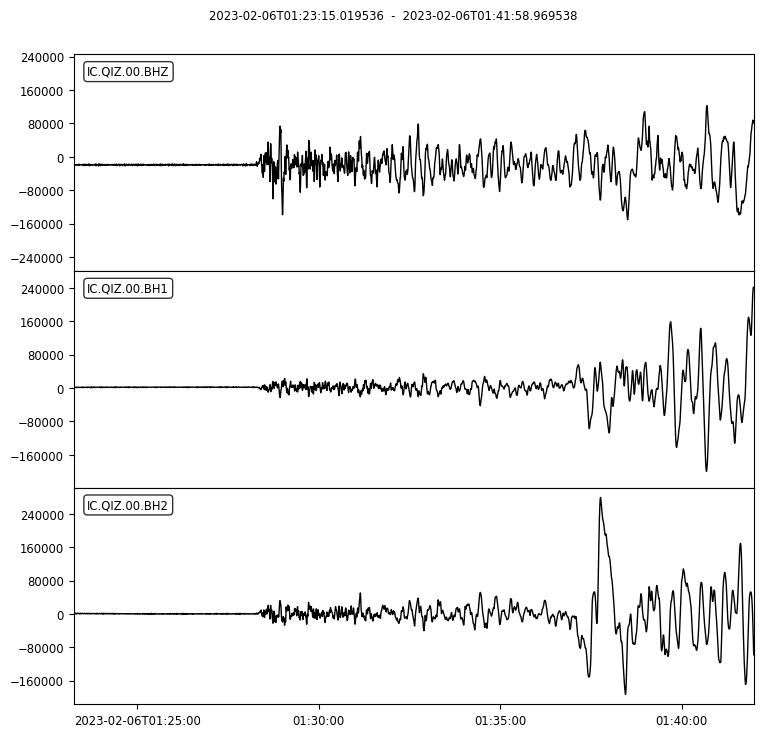

13 Trace(s) in Stream:
IU.QSPA.00.BH1 | 2023-02-06T01:28:20.019538Z - 2023-02-06T01:51:39.969538Z | 20.0 Hz, 28000 samples
IU.QSPA.00.BH2 | 2023-02-06T01:28:20.019538Z - 2023-02-06T01:51:39.969538Z | 20.0 Hz, 28000 samples
IU.QSPA.00.BHZ | 2023-02-06T01:28:20.019538Z - 2023-02-06T01:51:39.969538Z | 20.0 Hz, 28000 samples
IU.QSPA.10.BH1 | 2023-02-06T01:28:20.019538Z - 2023-02-06T01:51:39.994538Z | 40.0 Hz, 56000 samples
IU.QSPA.10.BH2 | 2023-02-06T01:28:20.019538Z - 2023-02-06T01:51:39.994538Z | 40.0 Hz, 56000 samples
IU.QSPA.10.BHZ | 2023-02-06T01:28:20.019538Z - 2023-02-06T01:51:39.994538Z | 40.0 Hz, 56000 samples
IU.QSPA.60.BH1 | 2023-02-06T01:28:20.019539Z - 2023-02-06T01:51:39.994539Z | 40.0 Hz, 56000 samples
IU.QSPA.60.BH2 | 2023-02-06T01:28:20.019538Z - 2023-02-06T01:51:39.994538Z | 40.0 Hz, 56000 samples
IU.QSPA.60.BHZ | 2023-02-06T01:28:20.019538Z - 2023-02-06T01:51:39.994538Z | 40.0 Hz, 56000 samples
IU.QSPA.70.BH1 | 2023-02-06T01:28:20.019536Z - 2023-02-06T01:51:39.994536Z | 

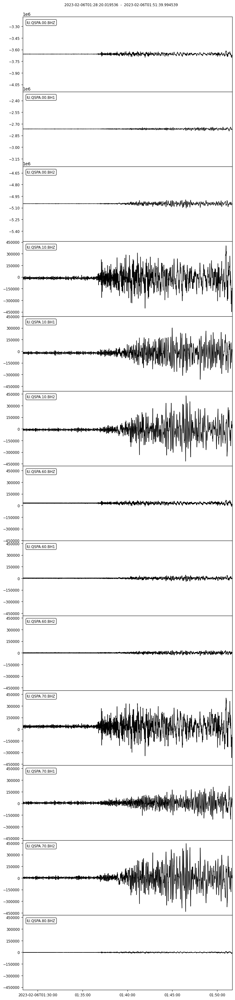

6 Trace(s) in Stream:
IU.RAO.00.BH1 | 2023-02-06T01:32:13.019538Z - 2023-02-06T01:49:37.994538Z | 40.0 Hz, 41800 samples
IU.RAO.00.BH2 | 2023-02-06T01:32:13.019538Z - 2023-02-06T01:49:37.994538Z | 40.0 Hz, 41800 samples
IU.RAO.00.BHZ | 2023-02-06T01:32:13.019538Z - 2023-02-06T01:49:37.994538Z | 40.0 Hz, 41800 samples
IU.RAO.10.BH1 | 2023-02-06T01:32:13.019538Z - 2023-02-06T01:49:37.994538Z | 40.0 Hz, 41800 samples
IU.RAO.10.BH2 | 2023-02-06T01:32:13.019538Z - 2023-02-06T01:49:37.994538Z | 40.0 Hz, 41800 samples
IU.RAO.10.BHZ | 2023-02-06T01:32:13.019538Z - 2023-02-06T01:49:37.994538Z | 40.0 Hz, 41800 samples


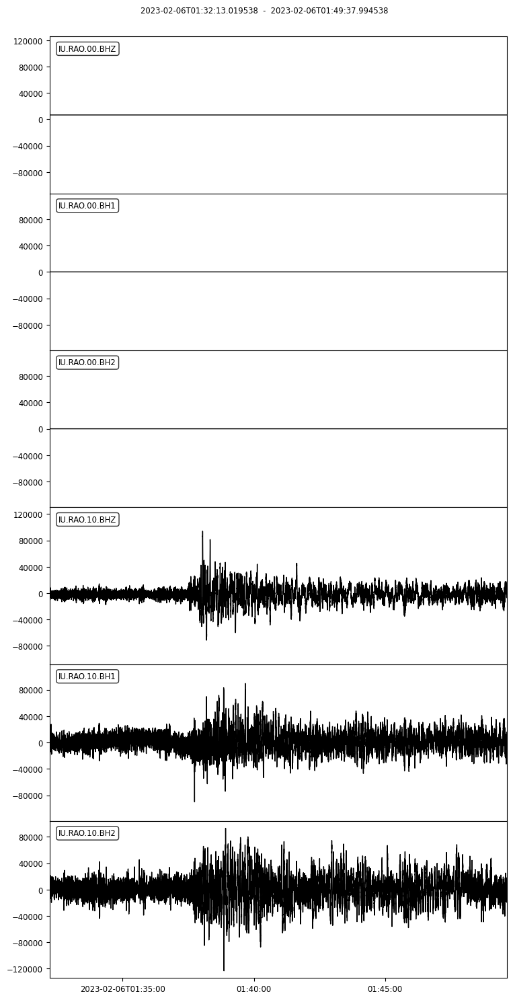

6 Trace(s) in Stream:
IU.RAR.00.BH1 | 2023-02-06T01:32:30.019538Z - 2023-02-06T01:49:35.994538Z | 40.0 Hz, 41040 samples
IU.RAR.00.BH2 | 2023-02-06T01:32:30.019538Z - 2023-02-06T01:49:35.994538Z | 40.0 Hz, 41040 samples
IU.RAR.00.BHZ | 2023-02-06T01:32:30.019538Z - 2023-02-06T01:49:35.994538Z | 40.0 Hz, 41040 samples
IU.RAR.10.BH1 | 2023-02-06T01:32:30.019538Z - 2023-02-06T01:49:35.994538Z | 40.0 Hz, 41040 samples
IU.RAR.10.BH2 | 2023-02-06T01:32:30.019538Z - 2023-02-06T01:49:35.994538Z | 40.0 Hz, 41040 samples
IU.RAR.10.BHZ | 2023-02-06T01:32:30.019538Z - 2023-02-06T01:49:35.994538Z | 40.0 Hz, 41040 samples


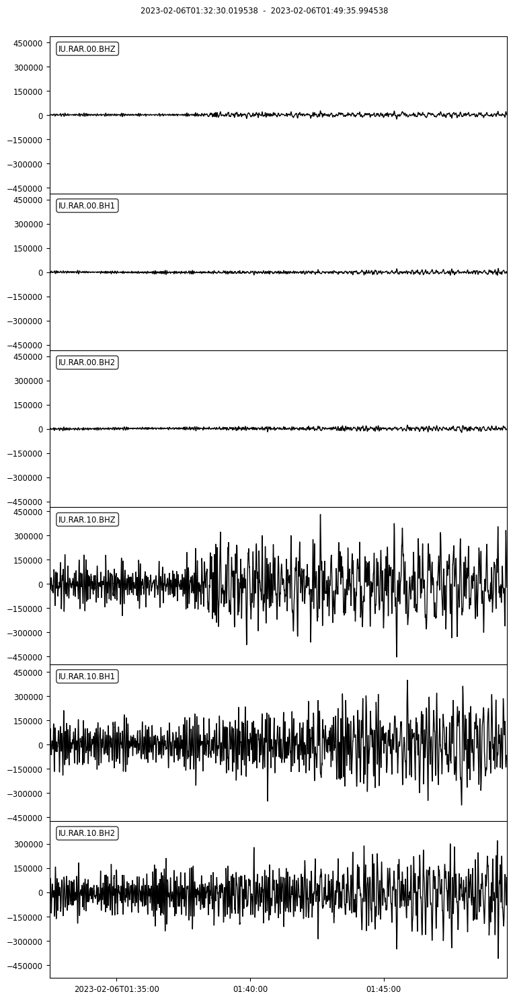

6 Trace(s) in Stream:
II.RAYN.00.BH1 | 2023-02-06T01:16:12.019538Z - 2023-02-06T01:29:04.994538Z | 40.0 Hz, 30920 samples
II.RAYN.00.BH2 | 2023-02-06T01:16:12.019538Z - 2023-02-06T01:29:04.994538Z | 40.0 Hz, 30920 samples
II.RAYN.00.BHZ | 2023-02-06T01:16:12.019538Z - 2023-02-06T01:29:04.994538Z | 40.0 Hz, 30920 samples
II.RAYN.10.BH1 | 2023-02-06T01:16:12.019538Z - 2023-02-06T01:29:04.994538Z | 40.0 Hz, 30920 samples
II.RAYN.10.BH2 | 2023-02-06T01:16:12.019538Z - 2023-02-06T01:29:04.994538Z | 40.0 Hz, 30920 samples
II.RAYN.10.BHZ | 2023-02-06T01:16:12.019538Z - 2023-02-06T01:29:04.994538Z | 40.0 Hz, 30920 samples


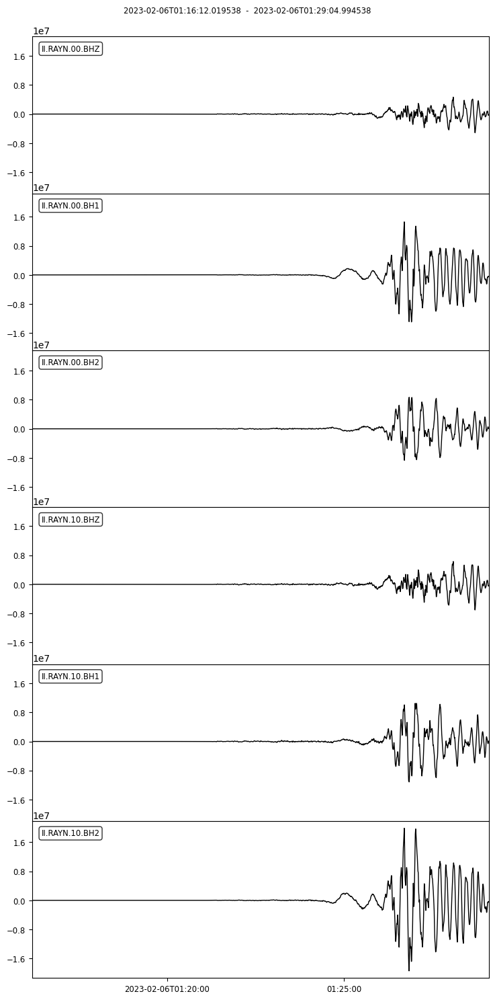

0 Trace(s) in Stream:

No waveform data found for station RCBR 
 
 

4 Trace(s) in Stream:
II.RPN.00.BHZ | 2023-02-06T01:32:17.019538Z - 2023-02-06T01:49:28.969538Z | 20.0 Hz, 20640 samples
II.RPN.10.BH1 | 2023-02-06T01:32:17.019538Z - 2023-02-06T01:49:28.994538Z | 40.0 Hz, 41280 samples
II.RPN.10.BH2 | 2023-02-06T01:32:17.019538Z - 2023-02-06T01:49:28.994538Z | 40.0 Hz, 41280 samples
II.RPN.10.BHZ | 2023-02-06T01:32:17.019538Z - 2023-02-06T01:49:28.994538Z | 40.0 Hz, 41280 samples


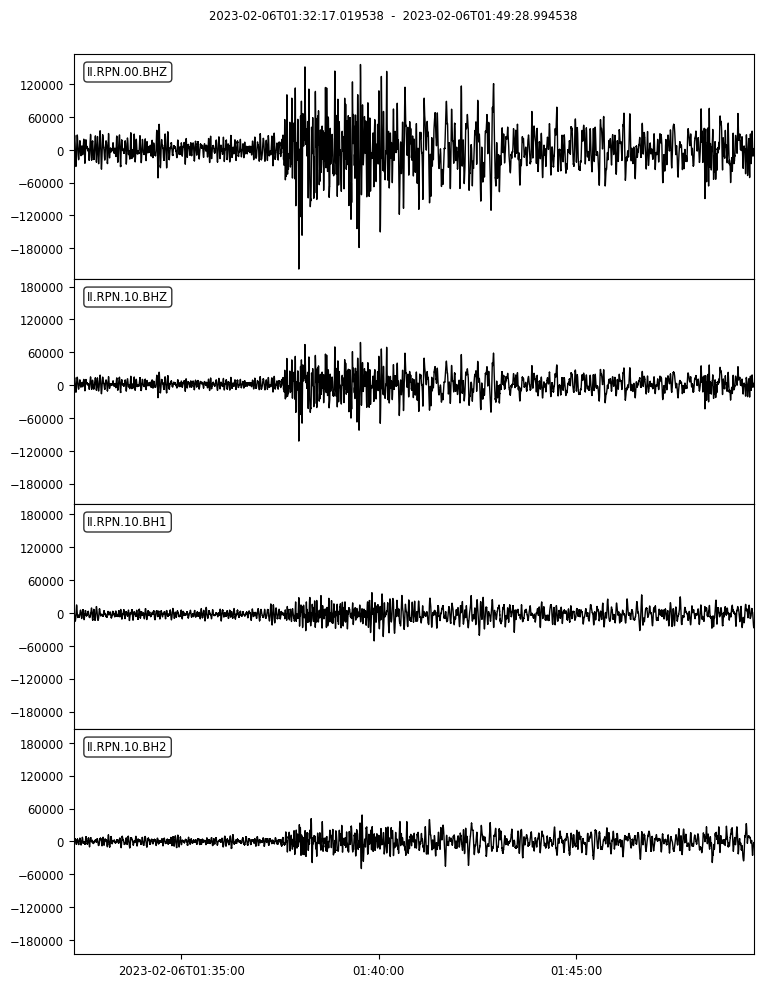

6 Trace(s) in Stream:
IU.RSSD.00.BH1 | 2023-02-06T01:25:39.019538Z - 2023-02-06T01:46:37.994538Z | 40.0 Hz, 50360 samples
IU.RSSD.00.BH2 | 2023-02-06T01:25:39.019538Z - 2023-02-06T01:46:37.994538Z | 40.0 Hz, 50360 samples
IU.RSSD.00.BHZ | 2023-02-06T01:25:39.019538Z - 2023-02-06T01:46:37.994538Z | 40.0 Hz, 50360 samples
IU.RSSD.10.BH1 | 2023-02-06T01:25:39.019538Z - 2023-02-06T01:46:37.994538Z | 40.0 Hz, 50360 samples
IU.RSSD.10.BH2 | 2023-02-06T01:25:39.019538Z - 2023-02-06T01:46:37.994538Z | 40.0 Hz, 50360 samples
IU.RSSD.10.BHZ | 2023-02-06T01:25:39.019538Z - 2023-02-06T01:46:37.994538Z | 40.0 Hz, 50360 samples


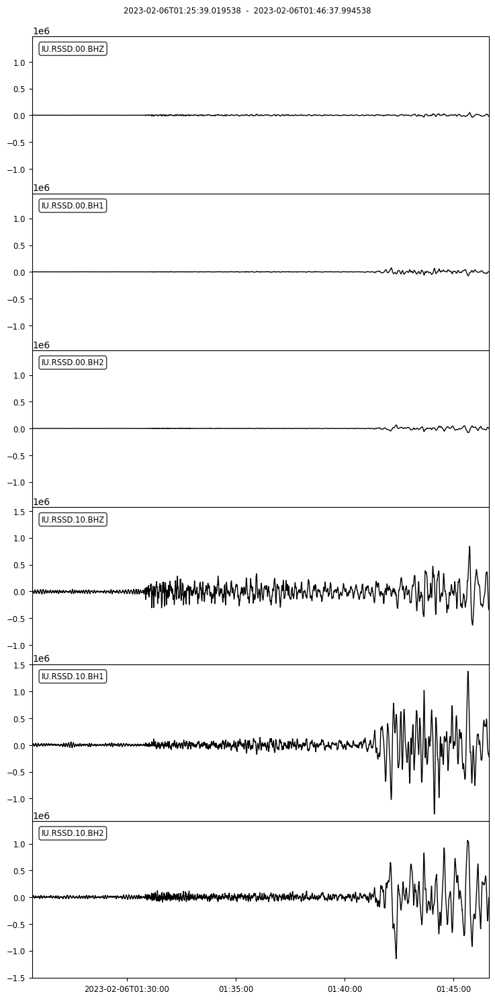

6 Trace(s) in Stream:
II.SACV.00.BH1 | 2023-02-06T01:22:25.019538Z - 2023-02-06T01:40:23.994538Z | 40.0 Hz, 43160 samples
II.SACV.00.BH2 | 2023-02-06T01:22:25.019538Z - 2023-02-06T01:40:23.994538Z | 40.0 Hz, 43160 samples
II.SACV.00.BHZ | 2023-02-06T01:22:25.019538Z - 2023-02-06T01:40:23.994538Z | 40.0 Hz, 43160 samples
II.SACV.10.BH1 | 2023-02-06T01:22:25.019536Z - 2023-02-06T01:40:23.994536Z | 40.0 Hz, 43160 samples
II.SACV.10.BH2 | 2023-02-06T01:22:25.019536Z - 2023-02-06T01:40:23.994536Z | 40.0 Hz, 43160 samples
II.SACV.10.BHZ | 2023-02-06T01:22:25.019536Z - 2023-02-06T01:40:23.994536Z | 40.0 Hz, 43160 samples


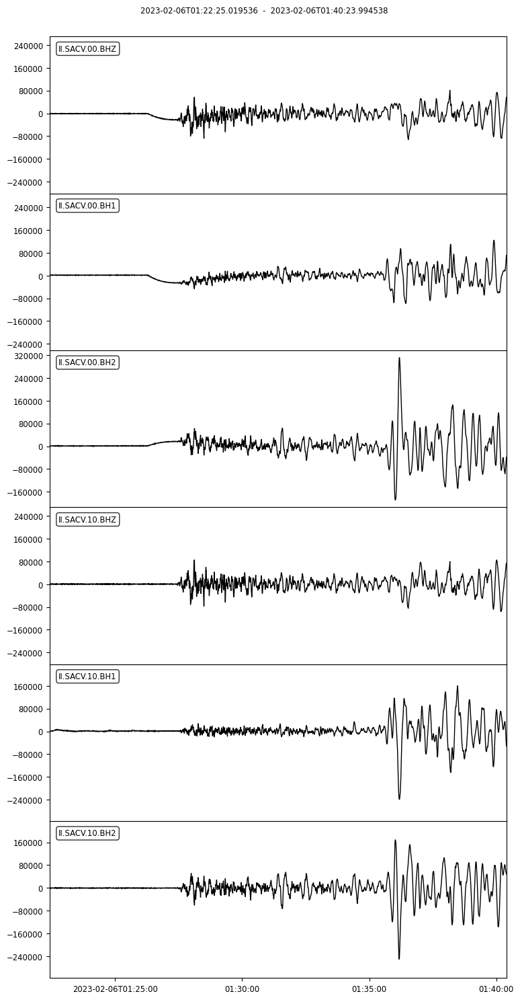

0 Trace(s) in Stream:

No waveform data found for station SAML 
 
 

6 Trace(s) in Stream:
IU.SBA.00.BH1 | 2023-02-06T01:28:51.019539Z - 2023-02-06T01:52:38.994539Z | 40.0 Hz, 57120 samples
IU.SBA.00.BH2 | 2023-02-06T01:28:51.019539Z - 2023-02-06T01:52:38.994539Z | 40.0 Hz, 57120 samples
IU.SBA.00.BHZ | 2023-02-06T01:28:51.019538Z - 2023-02-06T01:52:38.994538Z | 40.0 Hz, 57120 samples
IU.SBA.10.BH1 | 2023-02-06T01:28:51.019538Z - 2023-02-06T01:52:38.994538Z | 40.0 Hz, 57120 samples
IU.SBA.10.BH2 | 2023-02-06T01:28:51.019538Z - 2023-02-06T01:52:38.994538Z | 40.0 Hz, 57120 samples
IU.SBA.10.BHZ | 2023-02-06T01:28:51.019538Z - 2023-02-06T01:52:38.994538Z | 40.0 Hz, 57120 samples


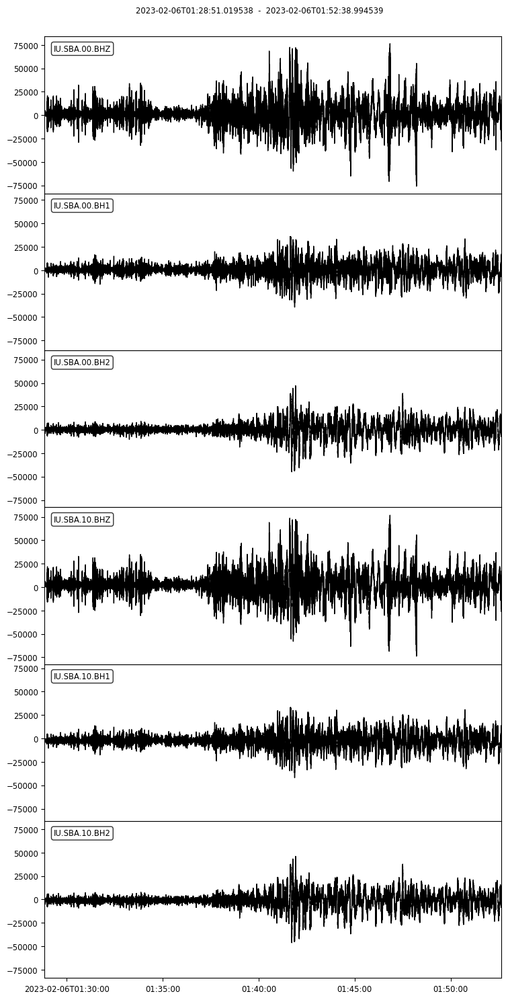

3 Trace(s) in Stream:
CU.SDDR.00.BH1 | 2023-02-06T01:25:44.000000Z - 2023-02-06T01:46:47.000000Z | 40.0 Hz, 50521 samples
CU.SDDR.00.BH2 | 2023-02-06T01:25:44.024998Z - 2023-02-06T01:46:46.999998Z | 40.0 Hz, 50520 samples
CU.SDDR.00.BHZ | 2023-02-06T01:25:44.000000Z - 2023-02-06T01:46:47.000000Z | 40.0 Hz, 50521 samples


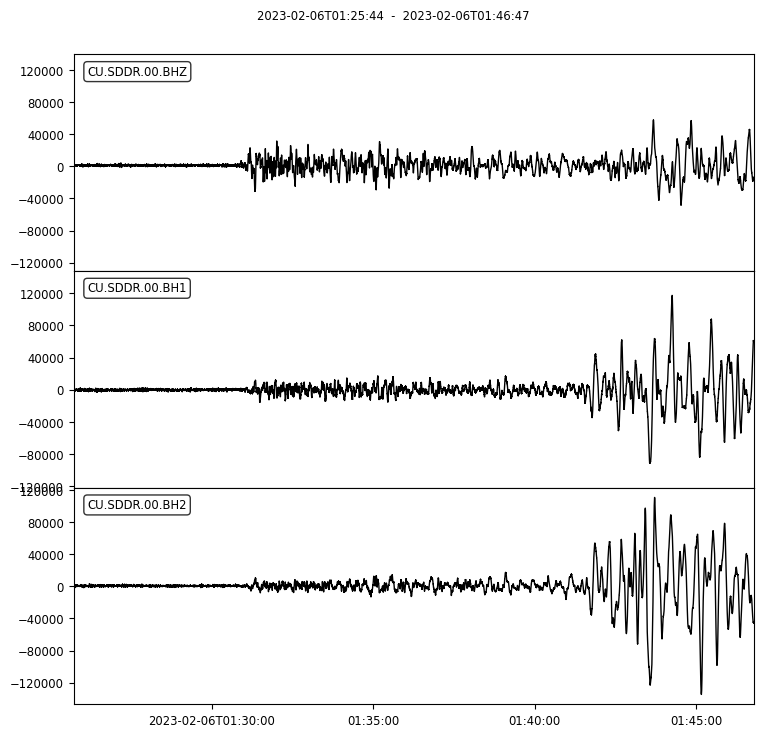

6 Trace(s) in Stream:
IU.SDV.00.BH1 | 2023-02-06T01:26:11.019536Z - 2023-02-06T01:47:38.994536Z | 40.0 Hz, 51520 samples
IU.SDV.00.BH2 | 2023-02-06T01:26:11.019538Z - 2023-02-06T01:47:38.994538Z | 40.0 Hz, 51520 samples
IU.SDV.00.BHZ | 2023-02-06T01:26:11.019538Z - 2023-02-06T01:47:38.994538Z | 40.0 Hz, 51520 samples
IU.SDV.10.BH1 | 2023-02-06T01:26:11.019539Z - 2023-02-06T01:47:38.969539Z | 20.0 Hz, 25760 samples
IU.SDV.10.BH2 | 2023-02-06T01:26:11.019539Z - 2023-02-06T01:47:38.969539Z | 20.0 Hz, 25760 samples
IU.SDV.10.BHZ | 2023-02-06T01:26:11.019538Z - 2023-02-06T01:47:38.969538Z | 20.0 Hz, 25760 samples


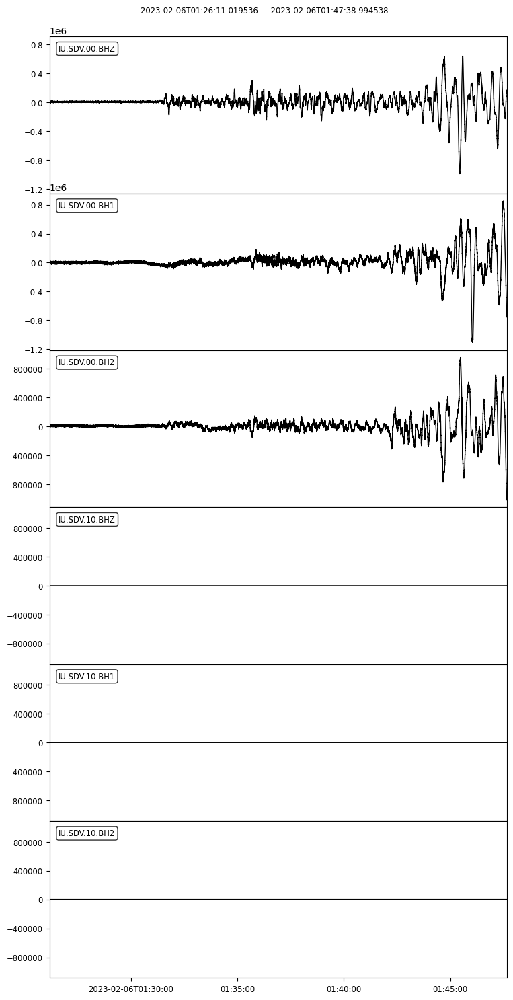

6 Trace(s) in Stream:
IU.SFJD.00.BH1 | 2023-02-06T01:22:07.019538Z - 2023-02-06T01:39:50.969538Z | 20.0 Hz, 21280 samples
IU.SFJD.00.BH2 | 2023-02-06T01:22:07.019538Z - 2023-02-06T01:39:50.969538Z | 20.0 Hz, 21280 samples
IU.SFJD.00.BHZ | 2023-02-06T01:22:07.019538Z - 2023-02-06T01:39:50.969538Z | 20.0 Hz, 21280 samples
IU.SFJD.10.BH1 | 2023-02-06T01:22:07.019538Z - 2023-02-06T01:39:50.994538Z | 40.0 Hz, 42560 samples
IU.SFJD.10.BH2 | 2023-02-06T01:22:07.019538Z - 2023-02-06T01:39:50.994538Z | 40.0 Hz, 42560 samples
IU.SFJD.10.BHZ | 2023-02-06T01:22:07.019538Z - 2023-02-06T01:39:50.994538Z | 40.0 Hz, 42560 samples


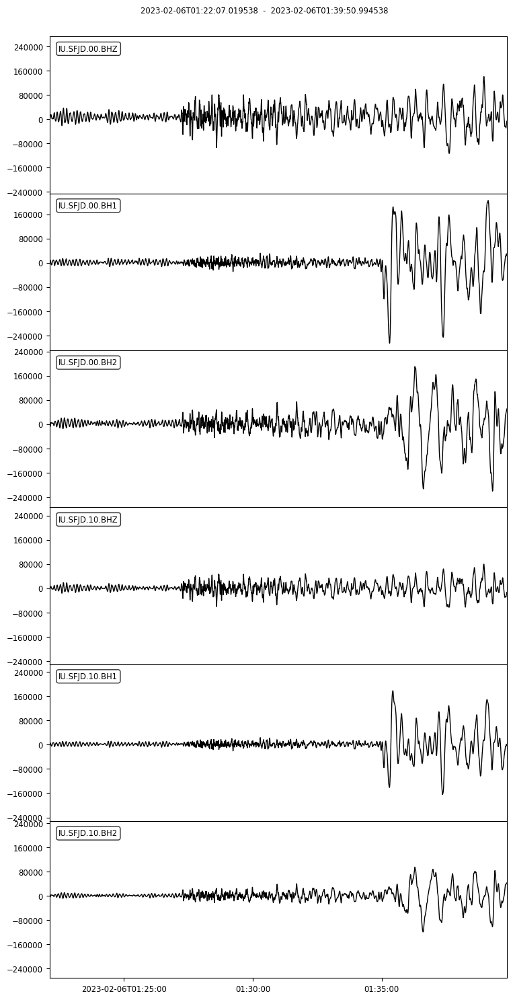

6 Trace(s) in Stream:
II.SHEL.00.BH1 | 2023-02-06T01:23:25.019538Z - 2023-02-06T01:42:16.969538Z | 20.0 Hz, 22640 samples
II.SHEL.00.BH2 | 2023-02-06T01:23:25.019538Z - 2023-02-06T01:42:16.969538Z | 20.0 Hz, 22640 samples
II.SHEL.00.BHZ | 2023-02-06T01:23:25.019538Z - 2023-02-06T01:42:16.969538Z | 20.0 Hz, 22640 samples
II.SHEL.10.BH1 | 2023-02-06T01:23:25.019538Z - 2023-02-06T01:42:16.994538Z | 40.0 Hz, 45280 samples
II.SHEL.10.BH2 | 2023-02-06T01:23:25.019538Z - 2023-02-06T01:42:16.994538Z | 40.0 Hz, 45280 samples
II.SHEL.10.BHZ | 2023-02-06T01:23:25.019538Z - 2023-02-06T01:42:16.994538Z | 40.0 Hz, 45280 samples


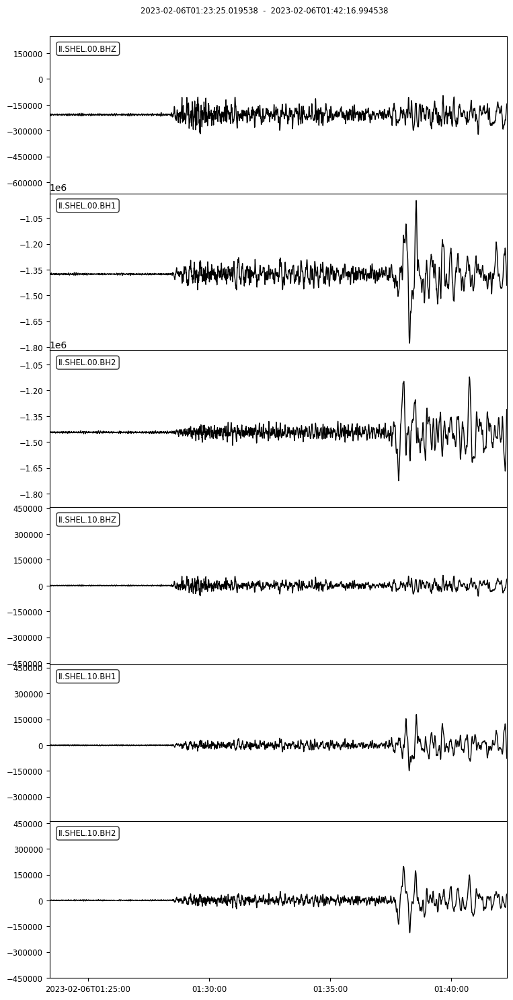

3 Trace(s) in Stream:
II.SIMI.00.BH1 | 2023-02-06T01:17:59.019538Z - 2023-02-06T01:32:24.994538Z | 40.0 Hz, 34640 samples
II.SIMI.00.BH2 | 2023-02-06T01:17:59.019538Z - 2023-02-06T01:32:24.994538Z | 40.0 Hz, 34640 samples
II.SIMI.00.BHZ | 2023-02-06T01:17:59.019538Z - 2023-02-06T01:32:24.994538Z | 40.0 Hz, 34640 samples


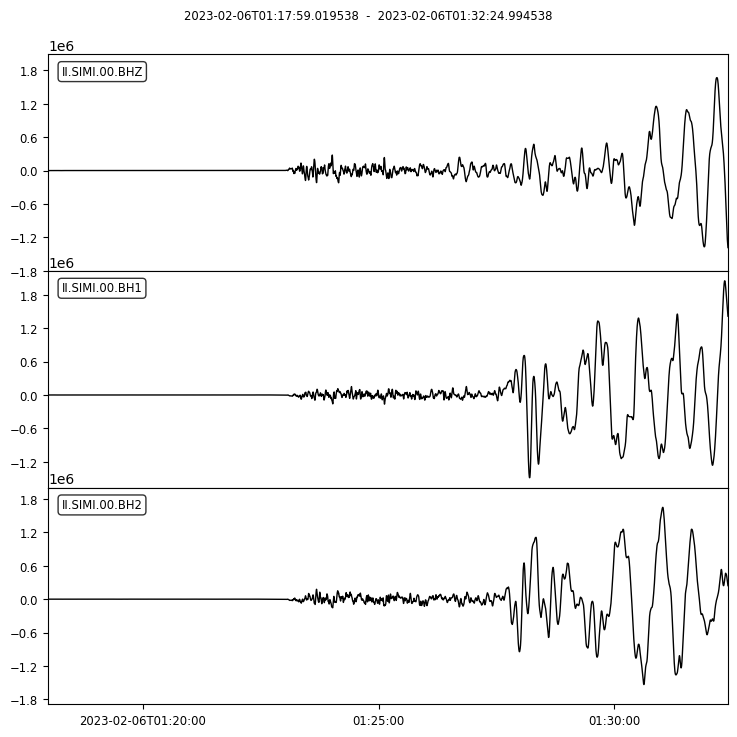

6 Trace(s) in Stream:
IU.SJG.00.BH1 | 2023-02-06T01:25:29.019538Z - 2023-02-06T01:46:17.994538Z | 40.0 Hz, 49960 samples
IU.SJG.00.BH2 | 2023-02-06T01:25:29.019538Z - 2023-02-06T01:46:17.994538Z | 40.0 Hz, 49960 samples
IU.SJG.00.BHZ | 2023-02-06T01:25:29.019538Z - 2023-02-06T01:46:17.994538Z | 40.0 Hz, 49960 samples
IU.SJG.10.BH1 | 2023-02-06T01:25:29.019538Z - 2023-02-06T01:46:17.994538Z | 40.0 Hz, 49960 samples
IU.SJG.10.BH2 | 2023-02-06T01:25:29.019538Z - 2023-02-06T01:46:17.994538Z | 40.0 Hz, 49960 samples
IU.SJG.10.BHZ | 2023-02-06T01:25:29.019538Z - 2023-02-06T01:46:17.994538Z | 40.0 Hz, 49960 samples


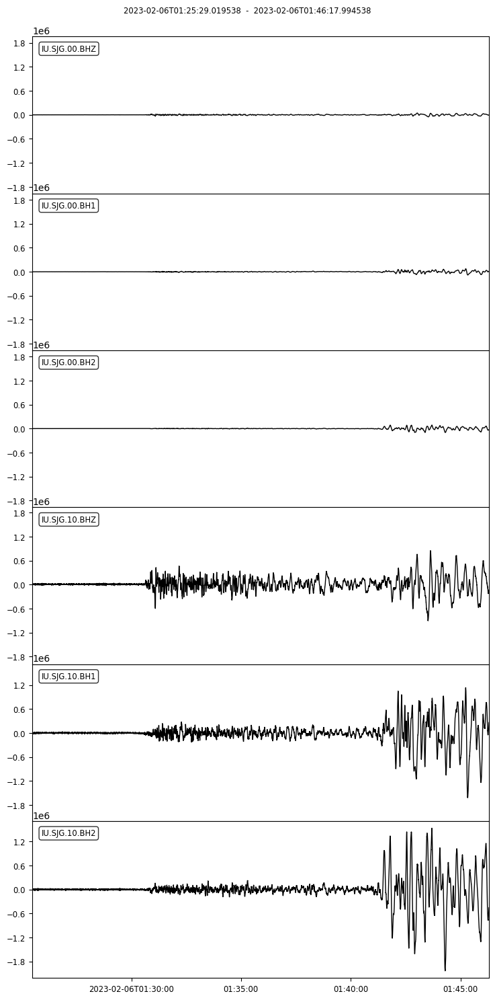

6 Trace(s) in Stream:
IU.SLBS.00.BH1 | 2023-02-06T01:27:10.019538Z - 2023-02-06T01:49:29.994538Z | 40.0 Hz, 53600 samples
IU.SLBS.00.BH2 | 2023-02-06T01:27:10.019538Z - 2023-02-06T01:49:29.994538Z | 40.0 Hz, 53600 samples
IU.SLBS.00.BHZ | 2023-02-06T01:27:10.019538Z - 2023-02-06T01:49:29.994538Z | 40.0 Hz, 53600 samples
IU.SLBS.10.BH1 | 2023-02-06T01:27:10.019538Z - 2023-02-06T01:49:29.969538Z | 20.0 Hz, 26800 samples
IU.SLBS.10.BH2 | 2023-02-06T01:27:10.019538Z - 2023-02-06T01:49:29.969538Z | 20.0 Hz, 26800 samples
IU.SLBS.10.BHZ | 2023-02-06T01:27:10.019536Z - 2023-02-06T01:49:29.969536Z | 20.0 Hz, 26800 samples


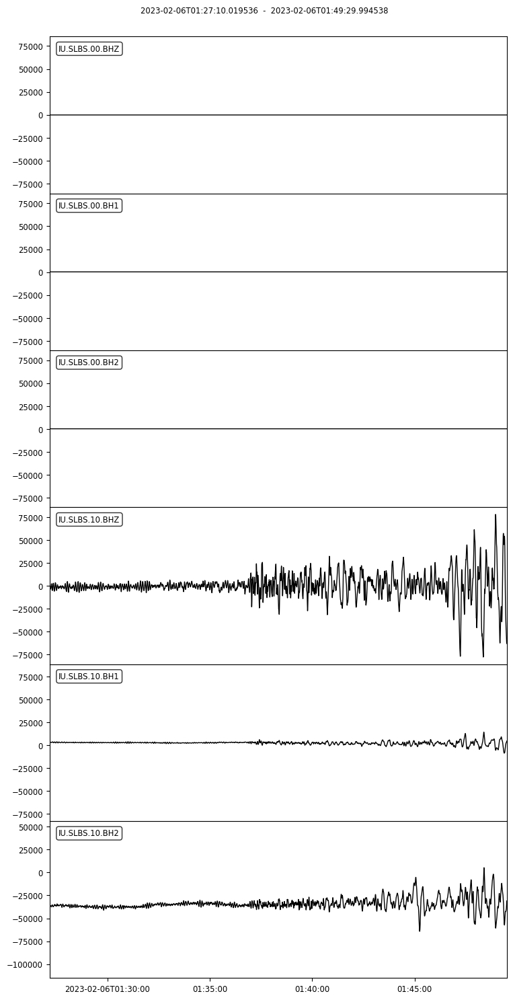

6 Trace(s) in Stream:
IU.SNZO.00.BH1 | 2023-02-06T01:30:03.019538Z - 2023-02-06T01:53:52.994538Z | 40.0 Hz, 57200 samples
IU.SNZO.00.BH2 | 2023-02-06T01:30:03.019538Z - 2023-02-06T01:53:52.994538Z | 40.0 Hz, 57200 samples
IU.SNZO.00.BHZ | 2023-02-06T01:30:03.019539Z - 2023-02-06T01:53:52.994539Z | 40.0 Hz, 57200 samples
IU.SNZO.10.BH1 | 2023-02-06T01:30:03.019539Z - 2023-02-06T01:53:52.994539Z | 40.0 Hz, 57200 samples
IU.SNZO.10.BH2 | 2023-02-06T01:30:03.019538Z - 2023-02-06T01:53:52.994538Z | 40.0 Hz, 57200 samples
IU.SNZO.10.BHZ | 2023-02-06T01:30:03.019538Z - 2023-02-06T01:53:52.994538Z | 40.0 Hz, 57200 samples


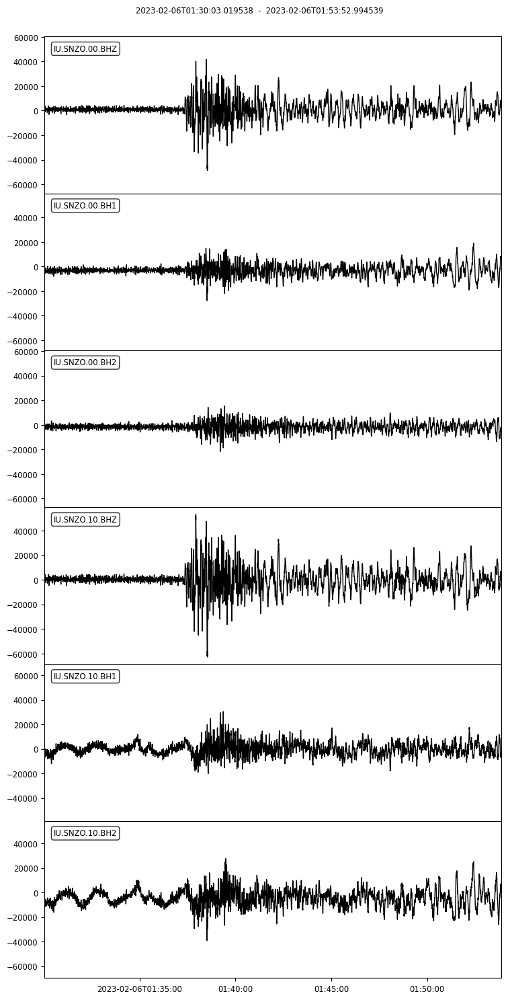

0 Trace(s) in Stream:

No waveform data found for station SSE 
 
 

6 Trace(s) in Stream:
IU.SSPA.00.BH1 | 2023-02-06T01:24:54.019538Z - 2023-02-06T01:45:07.994538Z | 40.0 Hz, 48560 samples
IU.SSPA.00.BH2 | 2023-02-06T01:24:54.019538Z - 2023-02-06T01:45:07.994538Z | 40.0 Hz, 48560 samples
IU.SSPA.00.BHZ | 2023-02-06T01:24:54.019538Z - 2023-02-06T01:45:07.994538Z | 40.0 Hz, 48560 samples
IU.SSPA.10.BH1 | 2023-02-06T01:24:54.019539Z - 2023-02-06T01:45:07.994539Z | 40.0 Hz, 48560 samples
IU.SSPA.10.BH2 | 2023-02-06T01:24:54.019539Z - 2023-02-06T01:45:07.994539Z | 40.0 Hz, 48560 samples
IU.SSPA.10.BHZ | 2023-02-06T01:24:54.019539Z - 2023-02-06T01:45:07.994539Z | 40.0 Hz, 48560 samples


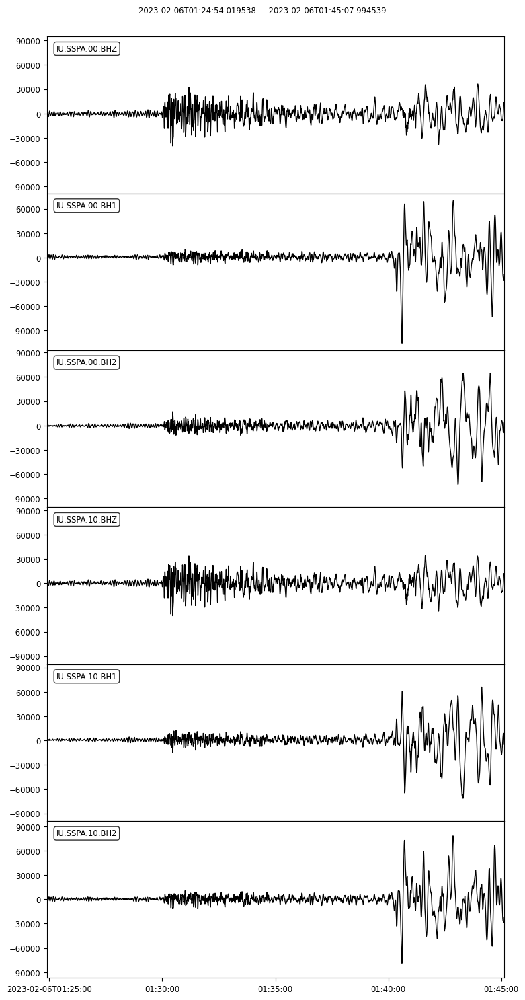

6 Trace(s) in Stream:
II.SUR.00.BH1 | 2023-02-06T01:23:53.019536Z - 2023-02-06T01:43:10.969536Z | 20.0 Hz, 23160 samples
II.SUR.00.BH2 | 2023-02-06T01:23:53.019536Z - 2023-02-06T01:43:10.969536Z | 20.0 Hz, 23160 samples
II.SUR.00.BHZ | 2023-02-06T01:23:53.019536Z - 2023-02-06T01:43:10.969536Z | 20.0 Hz, 23160 samples
II.SUR.10.BH1 | 2023-02-06T01:23:53.019538Z - 2023-02-06T01:43:10.994538Z | 40.0 Hz, 46320 samples
II.SUR.10.BH2 | 2023-02-06T01:23:53.019538Z - 2023-02-06T01:43:10.994538Z | 40.0 Hz, 46320 samples
II.SUR.10.BHZ | 2023-02-06T01:23:53.019538Z - 2023-02-06T01:43:10.994538Z | 40.0 Hz, 46320 samples


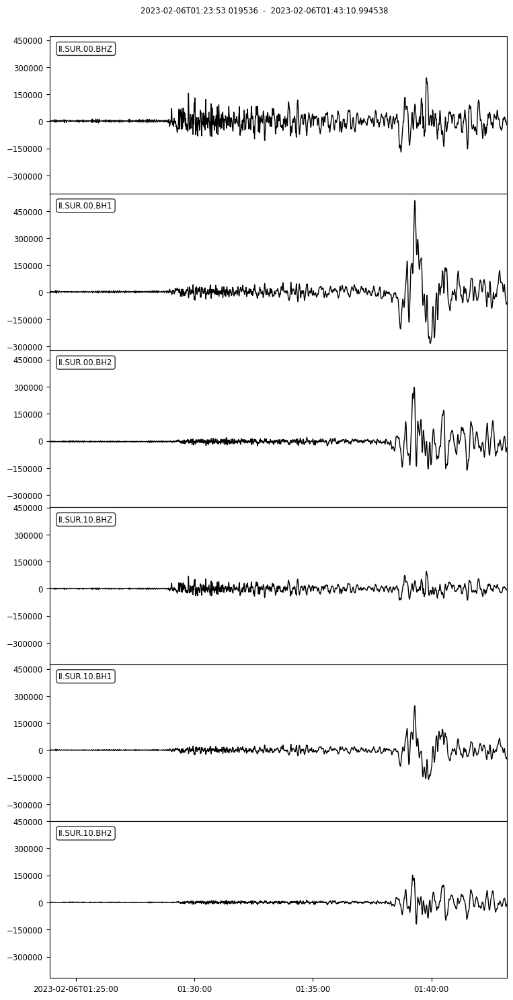

0 Trace(s) in Stream:

No waveform data found for station TARA 
 
 

6 Trace(s) in Stream:
IU.TATO.00.BH1 | 2023-02-06T01:23:52.019538Z - 2023-02-06T01:43:08.969538Z | 20.0 Hz, 23140 samples
IU.TATO.00.BH2 | 2023-02-06T01:23:52.019538Z - 2023-02-06T01:43:08.969538Z | 20.0 Hz, 23140 samples
IU.TATO.00.BHZ | 2023-02-06T01:23:52.019538Z - 2023-02-06T01:43:08.969538Z | 20.0 Hz, 23140 samples
IU.TATO.10.BH1 | 2023-02-06T01:23:52.019538Z - 2023-02-06T01:43:08.994538Z | 40.0 Hz, 46280 samples
IU.TATO.10.BH2 | 2023-02-06T01:23:52.019538Z - 2023-02-06T01:43:08.994538Z | 40.0 Hz, 46280 samples
IU.TATO.10.BHZ | 2023-02-06T01:23:52.019538Z - 2023-02-06T01:43:08.994538Z | 40.0 Hz, 46280 samples


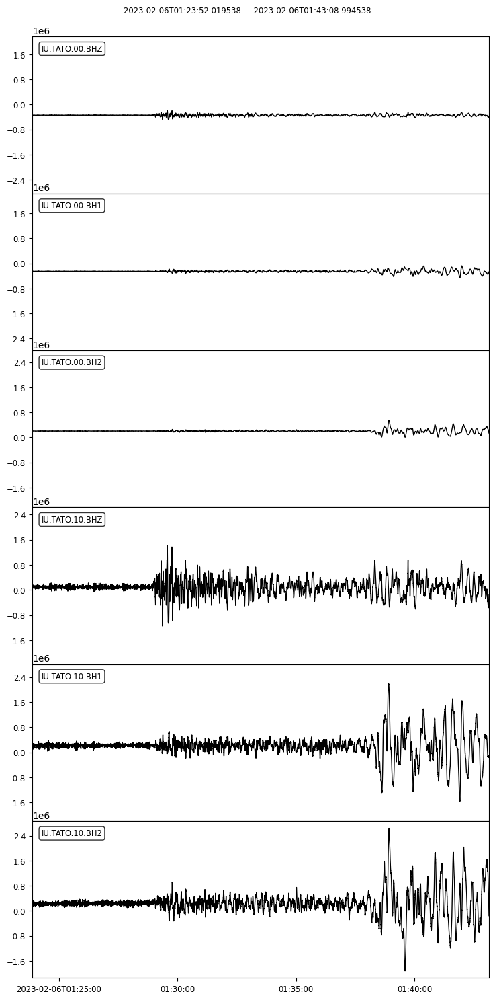

6 Trace(s) in Stream:
II.TAU.00.BH1 | 2023-02-06T01:28:22.019538Z - 2023-02-06T01:51:44.969538Z | 20.0 Hz, 28060 samples
II.TAU.00.BH2 | 2023-02-06T01:28:22.019538Z - 2023-02-06T01:51:44.969538Z | 20.0 Hz, 28060 samples
II.TAU.00.BHZ | 2023-02-06T01:28:22.019539Z - 2023-02-06T01:51:44.969539Z | 20.0 Hz, 28060 samples
II.TAU.10.BH1 | 2023-02-06T01:28:22.019538Z - 2023-02-06T01:51:44.994538Z | 40.0 Hz, 56120 samples
II.TAU.10.BH2 | 2023-02-06T01:28:22.019538Z - 2023-02-06T01:51:44.994538Z | 40.0 Hz, 56120 samples
II.TAU.10.BHZ | 2023-02-06T01:28:22.019538Z - 2023-02-06T01:51:44.994538Z | 40.0 Hz, 56120 samples


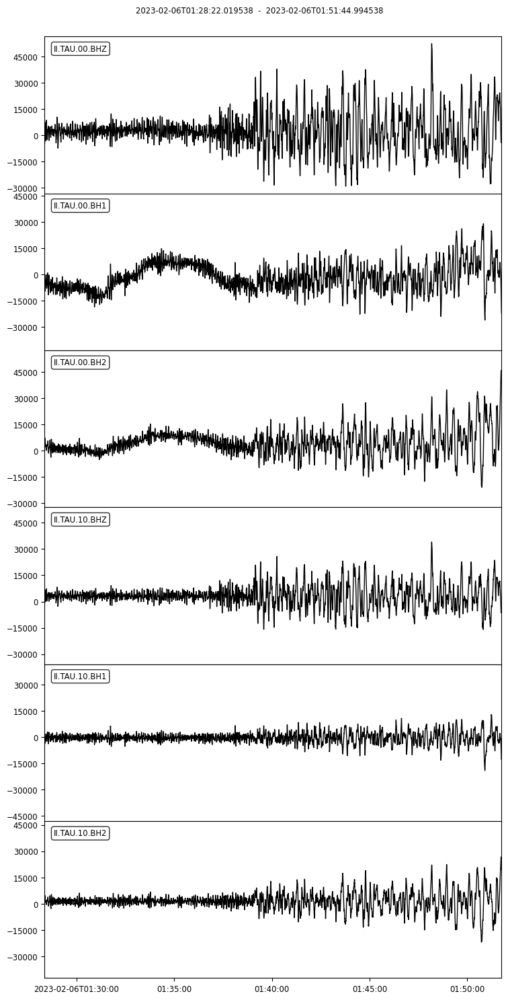

6 Trace(s) in Stream:
IU.TEIG.00.BH1 | 2023-02-06T01:26:31.019538Z - 2023-02-06T01:48:16.994538Z | 40.0 Hz, 52240 samples
IU.TEIG.00.BH2 | 2023-02-06T01:26:31.019538Z - 2023-02-06T01:48:16.994538Z | 40.0 Hz, 52240 samples
IU.TEIG.00.BHZ | 2023-02-06T01:26:31.019538Z - 2023-02-06T01:48:16.994538Z | 40.0 Hz, 52240 samples
IU.TEIG.10.BH1 | 2023-02-06T01:26:31.019538Z - 2023-02-06T01:48:16.994538Z | 40.0 Hz, 52240 samples
IU.TEIG.10.BH2 | 2023-02-06T01:26:31.019538Z - 2023-02-06T01:48:16.994538Z | 40.0 Hz, 52240 samples
IU.TEIG.10.BHZ | 2023-02-06T01:26:31.019538Z - 2023-02-06T01:48:16.994538Z | 40.0 Hz, 52240 samples


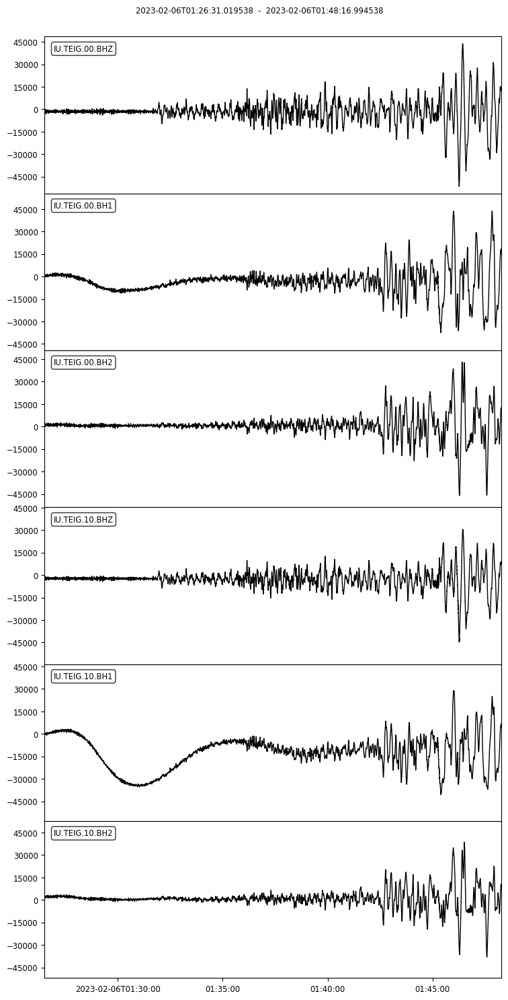

3 Trace(s) in Stream:
CU.TGUH.00.BH1 | 2023-02-06T01:26:49.000000Z - 2023-02-06T01:48:49.000000Z | 40.0 Hz, 52801 samples
CU.TGUH.00.BH2 | 2023-02-06T01:26:49.000000Z - 2023-02-06T01:48:49.000000Z | 40.0 Hz, 52801 samples
CU.TGUH.00.BHZ | 2023-02-06T01:26:49.000000Z - 2023-02-06T01:48:48.975000Z | 40.0 Hz, 52800 samples


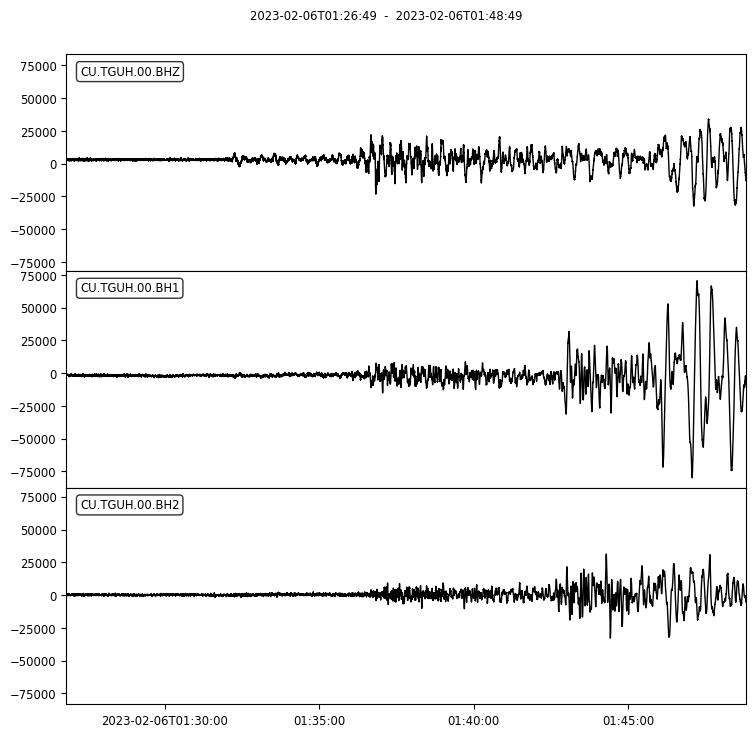

6 Trace(s) in Stream:
IU.TIXI.00.BH1 | 2023-02-06T01:22:09.019538Z - 2023-02-06T01:39:54.969538Z | 20.0 Hz, 21320 samples
IU.TIXI.00.BH2 | 2023-02-06T01:22:09.019538Z - 2023-02-06T01:39:54.969538Z | 20.0 Hz, 21320 samples
IU.TIXI.00.BHZ | 2023-02-06T01:22:09.019538Z - 2023-02-06T01:39:54.969538Z | 20.0 Hz, 21320 samples
IU.TIXI.10.BH1 | 2023-02-06T01:22:09.019538Z - 2023-02-06T01:39:54.994538Z | 40.0 Hz, 42640 samples
IU.TIXI.10.BH2 | 2023-02-06T01:22:09.019538Z - 2023-02-06T01:39:54.994538Z | 40.0 Hz, 42640 samples
IU.TIXI.10.BHZ | 2023-02-06T01:22:09.019538Z - 2023-02-06T01:39:54.994538Z | 40.0 Hz, 42640 samples


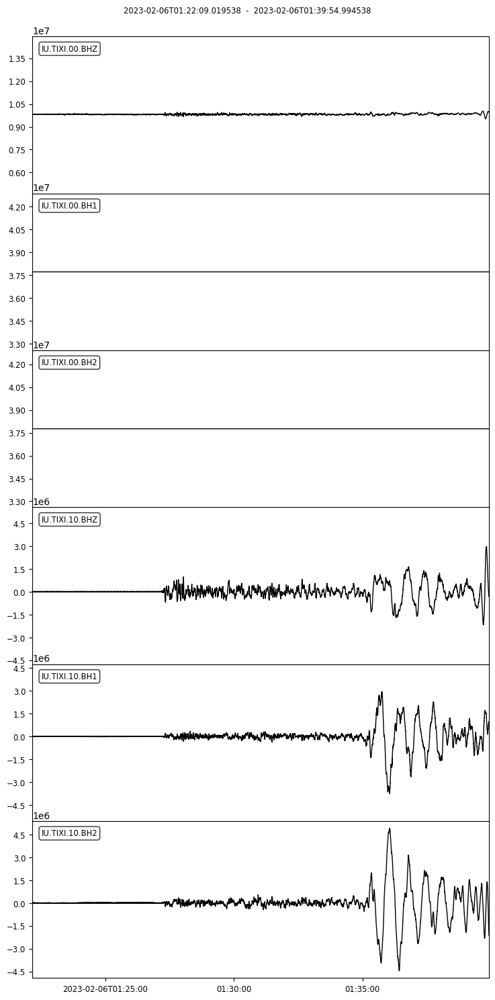

3 Trace(s) in Stream:
II.TLY.00.BH1 | 2023-02-06T01:21:12.019536Z - 2023-02-06T01:38:09.994536Z | 40.0 Hz, 40720 samples
II.TLY.00.BH2 | 2023-02-06T01:21:12.019536Z - 2023-02-06T01:38:09.994536Z | 40.0 Hz, 40720 samples
II.TLY.00.BHZ | 2023-02-06T01:21:12.019536Z - 2023-02-06T01:38:09.994536Z | 40.0 Hz, 40720 samples


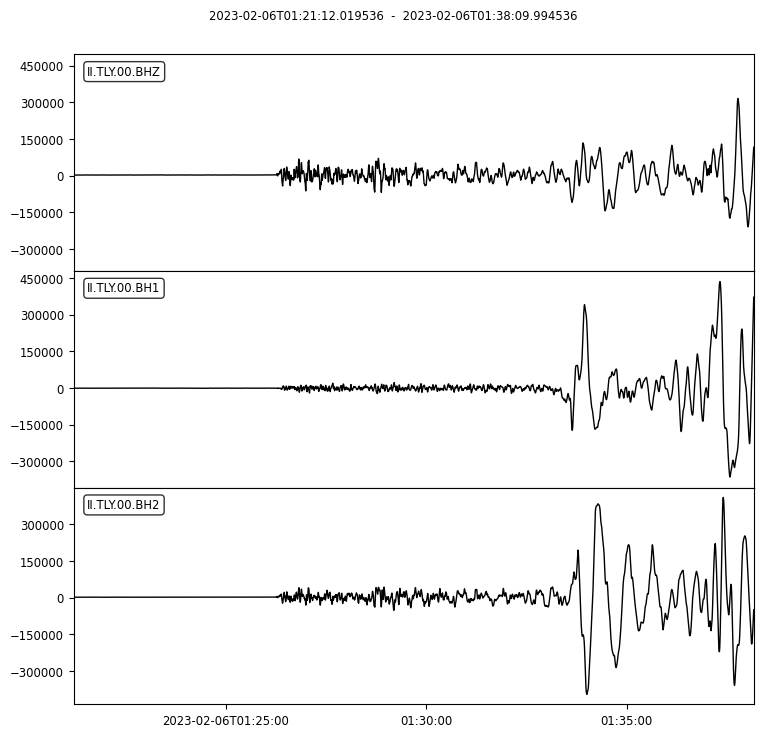

0 Trace(s) in Stream:

No waveform data found for station TRIS 
 
 

0 Trace(s) in Stream:

No waveform data found for station TRQA 
 
 

6 Trace(s) in Stream:
IU.TSUM.00.BH1 | 2023-02-06T01:22:35.019539Z - 2023-02-06T01:40:44.969539Z | 20.0 Hz, 21800 samples
IU.TSUM.00.BH2 | 2023-02-06T01:22:35.019538Z - 2023-02-06T01:40:44.969538Z | 20.0 Hz, 21800 samples
IU.TSUM.00.BHZ | 2023-02-06T01:22:35.019538Z - 2023-02-06T01:40:44.969538Z | 20.0 Hz, 21800 samples
IU.TSUM.10.BH1 | 2023-02-06T01:22:35.019538Z - 2023-02-06T01:40:44.994538Z | 40.0 Hz, 43600 samples
IU.TSUM.10.BH2 | 2023-02-06T01:22:35.019538Z - 2023-02-06T01:40:44.994538Z | 40.0 Hz, 43600 samples
IU.TSUM.10.BHZ | 2023-02-06T01:22:35.019538Z - 2023-02-06T01:40:44.994538Z | 40.0 Hz, 43600 samples


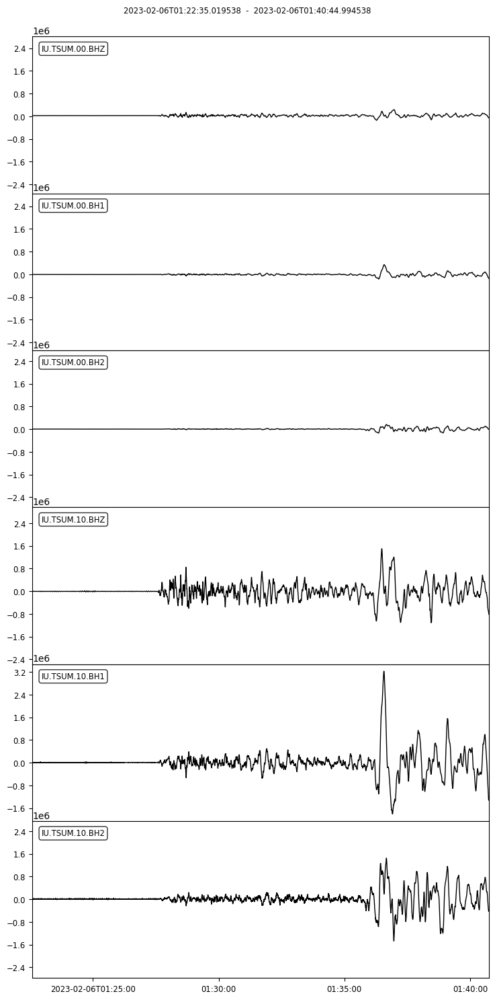

9 Trace(s) in Stream:
IU.TUC.00.BH1 | 2023-02-06T01:26:37.019538Z - 2023-02-06T01:48:28.994538Z | 40.0 Hz, 52480 samples
IU.TUC.00.BH2 | 2023-02-06T01:26:37.019538Z - 2023-02-06T01:48:28.994538Z | 40.0 Hz, 52480 samples
IU.TUC.00.BHZ | 2023-02-06T01:26:37.019538Z - 2023-02-06T01:48:28.994538Z | 40.0 Hz, 52480 samples
IU.TUC.10.BH1 | 2023-02-06T01:26:37.019538Z - 2023-02-06T01:48:28.994538Z | 40.0 Hz, 52480 samples
IU.TUC.10.BH2 | 2023-02-06T01:26:37.019538Z - 2023-02-06T01:48:28.994538Z | 40.0 Hz, 52480 samples
IU.TUC.10.BHZ | 2023-02-06T01:26:37.019538Z - 2023-02-06T01:48:28.994538Z | 40.0 Hz, 52480 samples
IU.TUC.60.BH1 | 2023-02-06T01:26:37.019538Z - 2023-02-06T01:48:28.969538Z | 20.0 Hz, 26240 samples
IU.TUC.60.BH2 | 2023-02-06T01:26:37.019538Z - 2023-02-06T01:48:28.969538Z | 20.0 Hz, 26240 samples
IU.TUC.60.BHZ | 2023-02-06T01:26:37.019538Z - 2023-02-06T01:48:28.969538Z | 20.0 Hz, 26240 samples


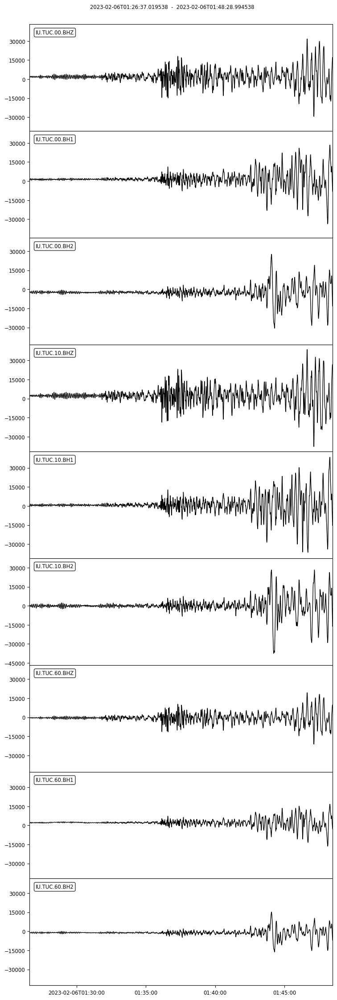

3 Trace(s) in Stream:
IM.TX31..BHE | 2023-02-06T01:26:36.000000Z - 2023-02-06T01:48:26.000000Z | 40.0 Hz, 52401 samples
IM.TX31..BHN | 2023-02-06T01:26:36.000000Z - 2023-02-06T01:48:26.000000Z | 40.0 Hz, 52401 samples
IM.TX31..BHZ | 2023-02-06T01:26:36.000000Z - 2023-02-06T01:48:26.000000Z | 40.0 Hz, 52401 samples


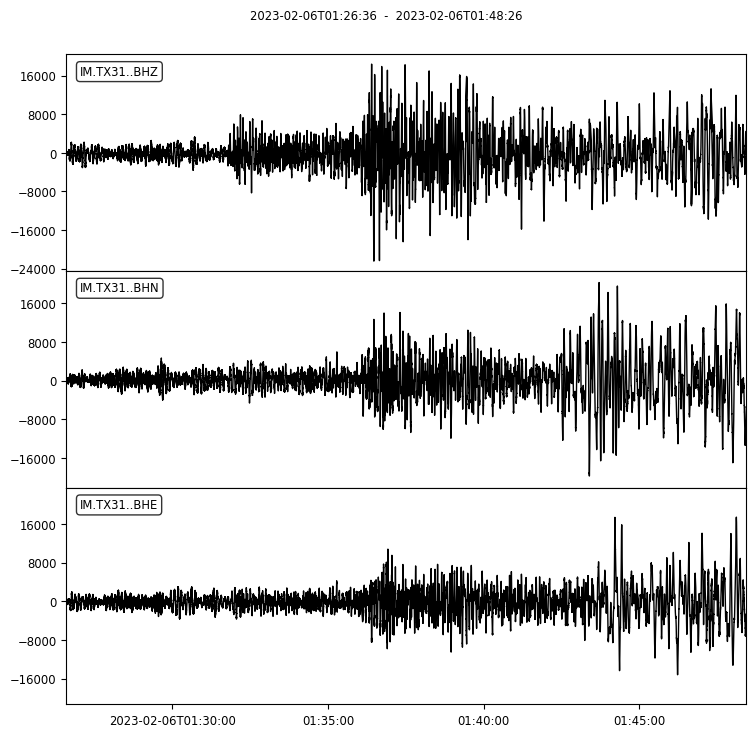

0 Trace(s) in Stream:

No waveform data found for station TX32 
 
 

6 Trace(s) in Stream:
IU.ULN.00.BH1 | 2023-02-06T01:21:34.019538Z - 2023-02-06T01:38:50.969538Z | 20.0 Hz, 20740 samples
IU.ULN.00.BH2 | 2023-02-06T01:21:34.019538Z - 2023-02-06T01:38:50.969538Z | 20.0 Hz, 20740 samples
IU.ULN.00.BHZ | 2023-02-06T01:21:34.019538Z - 2023-02-06T01:38:50.969538Z | 20.0 Hz, 20740 samples
IU.ULN.10.BH1 | 2023-02-06T01:21:34.019538Z - 2023-02-06T01:38:50.994538Z | 40.0 Hz, 41480 samples
IU.ULN.10.BH2 | 2023-02-06T01:21:34.019538Z - 2023-02-06T01:38:50.994538Z | 40.0 Hz, 41480 samples
IU.ULN.10.BHZ | 2023-02-06T01:21:34.019538Z - 2023-02-06T01:38:50.994538Z | 40.0 Hz, 41480 samples


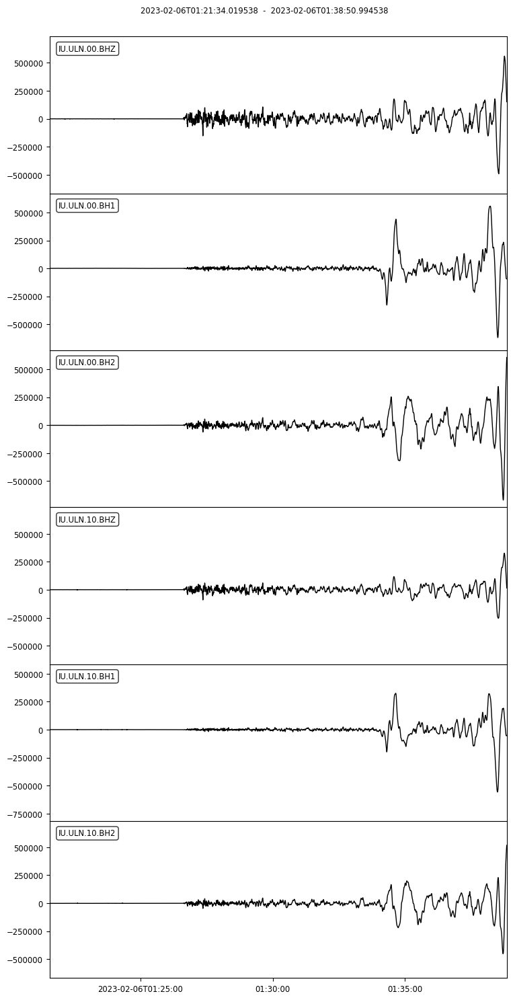

6 Trace(s) in Stream:
II.UOSS.00.BH1 | 2023-02-06T01:17:11.019539Z - 2023-02-06T01:31:00.994539Z | 40.0 Hz, 33200 samples
II.UOSS.00.BH2 | 2023-02-06T01:17:11.019539Z - 2023-02-06T01:31:00.994539Z | 40.0 Hz, 33200 samples
II.UOSS.00.BHZ | 2023-02-06T01:17:11.019539Z - 2023-02-06T01:31:00.994539Z | 40.0 Hz, 33200 samples
II.UOSS.10.BH1 | 2023-02-06T01:17:11.019538Z - 2023-02-06T01:31:00.994538Z | 40.0 Hz, 33200 samples
II.UOSS.10.BH2 | 2023-02-06T01:17:11.019538Z - 2023-02-06T01:31:00.994538Z | 40.0 Hz, 33200 samples
II.UOSS.10.BHZ | 2023-02-06T01:17:11.019538Z - 2023-02-06T01:31:00.994538Z | 40.0 Hz, 33200 samples


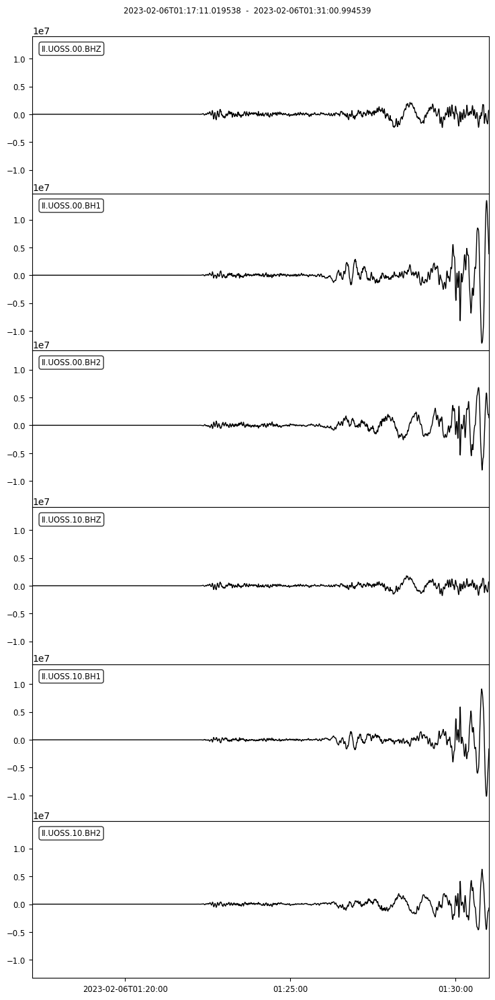

3 Trace(s) in Stream:
GT.VNDA.00.BHE | 2023-02-06T01:28:47.000000Z - 2023-02-06T01:52:32.000000Z | 40.0 Hz, 57001 samples
GT.VNDA.00.BHN | 2023-02-06T01:28:47.000000Z - 2023-02-06T01:52:32.000000Z | 40.0 Hz, 57001 samples
GT.VNDA.00.BHZ | 2023-02-06T01:28:47.000000Z - 2023-02-06T01:52:32.000000Z | 40.0 Hz, 57001 samples


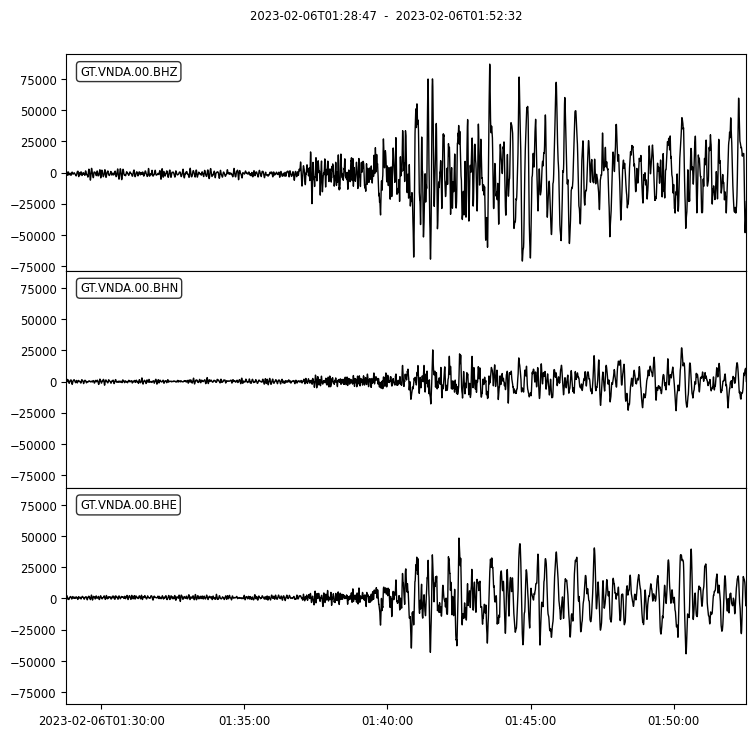

0 Trace(s) in Stream:

No waveform data found for station WAKE 
 
 

6 Trace(s) in Stream:
IU.WCI.00.BH1 | 2023-02-06T01:25:25.019538Z - 2023-02-06T01:46:09.994538Z | 40.0 Hz, 49800 samples
IU.WCI.00.BH2 | 2023-02-06T01:25:25.019538Z - 2023-02-06T01:46:09.994538Z | 40.0 Hz, 49800 samples
IU.WCI.00.BHZ | 2023-02-06T01:25:25.019538Z - 2023-02-06T01:46:09.994538Z | 40.0 Hz, 49800 samples
IU.WCI.10.BH1 | 2023-02-06T01:25:25.019538Z - 2023-02-06T01:46:09.994538Z | 40.0 Hz, 49800 samples
IU.WCI.10.BH2 | 2023-02-06T01:25:25.019538Z - 2023-02-06T01:46:09.994538Z | 40.0 Hz, 49800 samples
IU.WCI.10.BHZ | 2023-02-06T01:25:25.019538Z - 2023-02-06T01:46:09.994538Z | 40.0 Hz, 49800 samples


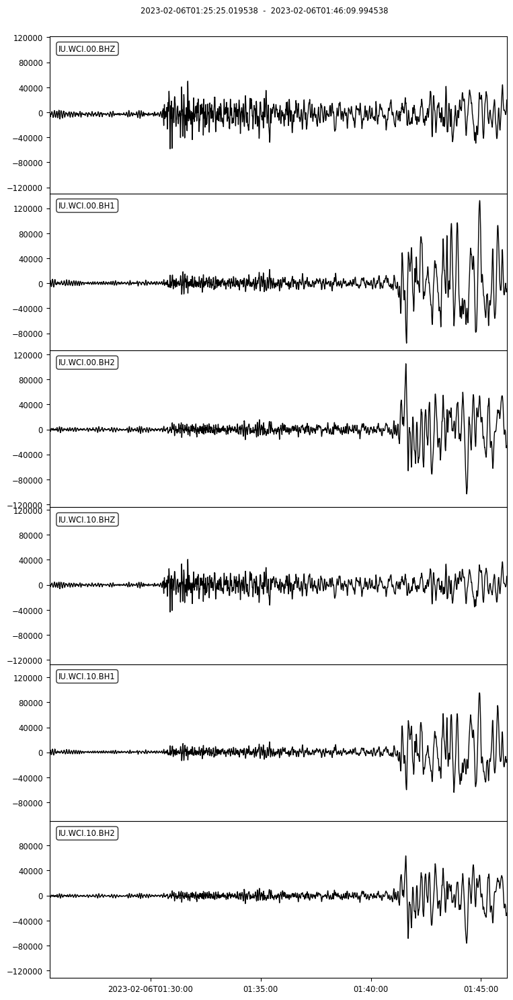

0 Trace(s) in Stream:

No waveform data found for station WMQ 
 
 

6 Trace(s) in Stream:
II.WRAB.00.BH1 | 2023-02-06T01:26:52.019536Z - 2023-02-06T01:48:55.994536Z | 40.0 Hz, 52960 samples
II.WRAB.00.BH2 | 2023-02-06T01:26:52.019536Z - 2023-02-06T01:48:55.994536Z | 40.0 Hz, 52960 samples
II.WRAB.00.BHZ | 2023-02-06T01:26:52.019536Z - 2023-02-06T01:48:55.994536Z | 40.0 Hz, 52960 samples
II.WRAB.10.BH1 | 2023-02-06T01:26:52.019538Z - 2023-02-06T01:48:55.994538Z | 40.0 Hz, 52960 samples
II.WRAB.10.BH2 | 2023-02-06T01:26:52.019538Z - 2023-02-06T01:48:55.994538Z | 40.0 Hz, 52960 samples
II.WRAB.10.BHZ | 2023-02-06T01:26:52.019538Z - 2023-02-06T01:48:55.994538Z | 40.0 Hz, 52960 samples


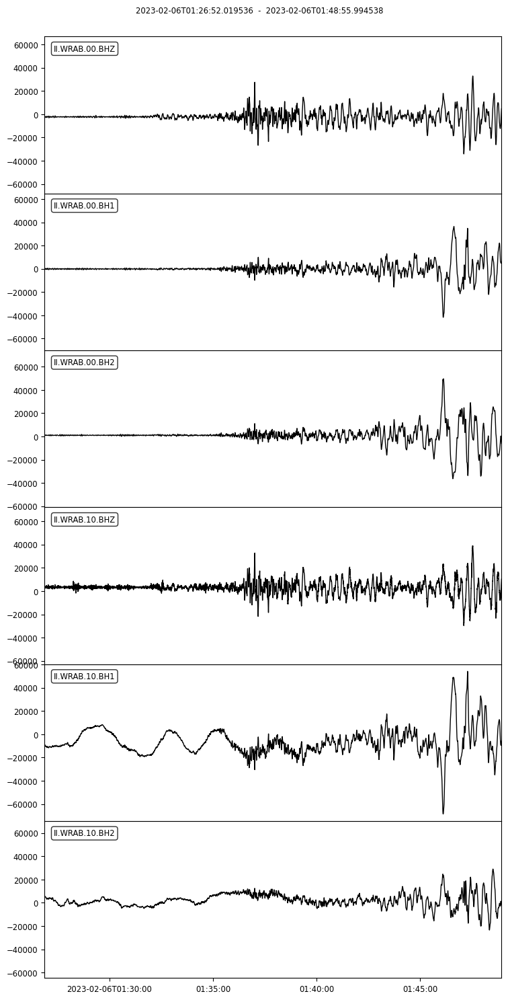

6 Trace(s) in Stream:
IU.WVT.00.BH1 | 2023-02-06T01:25:36.019536Z - 2023-02-06T01:46:31.994536Z | 40.0 Hz, 50240 samples
IU.WVT.00.BH2 | 2023-02-06T01:25:36.019536Z - 2023-02-06T01:46:31.994536Z | 40.0 Hz, 50240 samples
IU.WVT.00.BHZ | 2023-02-06T01:25:36.019536Z - 2023-02-06T01:46:31.994536Z | 40.0 Hz, 50240 samples
IU.WVT.10.BH1 | 2023-02-06T01:25:36.019538Z - 2023-02-06T01:46:31.994538Z | 40.0 Hz, 50240 samples
IU.WVT.10.BH2 | 2023-02-06T01:25:36.019538Z - 2023-02-06T01:46:31.994538Z | 40.0 Hz, 50240 samples
IU.WVT.10.BHZ | 2023-02-06T01:25:36.019538Z - 2023-02-06T01:46:31.994538Z | 40.0 Hz, 50240 samples


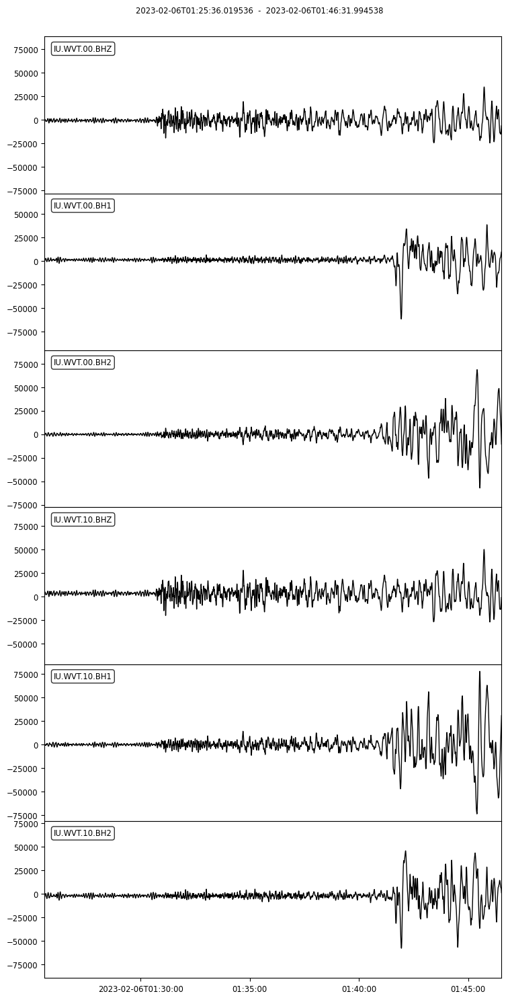

0 Trace(s) in Stream:

No waveform data found for station XAN 
 
 

0 Trace(s) in Stream:

No waveform data found for station XMAS 
 
 

6 Trace(s) in Stream:
IU.YAK.00.BH1 | 2023-02-06T01:22:32.019538Z - 2023-02-06T01:40:38.969538Z | 20.0 Hz, 21740 samples
IU.YAK.00.BH2 | 2023-02-06T01:22:32.019538Z - 2023-02-06T01:40:38.969538Z | 20.0 Hz, 21740 samples
IU.YAK.00.BHZ | 2023-02-06T01:22:32.019538Z - 2023-02-06T01:40:38.969538Z | 20.0 Hz, 21740 samples
IU.YAK.10.BH1 | 2023-02-06T01:22:32.019536Z - 2023-02-06T01:40:38.994536Z | 40.0 Hz, 43480 samples
IU.YAK.10.BH2 | 2023-02-06T01:22:32.019536Z - 2023-02-06T01:40:38.994536Z | 40.0 Hz, 43480 samples
IU.YAK.10.BHZ | 2023-02-06T01:22:32.019536Z - 2023-02-06T01:40:38.994536Z | 40.0 Hz, 43480 samples


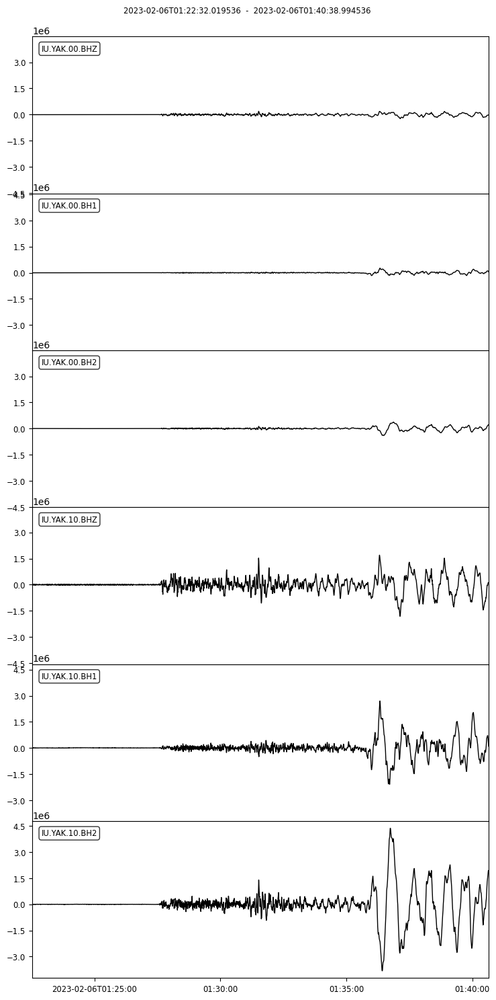

6 Trace(s) in Stream:
IU.YSS.00.BH1 | 2023-02-06T01:24:03.000001Z - 2023-02-06T01:43:29.000001Z | 20.0 Hz, 23321 samples
IU.YSS.00.BH2 | 2023-02-06T01:24:03.000001Z - 2023-02-06T01:43:29.000001Z | 20.0 Hz, 23321 samples
IU.YSS.00.BHZ | 2023-02-06T01:24:03.000001Z - 2023-02-06T01:43:29.000001Z | 20.0 Hz, 23321 samples
IU.YSS.10.BH1 | 2023-02-06T01:24:03.019538Z - 2023-02-06T01:43:28.994538Z | 40.0 Hz, 46640 samples
IU.YSS.10.BH2 | 2023-02-06T01:24:03.019538Z - 2023-02-06T01:43:28.994538Z | 40.0 Hz, 46640 samples
IU.YSS.10.BHZ | 2023-02-06T01:24:03.019538Z - 2023-02-06T01:43:28.994538Z | 40.0 Hz, 46640 samples


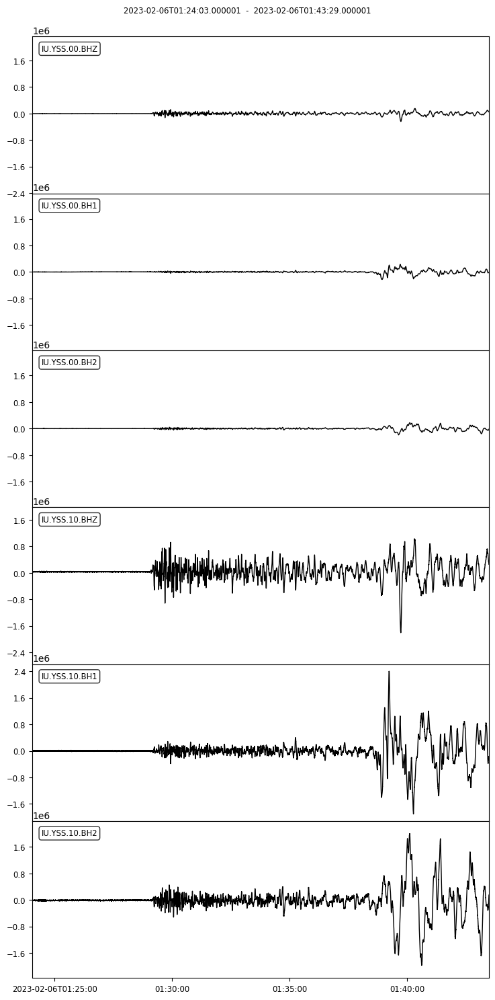

In [6]:
#selecting and ploting the wave form for each of the stations
for i in stations_df["Station"]:
    ind_stations = waveform_dt.select(station=i)
    if len(ind_stations) == 0:
        print(ind_stations)
        print(f"No waveform data found for station {i} \n \n \n")
    else:
        print(ind_stations)
        ind_stations.plot()

<a id="takeoff"></a>
### Take-off Angle, Trend and Plunge

In [7]:
# Calculating the take-off angle
take_off = []                      # Variable to hold the calculated values

for _ in stations_df["Azimuth"]:   # for loop to retrieve each of the azimuth
    
    v=math.cos(math.radians(_))    # computes the cos of the azimuth
    
    p = np.rad2deg((np.arcsin(v))) #computes the arcsin of the cos of the azimuth
    
    take_off.append(p)             # Appends the computed values to the list of takeoff values

In [8]:
# Prints the computed takeoff angles
for _ in take_off:
    print(_)

22.584547183950907
-78.483846698845
69.92121622575439
34.643732348576
80.88477166795435
60.28134915223992
39.939619525650095
19.309642401951002
60.1399943248618
-32.01617322869
14.41003422822951
32.6589008037986
24.2457710093582
37.167711559542006
71.888983028997
29.456693990702604
58.157849036753
45.1991303255581
-13.455358057175001
-64.202939650993
51.8072307848792
-0.8720678546050036
71.9862678975636
20.847734729453702
-28.849912864911996
87.88122425643297
76.0409517189508
-5.5626922729440995
4.776396859746395
-45.817011058813
39.06333920486429
-43.75642272041697
16.511891453955002
42.669307826644
46.84480373203541
67.4783525901373
30.30870754872501
-86.549131225197
28.254394665693805
42.1512623264709
14.866593926777206
27.862520749941897
29.146641864087798
21.652659508686106
40.530952657678604
11.106196850913191
49.9017658287565
13.172999155457408
-53.144980608782994
44.224056440200606
88.29809507346187
31.229718615844813
60.2022328553516
28.725029854288596
-8.395909239716397
3.797

In [9]:
# Calculating the plunge using the computed take-off angles
plunge =  []                  # Variable to hold the calculated values

for _ in take_off:            # for loop to retrieve each of the take-off
    
    d = 90 - _
    
    if d > 90:             # If condition checks for validity
        f = 180-d
        plunge.append(f)     # Appends the computed values
    else:    
        plunge.append(d)   # Appends the computed values

In [10]:
# prints the computed plunge values
for _ in plunge:
    print(_)

67.4154528160491
11.516153301154986
20.078783774245608
55.356267651424
9.115228332045646
29.71865084776008
50.060380474349905
70.69035759804899
29.860005675138197
57.98382677130999
75.5899657717705
57.3410991962014
65.75422899064179
52.832288440457994
18.111016971002996
60.543306009297396
31.842150963247
44.8008696744419
76.544641942825
25.797060349006983
38.1927692151208
89.127932145395
18.013732102436407
69.1522652705463
61.150087135088
2.118775743567028
13.959048281049206
84.4373077270559
85.2236031402536
44.182988941187006
50.93666079513571
46.243577279583036
73.488108546045
47.330692173356
43.15519626796459
22.521647409862695
59.69129245127499
3.4508687748029843
61.74560533430619
47.8487376735291
75.1334060732228
62.13747925005811
60.8533581359122
68.3473404913139
49.469047342321396
78.8938031490868
40.0982341712435
76.8270008445426
36.85501939121701
45.775943559799394
1.701904926538134
58.77028138415518
29.797767144648397
61.27497014571141
81.6040907602836
86.2028285511258
6.8739

In [12]:
# calculating the trend using the azimuth
trend = []               # Variable to hold calculated trends

for _ in stations_df["Azimuth"]:  # for loop to retrieve each of the azimuth
    g = _ + 180
    
    if g > 360:          # Validity condition
        k = g - 360
        trend.append(k)
    else:
        trend.append(g)

In [13]:
# prints the computed trends
for _ in trend:
    print(_)

247.41545281604908
348.483846698845
200.0787837742456
235.356267651424
170.88477166795434
150.2813491522399
129.9396195256501
109.309642401951
209.8600056751382
57.98382677131001
104.4100342282295
122.6589008037986
114.2457710093582
127.167711559542
198.111016971003
240.5433060092974
148.157849036753
224.8008696744419
283.455358057175
334.202939650993
141.8072307848792
270.872067854605
161.9862678975636
110.8477347294537
298.84991286491197
182.11877574356703
166.0409517189508
275.5626922729441
265.2236031402536
315.817011058813
129.0633392048643
46.24357727958301
253.488108546045
227.330692173356
136.84480373203542
157.4783525901373
239.691292451275
356.549131225197
241.7456053343062
132.15126232647089
104.8665939267772
117.8625207499419
119.1466418640878
248.3473404913139
229.4690473423214
258.8938031490868
139.9017658287565
256.82700084454257
36.85501939121701
134.2240564402006
181.70190492653825
238.7702813841552
209.7977671446484
118.72502985428861
278.3959092397164
266.20282855112

<a id="map"></a>
### Geographic Map and Polarity

In [18]:
# saving the longitude and latitude values of the earthquake
mean_lat = 37.2251
mean_long = 37.0209


# Generating the world map
m = folium.Map(location=[mean_lat,mean_long], zoom_start = 3)

for i in range(0,149):
    if stations_df["Nature of First Arrival"][i] == "C":
        folium.Marker(location=[stations_df["Latitude"][i],stations_df["Longitude"][i]], icon = folium.Icon(color='red'),popup=stations_df["Station"][i]).add_to(m)
    elif stations_df["Nature of First Arrival"][i] == "D":
        folium.Marker(location=[stations_df["Latitude"][i],stations_df["Longitude"][i]], icon = folium.Icon(color='blue'),popup=stations_df["Station"][i]).add_to(m)
    else:
        #pass
        folium.Marker(location=[stations_df["Latitude"][i],stations_df["Longitude"][i]], popup=stations_df["Station"][i], icon = folium.Icon(color='black')).add_to(m)

folium.Marker(location=[mean_lat, mean_long], icon = folium.Icon(color='green'), popup="Earthquake").add_to(m)

m

<a id="stereonet"></a>
### Stereographic Projection

In [19]:
def stereonet(plunge,trend,Nil=False,planes=False,strike1=0,dip1=0,strike2=0,dip2=0):
    
    # Function to plot the stereographic projection
        
    fig=plt.figure()
    ax = fig.add_subplot(111, projection='equal_area_stereonet')

    c,j,k = 0,0,0                 # Variable counts the number of compression, dilatation and Nils (No apparent polarity)
    logical_counter = 0
    
    while logical_counter <= 148: # While loop to plot each station
        
        if Nil == True:            # If condition to include or eliminate Nil stations

            if stations_df["Nature of First Arrival"][logical_counter] == "C":       # Plots compression
                ax.line(plunge[logical_counter], trend[logical_counter],'*',color='r',markersize=10)
                logical_counter +=1
                c += 1
            elif stations_df["Nature of First Arrival"][logical_counter] == "D":     # Plots dilatation
                ax.line(plunge[logical_counter], trend[logical_counter],'o',color='b',markersize=10)
                logical_counter +=1
                j += 1
            else:                                                                    # Plot Nil points
                ax.line(plunge[logical_counter], trend[logical_counter],'o',color='k',markersize=10)
                logical_counter +=1
                k += 1
                
        else:
            
            if stations_df["Nature of First Arrival"][logical_counter] == "C":       # Plots compression
                ax.line(plunge[logical_counter], trend[logical_counter],'*',color='r',markersize=10)
                logical_counter +=1
                c += 1
            elif stations_df["Nature of First Arrival"][logical_counter] == "D":     # Plots dilatation
                ax.line(plunge[logical_counter], trend[logical_counter],'o',color='b',markersize=10)
                logical_counter +=1
                j += 1
            else:                                                                    # Ignores the Nil points
                logical_counter +=1
                k += 1

    if planes == False:          # If condition to include or eliminate the plane
        pass
    else:
        ax.plane(strike1, dip1, 'k', linewidth=2)
        ax.plane(strike2, dip2, 'k', linewidth=2)
        
    
    ax.grid()
    plt.show()
    print(f"There were a total of {c} compressions,{j} dilatations and {k} stations with no apparent polarity")

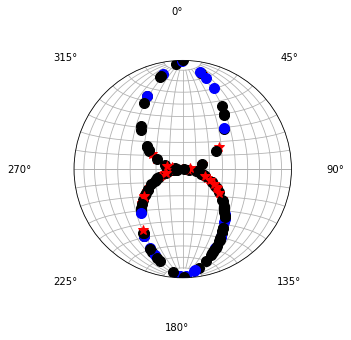

There were a total of 39 compressions,22 dilatations and 88 stations with no apparent polarity


In [20]:
# Plotting the polarity on the stereonet
stereonet(plunge,trend,Nil=True)

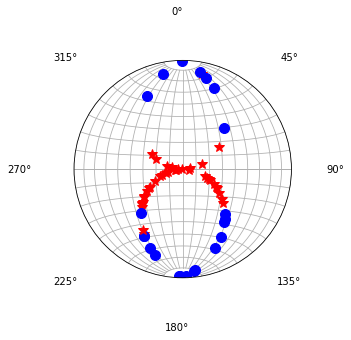

There were a total of 39 compressions,22 dilatations and 88 stations with no apparent polarity


In [21]:
# Plotting the polarity on the stereonet with Nil points excluded
stereonet(plunge,trend,Nil=False)

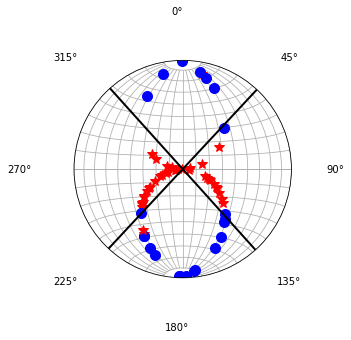

There were a total of 39 compressions,22 dilatations and 88 stations with no apparent polarity


In [22]:
# Plotting the polarity with the deduced strike and dips for the nodal planes
stereonet(plunge,trend,Nil=False,planes=True,strike1=43,dip1=90,strike2=318,dip2=90)

<a id="beachball"></a>
### Beachball

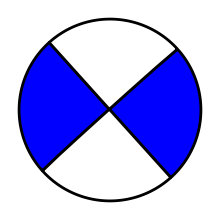

In [23]:
# Plots the beachball based on the deduced strike and dip from above
from obspy.imaging.beachball import beachball
np1 = [318, 90, -179]
fig = beachball(np1) 

<a id="discussion"></a>
### Discussion

- Based on the regional geology of the study area (Yilmaz, 1993; Barka and Reilinger, 1997; Dewey, et at., 1986; McCluskey, et al., 2000; Duman, et al., 2018; Emre, et al., 2018), the nodal plane at 43֯/223֯ degree was established to be the fault plane of the fault responsible for the Kahramanmaras earthquake. 
- The strike and dip angles were measured from the stereographic projection above and established to be 43֯ and 90֯, respectively. This information was used to plot the beachball shown in above, where the blue colored quadrants correspond to the compression and white corresponds to the dilatation.
- Compared to the strike and dip values of 48֯ and 89֯, respectively, established by the United States Geological Survey (USGS) (2023). The strike and dip values established by this research varied negligibly. 
- However, the beachballs plotted by USGS (2023) and obtained from this research are identical. This, therefore, indicated that the findings of this study correspond to that of USGS (2023). 
- From the beachball plot obtained, it can be deduced that the fault responsible for the Kahramanmaras Earthquake is a strike-slip fault oriented in a Northeast-Southwest direction. 
- This finding also corresponds with what has been previously established in literature by Dewey, et at. (1986), Duman, et al. (2018), and Emre, et al. (2018), which established that lateral conjugate strike-slip fault is characteristic of the East Anatolian faulting system. Previous literature indicates that this faulting system has been associated with several earthquakes over the years (Ayhan, et al., 1981; Tan, Tapirdamaz, and Yörük, 2008; Duman, et al., 2018). 


<a id="conclusion"></a>
### Conclusion

- The research provided a detailed analysis of the source mechanism responsible for the Kahramanmaras Earthquake. 
- It established that the earthquake source mechanism is a lateral strike-slip fault with a Northeast-Southwest trend. The fault responsible is a part of the East Anatolian fault system.
- However, this study had its limitations. The nature of the nodal planes established by this study and the beachball obtained directly depended on accurately identifying the polarity of the P-wave first arrivals. Noting a large number of no apparent polarity, compared to compression and dilatation combined, established by this research, specific errors may have been incurred in this process. This error may have resulted from a low signal-noise ratio in the recorded data. This is a common limitation associated with P-wave first arrivals, as has been criticized by Kilb and Hardebeck (2006). Nonetheless, the arrival of corresponding results with USGS (2023) suggests that these errors were minimal. Furthermore, the focal mechanism approach, even with the misfit criterion informed by knowledge about the regional geology of the area, inherently imposes limitations on the orientation of compatible principal stresses (Townend, Abercrombie, and McGarr, 2006).


<a id="references"></a>
### References

- Ayhan, E., Alsan, E., Sancaklı, N. and Üçer, S.B., (1981). Turkey and surrounding earthquake catalogue 1881–1980. Istanbul: Bogaziçi University Publications.
- Barka, A. and Reilinger, R., (1997). Active tectonics of the Eastern Mediterranean region: deduced from GPS, neotectonic and seismicity data.
- Cronin, V., (2010). A primer on focal mechanism solutions for geologists. Science Education Resource Center, Carleton College, p.14. 
- Dewey, J.F., Hempton, M.R., Kidd, W.S.F., Saroglu, F.A.M.C. and Şengör, A.M.C., (1986). Shortening of continental lithosphere: the neotectonics of Eastern Anatolia—a young collision zone. Geological Society, London, Special Publications, 19(1), pp.1-36.
- Duman, T.Y., Çan, T., Emre, Ö., Kadirioğlu, F.T., Başarır Baştürk, N., Kılıç, T., Arslan, S., Özalp, S., Kartal, R.F., Kalafat, D. and Karakaya, F., (2018). Seismotectonic database of Turkey. Bulletin of Earthquake Engineering, 16, pp.3277-3316.
- Incorporated Research Institutions for Seismology (IRIS), (2023). [Online] Available at: https://earthquake.usgs.gov/earthquakes/eventpage/us6000jllz/waveforms (Accessed: 25th March 2023)
- Kilb, D. and Hardebeck, J.L., (2006). Fault parameter constraints using relocated earthquakes: A validation of first-motion focal-mechanism data. Bulletin of the Seismological Society of America, 96(3), pp.1140-1158. 
- Tan, O., Tapirdamaz, M.C. and Yörük, A., (2008). The earthquake catalogues for Turkey. Turkish Journal of Earth Sciences, 17(2), pp.405-418.
- Townend, J., Abercrombie, R. and McGarr, A., (2006). What do faults feel? Observational constraints on the stresses acting on seismogenic faults. Geophysical Monograph-American Geophysical Union, 170, p.313.
- United States Geological Survey (USGS), (2023). [Online] Available at: https://earthquake.usgs.gov/earthquakes/eventpage/us6000jllz/moment-tensor (Accessed: 5th April 2023)
- Yilmaz, Y., (1993). New evidence and model on the evolution of the southeast Anatolian orogen. Geological Society of America Bulletin, 105(2), pp.251-271.